In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import scipy.io
import os

In [2]:
v_th=0.6
SC_base_dir= '/gerda/mcintosh_lab/jgriffiths/hcp_wuminn_l2k8_tracks_conmats/data/results/hcp_wuminn/tractography/dipy/l2k8/'
TS_base_dir='/gerda/mcintosh_lab/jgriffiths/hcp_wuminn_l2k8_rsfmri_ts/data/results/'
out_dir =  '/brunhild/mcintosh_lab/jwang/ModelFitting/Deco/' #'/brunhild/mcintosh_lab/jwang/ModelFitting/Linear_gains/'
import pandas as pd
#groups =[grp for grp in os.listdir(base_dir)]
TS_df=pd.read_pickle('/scratch/mcintosh_lab/jgriffiths/hcp_wuminn_l2k8_rsfmri_ts_LATEST/data/results/100307_rfMRI_REST1_LR_hpc200_clean__l2k8_sc33_ts.pkl')

In [3]:
TS=TS_df.values

In [4]:
def sigmoid(x):
    return 1.0/(1+np.exp(-x))
def smooth_normalize(x):
        x[x< 0.000001] =0.000001
    
        return x
def f_diffusion_tr_noise(X, Wo, Theta):
    
    def smooth_normalize_ct(x, center):
        return center+ (center-0.001)*np.tanh((x-center)/(center - 0.001))
    def smooth_normalize(x):
        x[x< 0.000001] =0.000001
    
        return x

   
    #G = 5000.0/0.4590/0.641  + 4000.*np.tanh(Theta[4:5])
    G=  0.001 + smooth_normalize(Theta[1:2])
    
    gEI= 1.2#+ smooth_normalize(Theta[0:1])
    W1=  0.001+smooth_normalize(Theta[0:1])#.0126 + 0.0125*np.tanh(Theta[0:1])
    #W2= .0126 + 0.0125*np.tanh(Theta[0:1])
    #gEE= 0.15* (1+np.tanh(Theta[2:3])/5.0)
    gEE= 15.17#+ smooth_normalize(Theta[2:3])
    gIE= 15.21 #+smooth_normalize(Theta[3:4])
    #Tr= 1.
    #step_size = 0.05
    num_para = 0
    dt = step_size
    state_size = np.int(Tr/step_size)
    N=1
    #ROI_size=96
    #Jnmda = 0.15
    #W=(Gi*W0)/np.linalg.norm(Gi*W0)
    L_s = -np.diag(np.sum(Wo, axis= 1)) + Wo
    I0 = 0.3772/1.
    gamma = 0.641
    gammaI = 1.0
    #Wplus = .8
    Ie = 0
     #smooth_normalize_ct(_Ji[:,0],1.0)
    aE = 310
    bE = 125
    dE_0 = 0.16
    WE = 1.0 #18.4576#1.0
    
    aI = 615
    bI = 177
    dI_0 = 0.087
    WI = 0.7
    
    tauE = 100.
    tauI = 10.
    
    
    #W1= 0.05
    
    #G = .1
    
    E = X[num_para:num_para+N*ROI_size]#smooth_normalize_ct(X[num_para:num_para+N*ROI_size], 0.5)
    I = X[num_para+N*ROI_size:num_para+2*N*ROI_size]#smooth_normalize_ct(X[num_para+N*ROI_size:num_para+2*N*ROI_size], .5)
    q = X[-N*ROI_size:] #smooth_normalize_ct(X[-N*ROI_size:],1.0)
    v = X[-2*N*ROI_size:-N*ROI_size]#smooth_normalize_ct(X[-2*N*ROI_size:-N*ROI_size],1.)
    f = X[-3*N*ROI_size:-2*N*ROI_size]#smooth_normalize_ct(X[-3*N*ROI_size:-2*N*ROI_size], 1.)
    x = X[-4*N*ROI_size:-3*N*ROI_size]#np.tanh(X[-4*N*ROI_size:-3*N*ROI_size])#smooth_normalize(X[-4*N*ROI_size:-3*N*ROI_size], .5)
    #print(E.shape)
    #subID='AD_016_S_4902.mat'
    
    
    rho=0.34;
    tau_0=0.98;
    #tau_s=0.8;
    #tau_f=0.4;
    alpha =0.32;
    #s=0.5;
    #E = np.tanh(E/200.0)
    #I =np.tanh(I/200.0)
    def fout(v, k):
        return (k*v)**(1.0/alpha)/k
    def Ef(f,k):
        return 1.0-(1.0- rho)**(1.0/f/k)
    
    
    k = 1.
    #x=x/(np.max(np.abs(x))+0.002)
    #print E.shape
    sigma = 1.
    
    epsilon = 1.0 #+ 0.2 *np.tanh(Theta[5:6]) # smooth_normalize(X[5:6], 0.5)
    tau_s = 0.65 #+ 0.2 *np.tanh(Theta[6:7])
    tau_f = 0.41 #+ 0.2 *np.tanh(Theta[7:8])
    for i in range(state_size):
        #yE=np.tanh(E)
        #yI=np.tanh(I)
        yx=np.tanh(x)
        yv = smooth_normalize_ct(v, 1.0) #a+ b*np.tanh((dv-a)/b)
        yf = smooth_normalize_ct(f, 1.0) #a+ b*np.tanh((df-a)/b)
        yq = smooth_normalize_ct(q, 1.0)
        
        IE = 1*WE*I0 + gEE*E + G*np.dot(L_s, E) -gIE*(I) + Ie
        II = WI*I0 + gEI*E - I 
         
        dE =  E - dt*(E+gamma*3.0631*tauE)/tauE \
           +dt*(1-E)*gamma*(3.0631+0.4590*np.tanh(IE- 0.3772)) \
                +1.*W1*np.sqrt(dt)*np.random.randn(ROI_size)#np.sqrt(dt)
            
        
        dI =  I - dt*(I+gammaI*5.695*tauI)/tauI \
            +dt*gammaI*(5.695+0.919*np.tanh(II- 0.7*0.3772))\
            +W1*np.sqrt(dt)*np.random.randn(ROI_size)#np.sqrt(dt)
        
        
        dx = x+dt*(epsilon*(E)/sigma \
                   -1.0/tau_s*yx \
               -1.0/tau_f *(k*yf-1))
        f_tmp= f+dt*1/k*yx
        dv= v+dt*(yf/tau_0 -fout(yv,k)/tau_0)
        dq= q+ dt*(yf*Ef(yf,k)/rho/tau_0\
                  -yq/yv*fout(yv,k)/tau_0)
        df = f_tmp
        
        x=dx
        v = dv #a+ b*np.tanh((dv-a)/b)
        f = df #a+ b*np.tanh((df-a)/b)
        q = dq #a+ b*np.tanh((dq-a)/b)
        E = dE#1.0 + np.tanh(dE - 1.0) #smooth_normalize_ct(dE, 1.0)#np.tanh(dE/200.0)
        I = dI#1.0 + np.tanh(dI - 1.0)#smooth_normalize_ct(dI, 1.0)#np.tanh(dI/200.0)
    """return np.concatenate((g1,g2,g12,g21,sigma,epsilon,tau_s,tau_f,\
                           E, I, x, f, v, q))"""
    return np.concatenate((E, I, x, f, v, q))

def h_diffusion_noise(X, Theta):
    def smooth_normalize_ct(x, center):
        return center+ (center-0.001)*np.tanh((x-center)/(center - 0.001))
    
    E = np.tanh(X[:ROI_size])
    W2= 0.02 #Theta[3:4]#0.02 + smooth_normalize(Theta[3:4])
    E0=0.34
    rho=0.34
    k1 = 7*E0
    k2 = 2.
    k3 = 2*E0-0.2
    #w= Theta[3:4]
    #W2 = 0.01
    V = 0.02 #1.0 + smooth_normalize(Theta[9:10])
    #V= 30.0
    q = smooth_normalize_ct(X[-ROI_size:],1.0)
    v = smooth_normalize_ct(X[-2*ROI_size:-ROI_size],1.0)
    k= 1.
    #v = a+ a*np.tanh((v-a)/a)/1.1
    y= k1*(1-k*q)+k2*(1-q/v)+k3*(1-k*v)
    #q = a+ a*np.tanh((q-a)/a)/1.1
    return 100.0/E0*V*(y)#+W2*np.random.randn(ROI_size)

In [12]:
Tr= 0.75
num_epochs =30*1
echo_step = 1
num_data = TS.shape[0]
truncated_backprop_length = 15
total_series_length = num_data -echo_step #50000

step_size = 0.05
state_size = 6 #np.int(6* Tr/step_size)

num_classes = 1
batch_size = 83
num_batches = total_series_length//truncated_backprop_length

In [17]:
tf.reset_default_graph()
    
    
L_new = tf.placeholder(tf.float32, [batch_size, batch_size])
batchX_placeholder = tf.placeholder(tf.float32, [batch_size, truncated_backprop_length+2*truncated_backprop_length*np.int(Tr/step_size)])
batchY_placeholder = tf.placeholder(tf.float32, [batch_size, truncated_backprop_length])

init_state = tf.placeholder(tf.float32, [batch_size, state_size])



def fout(v):
    return tf.pow(v, tf.constant(1./alpha, dtype=tf.float32))
def Ef(f):
    rho = 0.34
    return tf.constant(1., dtype=tf.float32)-tf.pow(tf.constant(1.-rho, dtype=tf.float32), tf.reciprocal(f))


def smooth_normalize_ct(x, center):
   
    return center+ (center-0.001)*tf.tanh((x-center)/(center - 0.001))





sigma = tf.constant(1.0, dtype=tf.float32) 
epsilon = tf.constant(1.0, dtype=tf.float32)# + 0.3 *np.tanh(X[5:6]) # smooth_normalize(X[5:6], 0.5)
tau_s = tf.constant(0.65, dtype=tf.float32)# + 0.2 *np.tanh(X[6:7])
tau_f = tf.constant(0.41, dtype=tf.float32)# + 0.3 *np.tanh(X[7:8])

I0=tf.constant(0.3772, dtype=tf.float32)
gamma = tf.constant(0.641, dtype=tf.float32)
gammaI = tf.constant(1.0, dtype=tf.float32)

Ie = tf.constant(0.0, dtype=tf.float32)

aE=tf.constant(310, dtype=tf.float32)
bE = tf.constant(125, dtype=tf.float32)
dE =tf.constant(0.16, dtype=tf.float32)
WE= tf.constant(1, dtype=tf.float32)
tauE= tf.constant(100, dtype=tf.float32)

aI=tf.constant(615, dtype=tf.float32)
bI = tf.constant(177, dtype=tf.float32)
dI =tf.constant(0.087, dtype=tf.float32)
WI= tf.constant(0.7, dtype=tf.float32)
tauI= tf.constant(10, dtype=tf.float32)

rho=tf.constant(0.34, dtype=tf.float32)
E0=tf.constant(0.34, dtype=tf.float32)
k1 = tf.constant(7*0.34, dtype=tf.float32)
k2 =tf.constant( 2, dtype=tf.float32)
k3 = tf.constant(2*0.34-0.2, dtype=tf.float32)
   
V = tf.constant(0.02, dtype=tf.float32)
rho= tf.constant(0.34, dtype=tf.float32)
tau_0= tf.constant(0.98, dtype=tf.float32) 

alpha =tf.constant(0.32, dtype=tf.float32)

dt=tf.constant(step_size, dtype=tf.float32)
   
E_fr= tf.constant(np.zeros((batch_size,1)), dtype=tf.float32)

g0 = 25.

   
W1 = tf.Variable(0.01, dtype=tf.float32)
#W2 = tf.Variable(0.01, dtype=tf.float32)
gEE =tf.constant(15.17, dtype=tf.float32)
G = tf.Variable(g0, dtype=tf.float32)

gEI = tf.constant(1.2, dtype=tf.float32)

gIE = tf.constant(15.21, dtype=tf.float32)   
    
L= -tf.diag(tf.reduce_sum(L_new, axis=1)) + L_new
# Unpack columns

inputs_series = tf.unstack(batchX_placeholder, axis=1)
labels_series = tf.unstack(batchY_placeholder, axis=1)

# Forward pass
current_state = init_state
#current_state = _current_state
states_series = []

logits_series = []
noise2 = inputs_series[-truncated_backprop_length:]


for j, label_tmp in enumerate(labels_series):
    #current_input = tf.reshape(current_input, [batch_size, 1])
    #input_and_state_concatenated = tf.concat([current_input, current_state],1)  # Increasing number of columns
    
    
  
    E=current_state[:,0:1]
    I=current_state[:,1:2]
    x=current_state[:,2:3]
    f=current_state[:,3:4]
    v=current_state[:,4:5]
    q=current_state[:,5:6]
    
    G_p = 0.001+ tf.nn.relu(G)
    #gIE_p = 3.21#+ tf.nn.relu(gIE) #smooth_normalize_ct(Ji, tf.constant(1.0, dtype=tf.float32), tf.constant(0.0, dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
    
    #gEI_p =1.2#+tf.nn.relu(gEI)
    #gEE_p =10.17#+tf.nn.relu(gEE)
    
    
    W1_p =  0.001+ tf.nn.relu(W1)#.0126 + 0.0125*tf.tanh(W1)
    #W2_p = 0.01 + tf.nn.relu(W2)
   
    for i in range(np.int(Tr/step_size)):
        
        #yE= tf.tanh(E) #smooth_normalize_ct(E_new, tf.constant(1., dtype=tf.float32), tf.constant(0., dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
        #yI= tf.tanh(I)
        yv=smooth_normalize_ct(v, 1.0)
        yq=smooth_normalize_ct(q, 1.0)
        yf=smooth_normalize_ct(f, 1.0)
        yx= tf.tanh(x)
        noise = tf.reshape(inputs_series[j*np.int(Tr/step_size)+i],[batch_size, 1] )
        noise1 = tf.reshape(inputs_series[truncated_backprop_length*np.int(Tr/step_size)\
                                          +j*np.int(Tr/step_size)+i],[batch_size, 1] )
       
        IE = WE*I0 + gEE*E + G_p*tf.matmul(L, E) -gIE*(I) + Ie
        II = WI*I0 + gEI*E - I
        
        #IE = 125/310.0 -0.026 +0.006*tf.tanh(IE/100. - 125/310.0 + 0.026) 
        #(3.0631+0.4869*tf.tanh(h_tf(aE, bE, dE, IE)-3.0631)) 
        E_new =E - dt*(E+gamma*tauE*3.0631)/tauE \
                    + dt*(1-E)*gamma*(3.0631+0.4590*tf.tanh(IE-0.3772)) +1.0*W1_p*tf.sqrt(dt)*noise
        I_new =I - dt*(I+gammaI*tauI*5.695)/tauI\
                    + dt*gammaI*(5.695+0.919*tf.tanh(II-0.7*0.3772))\
                    +W1_p*tf.sqrt(dt)*noise1
        
        
        dx = x+dt*(epsilon*(E)/sigma\
                   -tf.constant(1., dtype=tf.float32)/tau_s*yx  \
                   -tf.constant(1., dtype=tf.float32)/tau_f*(yf-tf.constant(1., dtype=tf.float32)))
        f_tmp= f+dt*yx 
        dv= v+dt*(yf/tau_0 -fout(yv)/tau_0) 
        dq=q+ dt*(tf.multiply(yf,Ef(yf))/rho/tau_0-tf.multiply(tf.divide(yq,yv) ,fout(yv)) /tau_0)
        v=dv
        q=dq
        f=f_tmp
        x= dx
        E= E_new #smooth_normalize_ct(E_new, tf.constant(1., dtype=tf.float32), tf.constant(0., dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
        I= I_new #smooth_normalize_ct(I_new, tf.constant(1., dtype=tf.float32), tf.constant(0., dtype=tf.float32), tf.constant(1.0, dtype=tf.float32))
        
        #E_fr = sigmoid_tf(aE, bE, dE, IE)
    next_state = tf.concat([E, I, x, f, v, q],1)  # Broadcasted addition
    #IE = WE*I0 + Wplus_p*Jnmda_p*E + G_p*Jnmda_p*tf.matmul(W, E) -tf.multiply(Ji_p,I) + Ie
    #E_fr = h_tf(aE, bE, dE, IE)
    states_series.append(next_state)
    #inhi_series.append(E_fr)
    current_state = next_state 
#current_state = states_series[0]
print(states_series[0].shape)
print(inputs_series[0].shape)
print(len(inputs_series))
#logits_series = [tf.reshape(tf.matmul(W2, tf.reshape(tf.tanh(state), [batch_size*state_size, 1])) + b2, [batch_size,]) for state in states_series]#Broadcasted addition


logits_series = [100/E0*V*(k1*(tf.constant(1., dtype=tf.float32)-smooth_normalize_ct(state[:, 5],1.0))\
                    +k2*(tf.constant(1., dtype=tf.float32)-tf.divide(smooth_normalize_ct(state[:, 5],1.0),\
                                                smooth_normalize_ct(state[:, 4],1.0)))\
                 +k3*(tf.constant(1., dtype=tf.float32)-smooth_normalize_ct(state[:, 4],1.0)))\
                 +0.02*noise   for state, noise in zip(states_series, noise2)]
                 
print(logits_series[0].shape)
print(labels_series[0].shape)

predictions_series = logits_series

labels_series_tf = tf.stack(labels_series,axis=1)
logits_series_tf = tf.stack(logits_series,axis=1)
#labels_series_tf = labels_series[0]
#logits_series_tf = states_series[0]
labels_series_tf_n = labels_series_tf - tf.matmul(tf.reshape(tf.reduce_mean(labels_series_tf, 1), [batch_size,1]),\
                            tf.constant(np.ones((1,truncated_backprop_length)), dtype=tf.float32))
logits_series_tf_n = logits_series_tf - tf.matmul(tf.reshape(tf.reduce_mean(logits_series_tf, 1), [batch_size,1]),\
                            tf.constant(np.ones((1,truncated_backprop_length)), dtype=tf.float32))


cov_sim =tf.matmul(logits_series_tf_n, tf.transpose(logits_series_tf_n))
cov_def= tf.matmul(labels_series_tf_n, tf.transpose(labels_series_tf_n))


FC_sim_T = tf.matmul(tf.matmul(tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_sim)))), cov_sim), \
                     tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_sim)))))
FC_T = tf.matmul(tf.matmul(tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_def)))), cov_def), \
                 tf.diag(tf.reciprocal(tf.sqrt(tf.diag_part(cov_def))))) 
#FC_T= tf.constant(FC, dtype=tf.float32)

ones_tri=tf.matrix_band_part(tf.ones_like(FC_T), 0, -1)
zeros = tf.zeros_like(FC_T) # create a tensor all ones
mask = tf.greater(ones_tri, zeros) # boolean tensor, mask[i] = True iff x[i] > 1
FC_tri_v = tf.boolean_mask(FC_T, mask)

FC_v = FC_tri_v #- tf.reduce_mean(FC_tri_v)*tf.ones_like(FC_tri_v)


FC_sim_tri_v = tf.boolean_mask(FC_sim_T, mask)
FC_sim_v = FC_sim_tri_v #- tf.reduce_mean(FC_sim_tri_v)*tf.ones_like(FC_sim_tri_v)

corr_FC =tf.reduce_sum(tf.multiply(FC_v,FC_sim_v))\
                  /tf.sqrt(tf.reduce_sum(tf.multiply(FC_v,FC_v)))\
                /tf.sqrt(tf.reduce_sum(tf.multiply(FC_sim_v,FC_sim_v)))
        
losses_corr = 1- corr_FC
losses = tf.sqrt(tf.reduce_mean(tf.multiply(FC_sim_v-FC_v, FC_sim_v-FC_v)))
#losses = tf.sqrt(tf.reduce_mean(tf.multiply(cov_sim-cov_def, cov_sim-cov_def)))

    
#total_loss = losses_corr #+ 0.00012*G**2
#losses = tf.sqrt(tf.reduce_mean(tf.multiply(FC_sim_v-FC_v, FC_sim_v-FC_v)))
#losses = tf.sqrt(tf.reduce_mean(tf.multiply(cov_sim-cov_def, cov_sim-cov_def)))

    
#total_loss = losses_corr #+ 0.05*W1**2
      

#losses = [tf.losses.mean_squared_error(labels, logits) for logits, labels in zip(logits_series,labels_series)]

total_loss = tf.reduce_mean(losses) + 0.000002*G**2#+ 0.01*(g1**2 + 2*g12**2 + g21**2)


opt_func = tf.train.AdamOptimizer(.01)




train_step=opt_func.minimize(total_loss)
#train_step = tf.train.GradientDescentOptimizer(.05).minimize(total_loss)
#train_step = tf.train.MomentumOptimizer(learning_rate=0.08, momentum=0.9).minimize(total_loss)
#train_step = tf.train.AdamOptimizer(0.02).minimize(total_loss)
def plot(batch_idx, y_array,x_array, params_list, loss_list, batchX, batchY):
       
    plt.subplot(2, 2, 1)
    plt.cla()
    plt.plot(loss_list)
    
    plt.subplot(2, 2, 2)
    plt.cla()
    plt.plot(params_list)
    
    
    plt.subplot(2, 2, 3)
    plt.cla()
    plt.plot(x_array.T)
    
    
    plt.subplot(2, 2, 4)
    plt.cla()
    plt.plot(y_array.T)

    
        
    plt.draw()
    plt.pause(0.0001)

(83, 6)
(83,)
465
(83,)
(83,)


In [18]:
def model_run(subID,L_s, TS):
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        plt.ion()
        plt.figure()
        plt.show()
        loss_list = []
        params_list = []
        
        
       
        G_old =100.
        gEI_old = .15
        W1_old = 0.5
        W2_old = 0.5
        gEE_old = .15
        gIE_old = 1.
    
   
        loss_array_old = np.zeros((truncated_backprop_length,))
    
    
        for epoch_idx in range(num_epochs):
        
            #TS_dmean =(TS.T -TS.T.mean(axis= 0)).T
            y_in= TS.T[:,echo_step:num_data]/np.max(TS)
            if len(loss_list) == 0 or loss_list[len(loss_list)-1]> 0.002:
            
                y_array =np.zeros((batch_size,num_batches*truncated_backprop_length))
                x_array =np.zeros((batch_size,num_batches*truncated_backprop_length))
                
                initi_con = .1*(np.random.uniform(-1,1,[batch_size, state_size])+np.array([[0, 0, 0,1.1,1.1,1.1]]))
                #initi_con[:,0:2]= 0
                _current_state = initi_con
            
            
                params_old = np.array([W1_old, G_old])
                #print("New data, epoch", epoch_idx)
                loss_array = np.zeros((num_batches,))
                for batch_idx in range(num_batches):
                
                    
                    #for batch_idx in range(209-truncated_backprop_length):
                    start_idx = batch_idx * truncated_backprop_length
                    #start_idx = batch_idx 
                    end_idx = start_idx + truncated_backprop_length

                    batchX = np.random.randn(batch_size, truncated_backprop_length+2*truncated_backprop_length*np.int(Tr/step_size))
                    batchY = y_in[:,start_idx:end_idx]

                    _G,  _W1,  _total_loss, _train_step, _current_state,\
                               _logits_series = sess.run(
                    [G,  W1, total_loss, train_step, current_state, logits_series],
                    feed_dict={
                        batchX_placeholder:batchX,
                        batchY_placeholder:batchY,
                        init_state:_current_state,
                        L_new:L_s
                        })

                    loss_list.append(_total_loss)
                    params_new = np.array([_W1, _G])#1/(1+np.exp(-_W1))
                    params_list.append(params_new)
                    
                    
                    loss_array[batch_idx] = _total_loss
                
                    for i in range(truncated_backprop_length):
                        start_idx = batch_idx * truncated_backprop_length
                
                        y_array[:, start_idx+i] = _logits_series[i]
                   
                
                
                    #print("Step",batch_idx, "Loss", _total_loss)
                
            
       
            
    plot(batch_idx,  y_array, x_array, params_list, loss_list,  batchX, batchY)        
    plt.ioff()
    plt.show()
    #print(Ji_list)
    np.savetxt(out_dir+'HCP_'+subID+'paramsList_osc.txt', np.array(params_list))
    #np.savetxt(Out_path+'PPMI_'+subID+'Ji.txt', np.array(Ji_list))
    np.savetxt(out_dir+'HCP_'+subID+'sim_fitting_bold_osc.txt', y_array.T)
    #y_dmean =(y_array.T -y_array.T.mean(axis= 0)).T
    FC_sim = np.corrcoef(y_array[:,10:])
    
    FC = np.corrcoef(TS.T)
    corr_simfit= np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1]
    print(corr_simfit)
    HCP_par_corr[subID].append(corr_simfit)
    fig, ax = plt.subplots(1,3, figsize=(20,4))
    ax[0].plot(TS)
    img1 =ax[1].imshow(FC_sim -np.diag(np.diag(FC_sim)), cmap='bwr')
    plt.colorbar(img1, ax=ax[1], fraction=0.046, pad=0.04)
    img2 =ax[2].imshow(FC, cmap='bwr')
    plt.colorbar(img2, ax=ax[2], fraction=0.046, pad=0.04)
    plt.show()


0 156233
1 209329
2 154532


<Figure size 432x288 with 0 Axes>

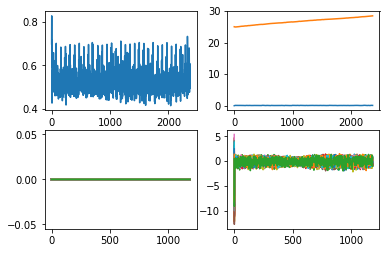

0.3776623579320194


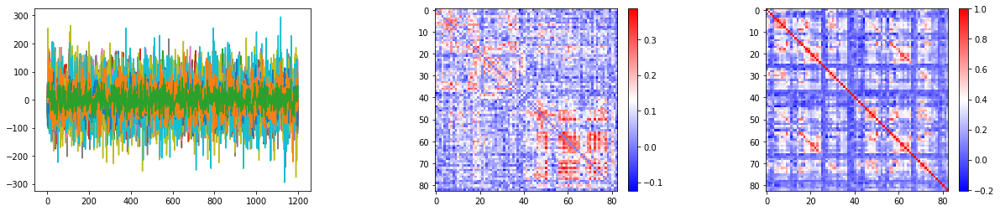

0.40058271303326337


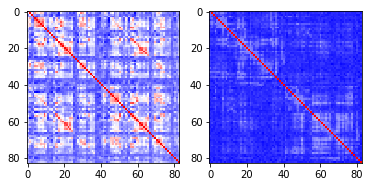

3 172332


<Figure size 432x288 with 0 Axes>

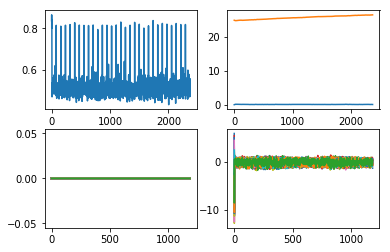

0.30186636350539486


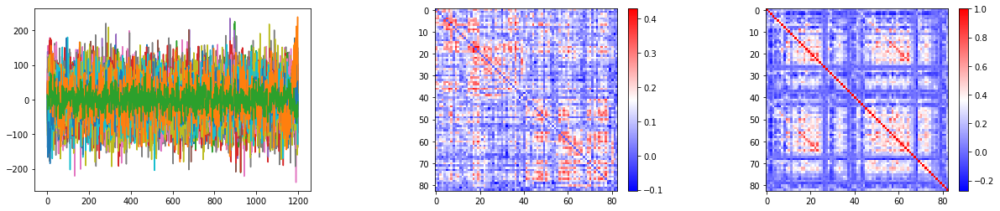

0.34667797492033614


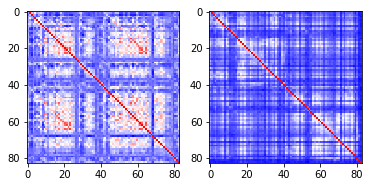

4 181131


<Figure size 432x288 with 0 Axes>

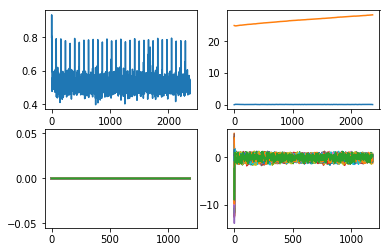

0.36197296516664257


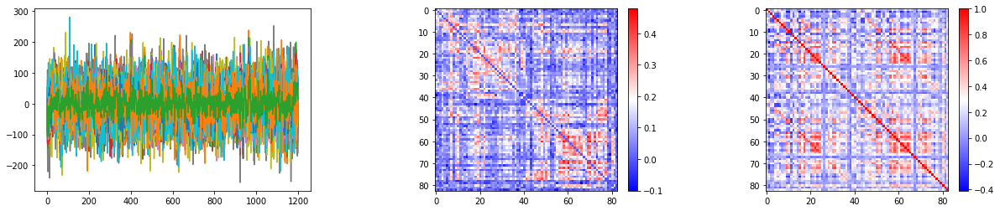

0.4167567260009253


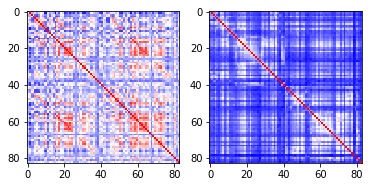

5 317332


<Figure size 432x288 with 0 Axes>

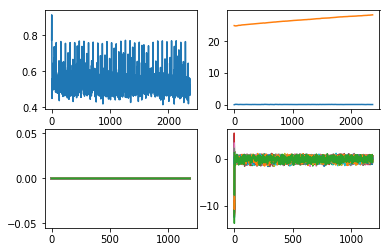

0.33837145038745237


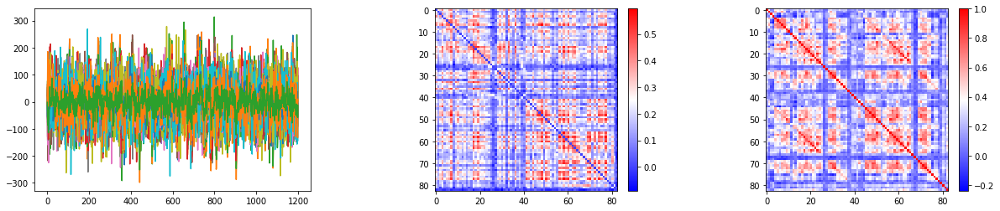

0.3666678603196175


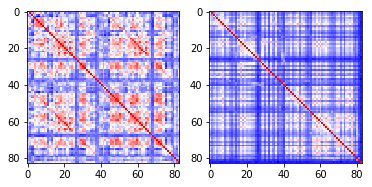

6 196750


<Figure size 432x288 with 0 Axes>

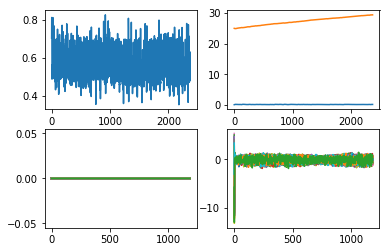

0.41588113839933194


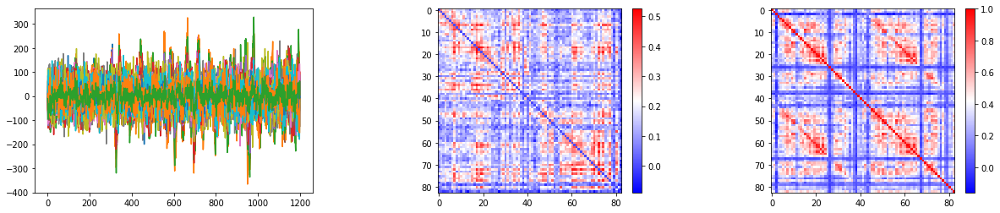

0.37806815550656947


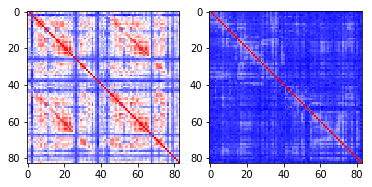

7 196144


<Figure size 432x288 with 0 Axes>

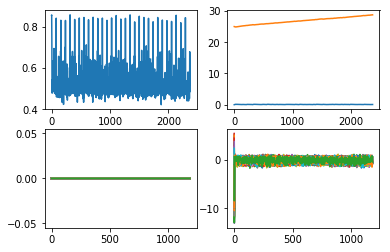

0.36200550233126505


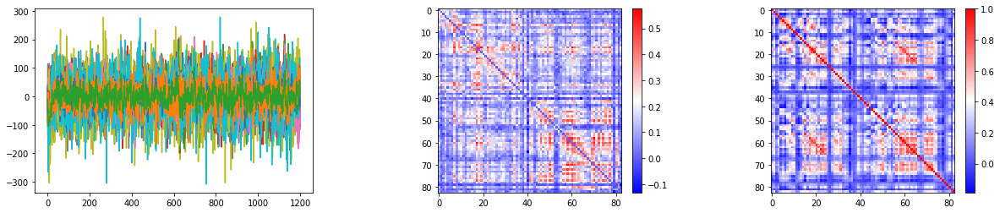

0.3198561041802594


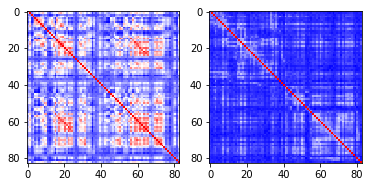

8 231928


<Figure size 432x288 with 0 Axes>

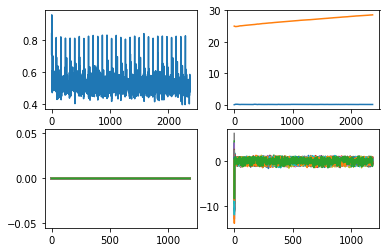

0.44743974161349737


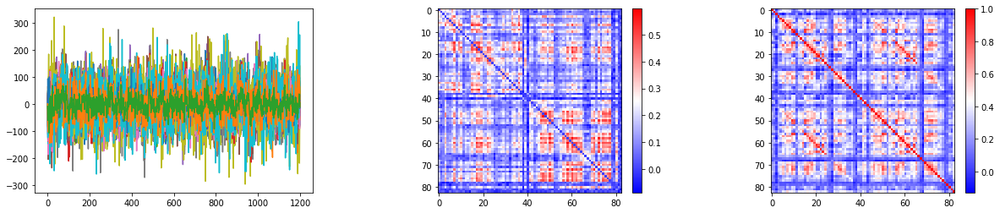

0.4644045634830425


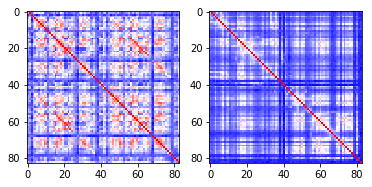

9 579867


<Figure size 432x288 with 0 Axes>

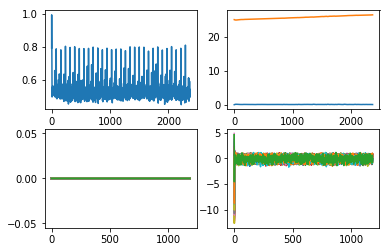

0.2862271828438631


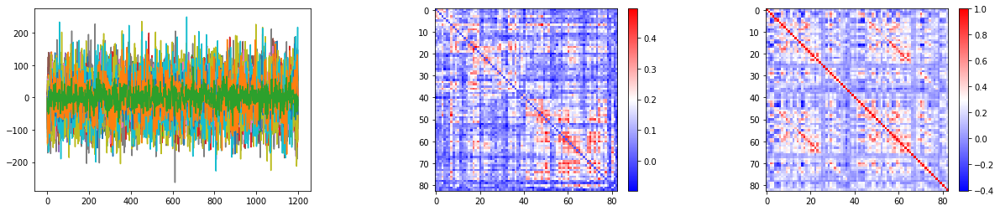

0.30998044911223543


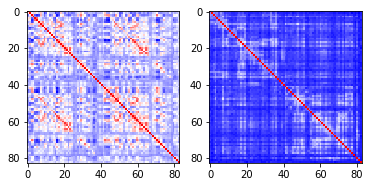

10 146432
11 148941


<Figure size 432x288 with 0 Axes>

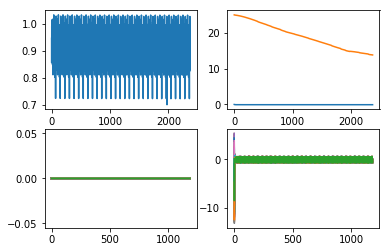

0.20164431390720447


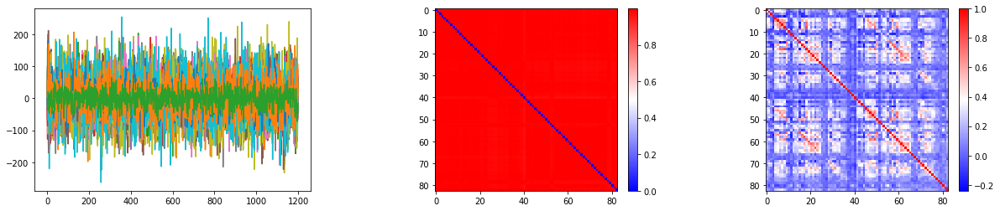

0.3200955004195767


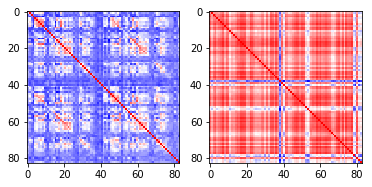

12 100307


<Figure size 432x288 with 0 Axes>

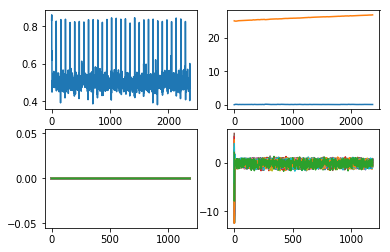

0.36028386538282337


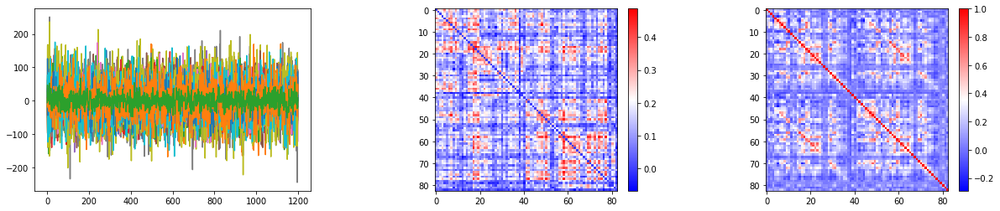

0.3840883380362237


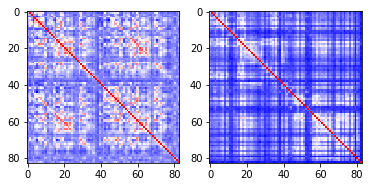

13 709551
14 155938
15 198451


<Figure size 432x288 with 0 Axes>

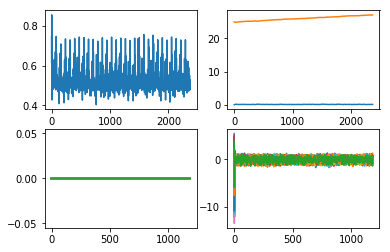

0.3821087556454864


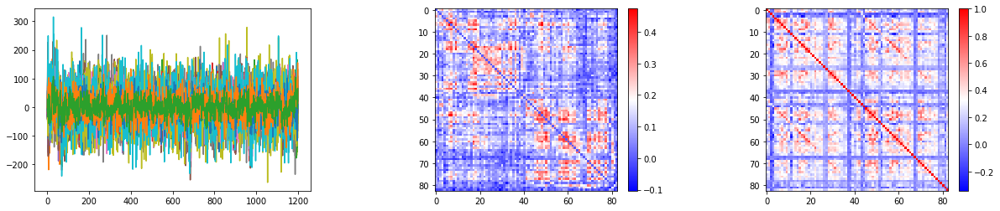

0.3735395477443325


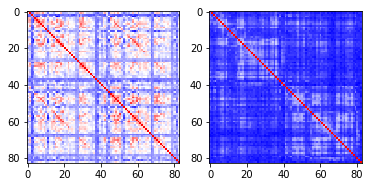

16 311320


<Figure size 432x288 with 0 Axes>

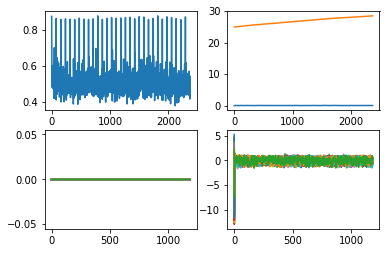

0.5095979622172704


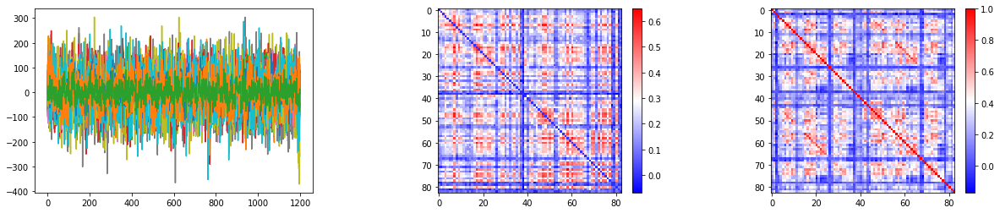

0.5074766747034338


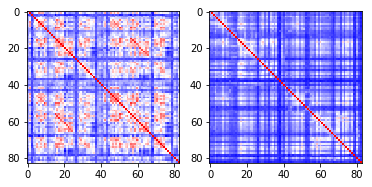

17 385450
18 173637


<Figure size 432x288 with 0 Axes>

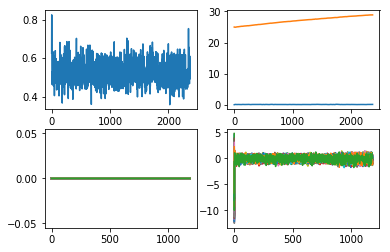

0.5262763877556378


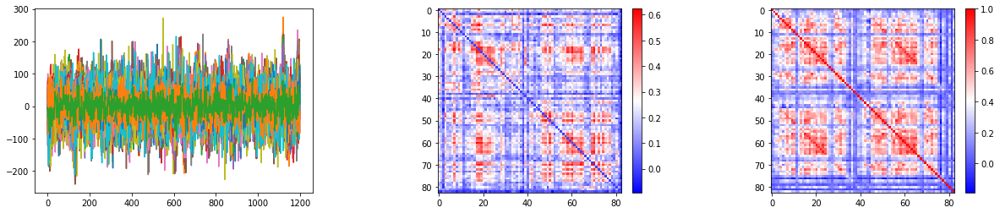

0.3943619757226567


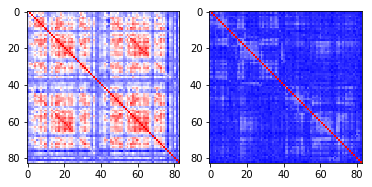

19 181636


<Figure size 432x288 with 0 Axes>

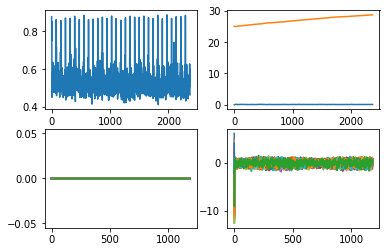

0.3696412062781997


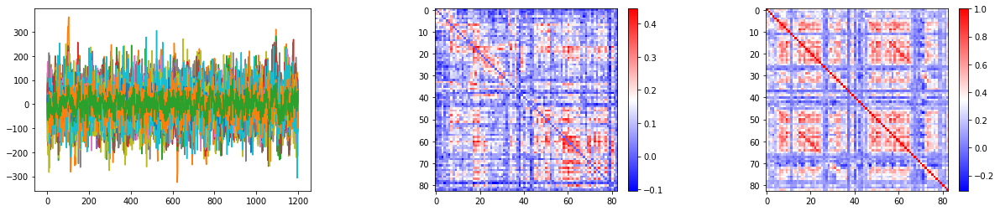

0.3214116633556581


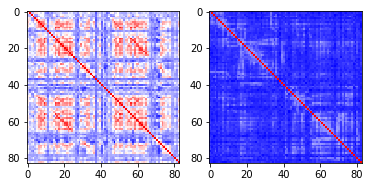

20 290136


<Figure size 432x288 with 0 Axes>

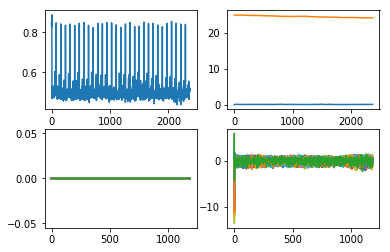

0.2326988183967385


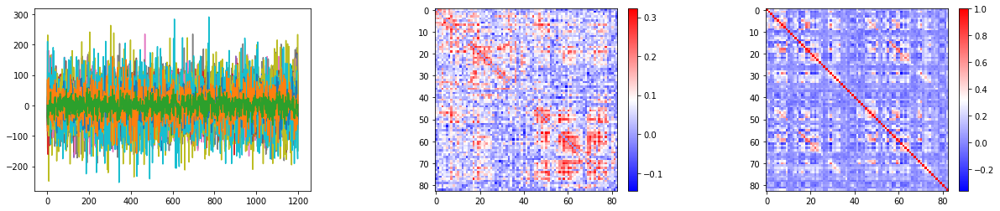

0.22275166993933668


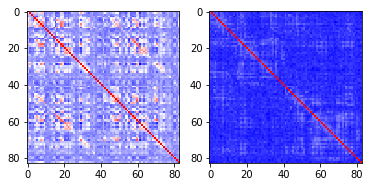

21 198653


<Figure size 432x288 with 0 Axes>

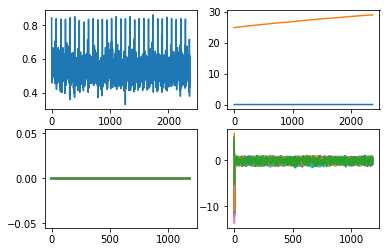

0.35016159047101436


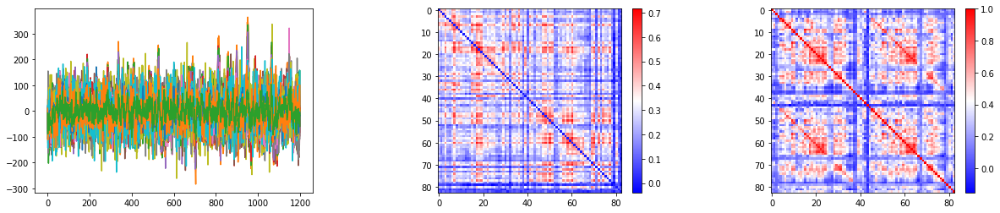

0.3699492205617926


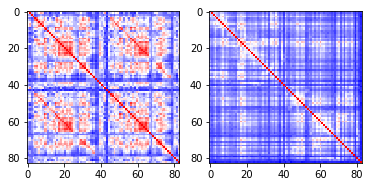

22 157336


<Figure size 432x288 with 0 Axes>

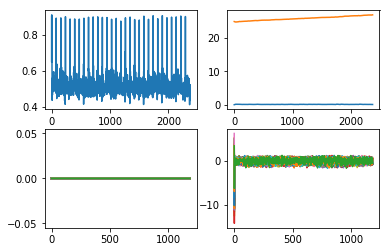

0.40384925478784495


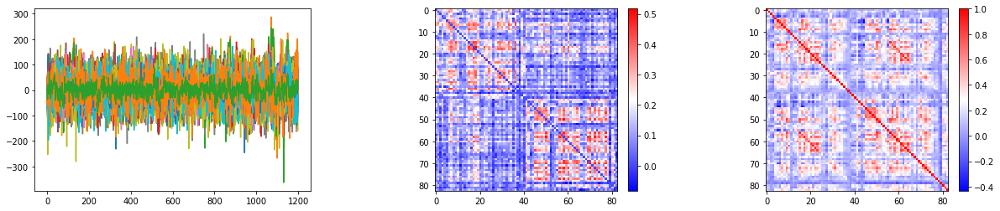

0.4334189432464791


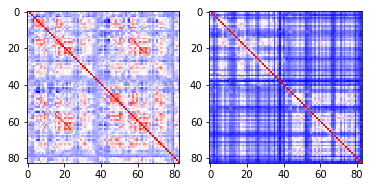

23 121921
24 145127
25 567961


<Figure size 432x288 with 0 Axes>

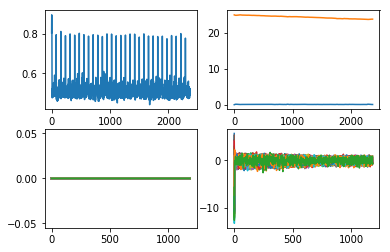

0.27616484371308203


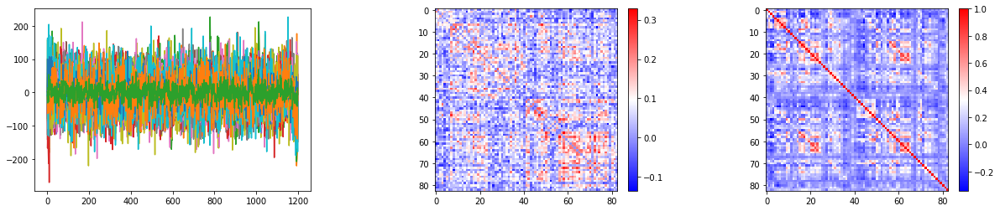

0.34625008024186865


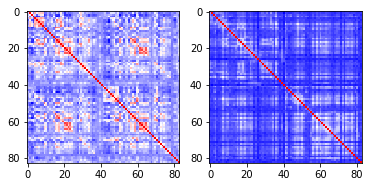

26 492754


<Figure size 432x288 with 0 Axes>

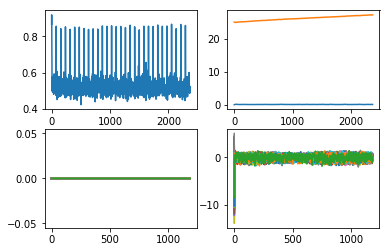

0.29516834632960354


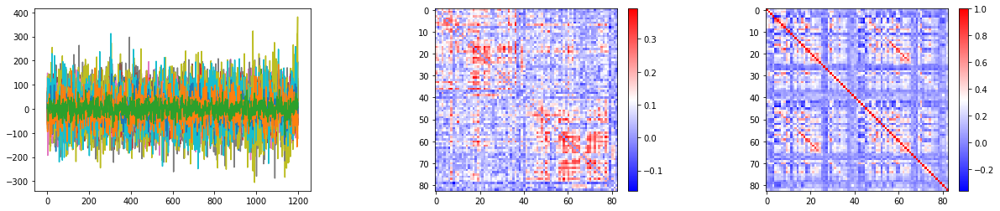

0.31783822681497687


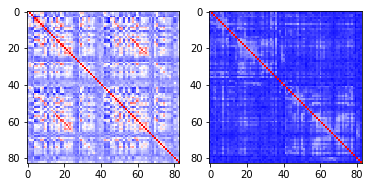

27 562446


<Figure size 432x288 with 0 Axes>

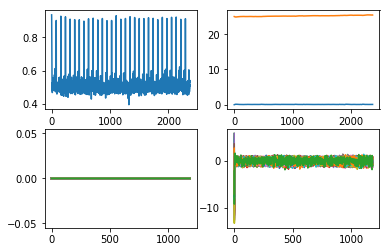

0.3756552541193739


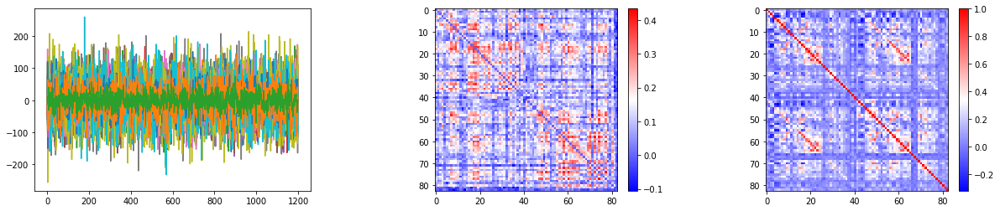

0.40730458824693333


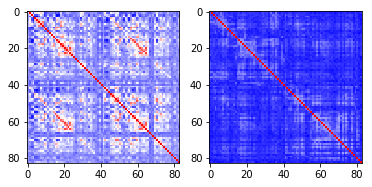

28 200210
29 151223
30 872158
31 579665


<Figure size 432x288 with 0 Axes>

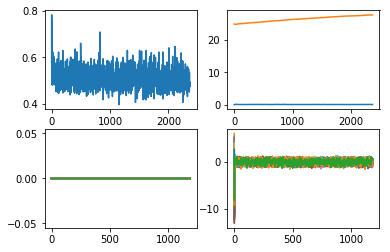

0.32302751841121247


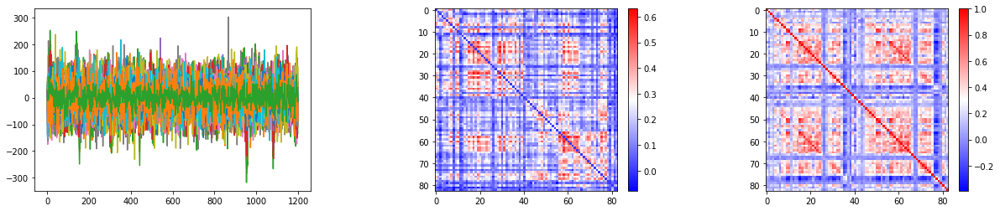

0.3494344704766288


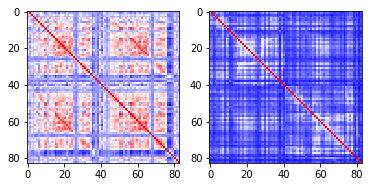

32 548250


<Figure size 432x288 with 0 Axes>

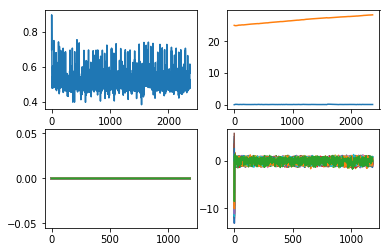

0.35675534050243585


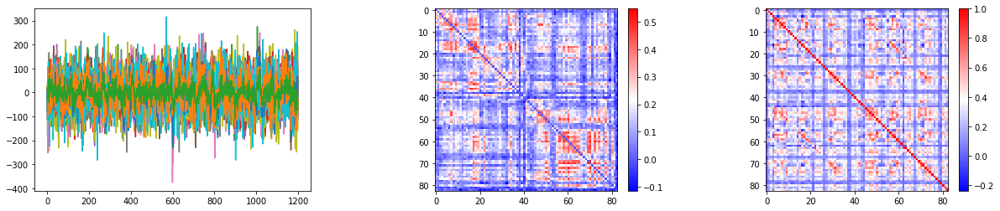

0.31740125000974095


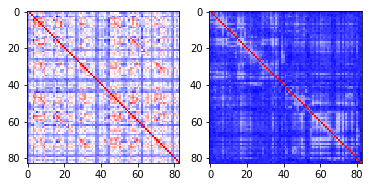

33 198350


<Figure size 432x288 with 0 Axes>

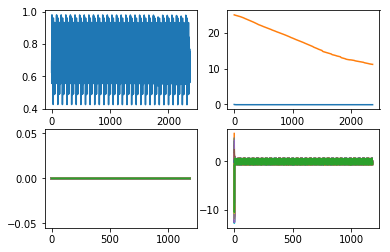

0.2954622570177491


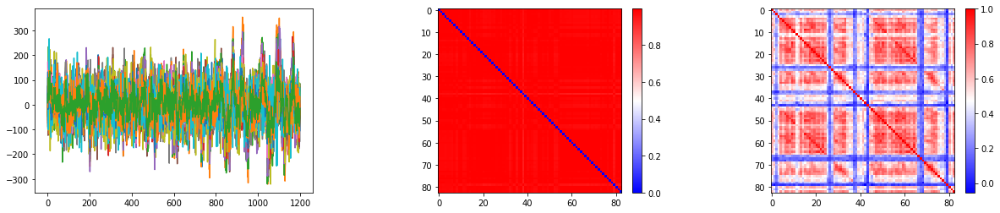

0.3581925291769196


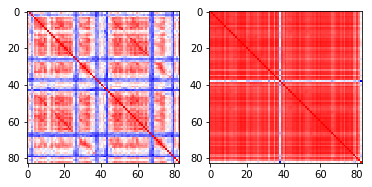

34 297655


<Figure size 432x288 with 0 Axes>

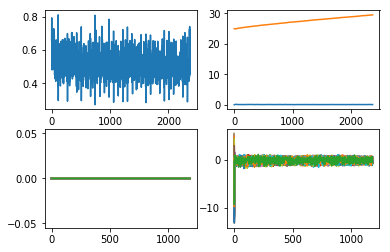

0.5064282039377794


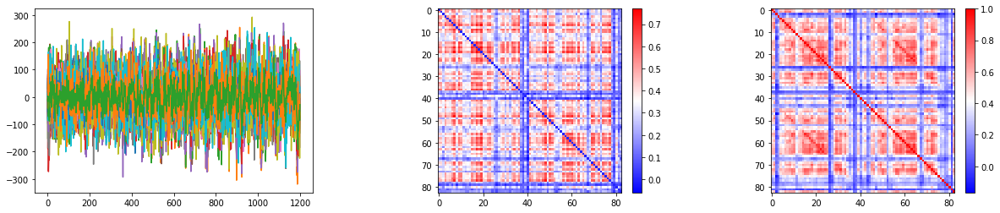

0.5562412434643076


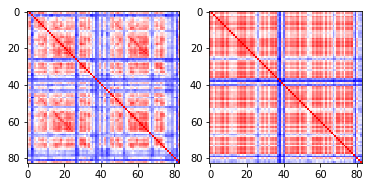

35 295146


<Figure size 432x288 with 0 Axes>

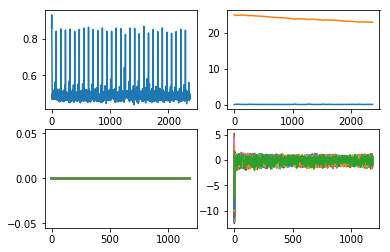

0.3316108129118608


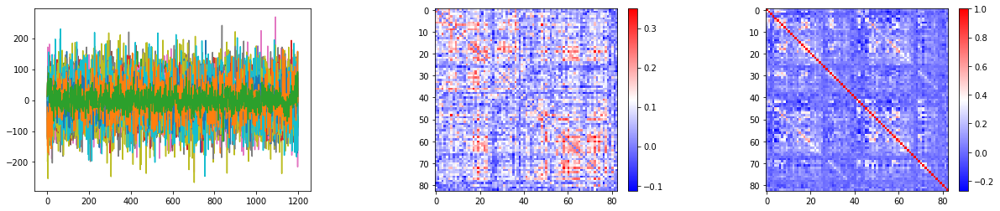

0.3586916972912318


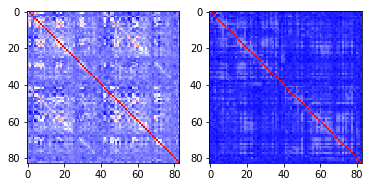

36 561444
37 183337


<Figure size 432x288 with 0 Axes>

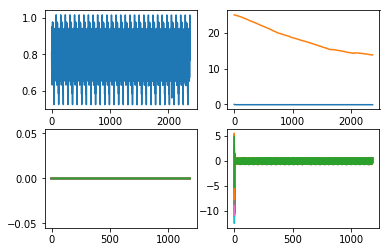

0.22473961086489438


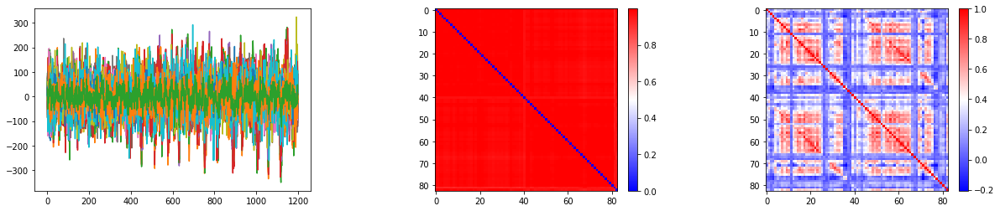

0.31581435203176056


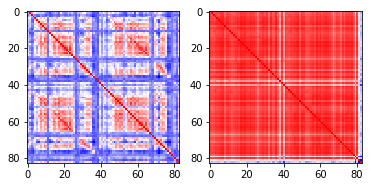

38 559053


<Figure size 432x288 with 0 Axes>

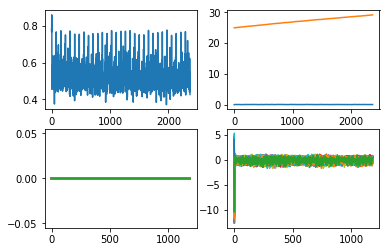

0.44925640355720603


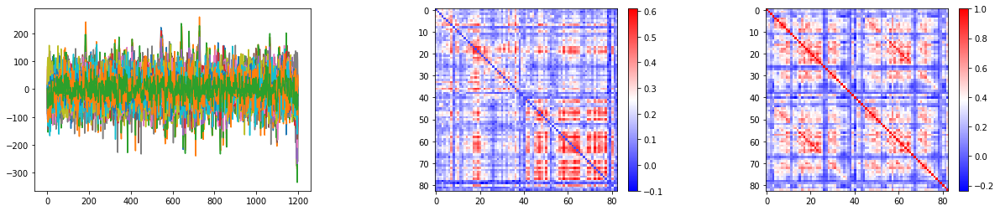

0.4472931232845682


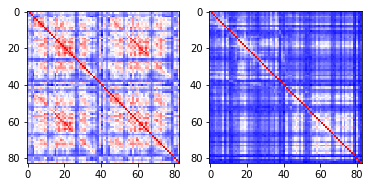

39 519950


<Figure size 432x288 with 0 Axes>

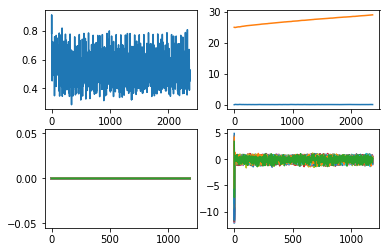

0.48784936111965743


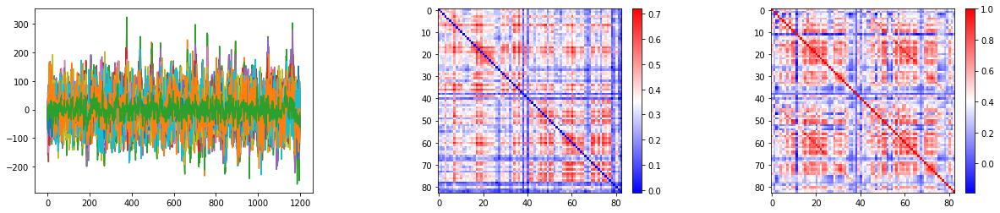

0.48255860097474934


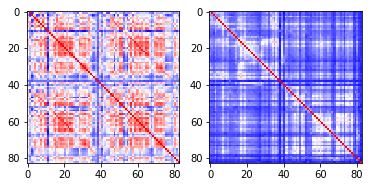

40 220721
41 197550


<Figure size 432x288 with 0 Axes>

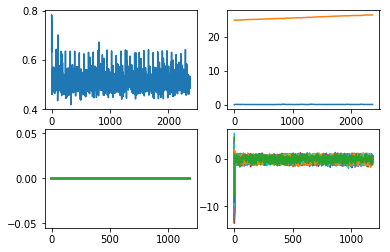

0.33959615734559373


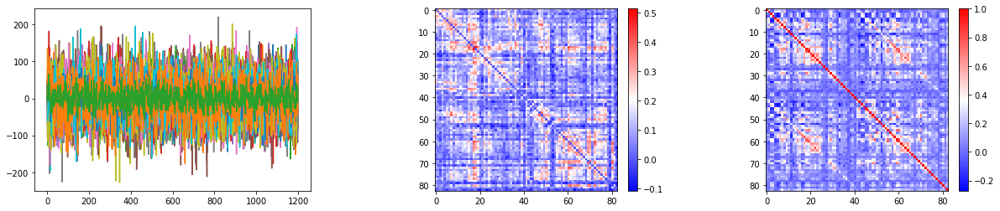

0.33139847915221604


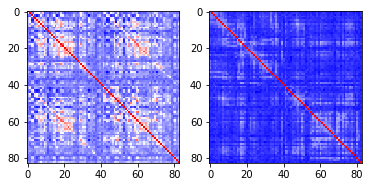

42 179952


<Figure size 432x288 with 0 Axes>

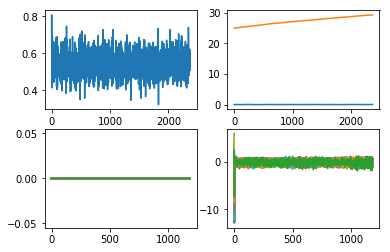

0.46265204704761564


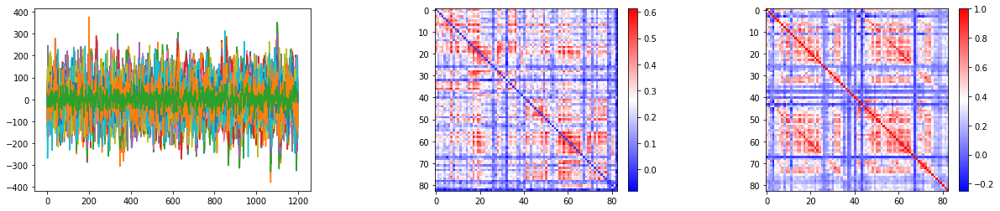

0.41585915716738686


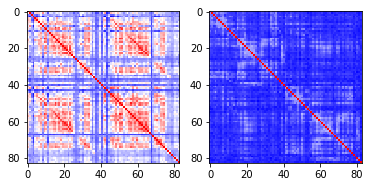

43 151526


<Figure size 432x288 with 0 Axes>

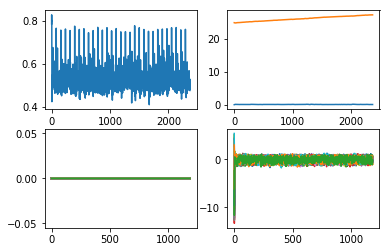

0.37262743979121243


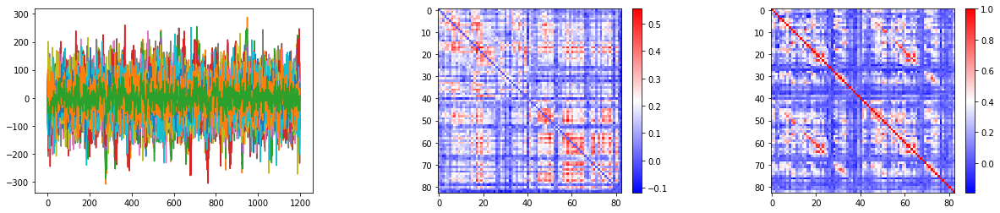

0.37703326358778216


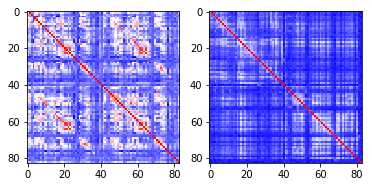

44 191033
45 177342


<Figure size 432x288 with 0 Axes>

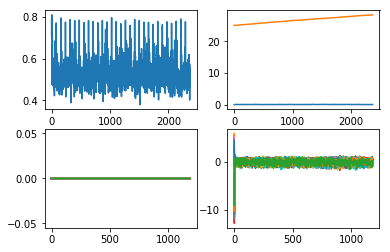

0.5646041902977592


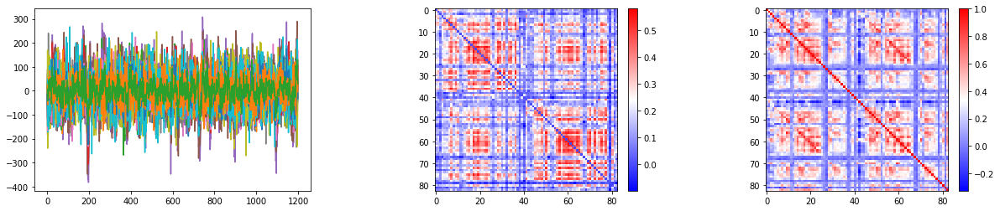

0.5798003604199861


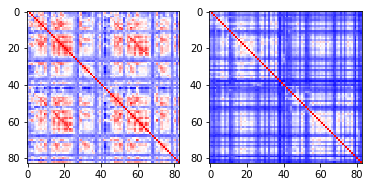

46 156536
47 298051


<Figure size 432x288 with 0 Axes>

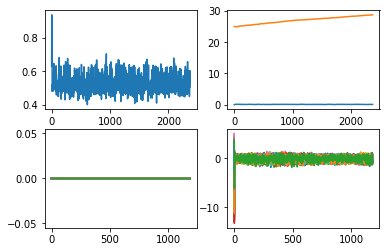

0.3891168018500044


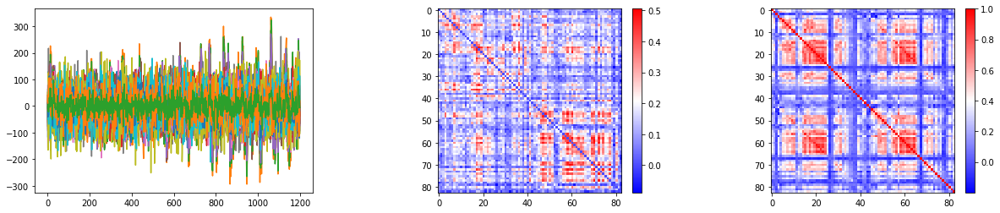

0.38824704359413137


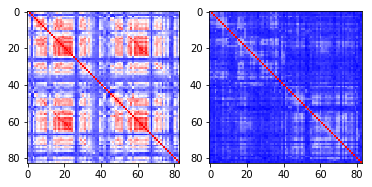

48 570243
49 154229


<Figure size 432x288 with 0 Axes>

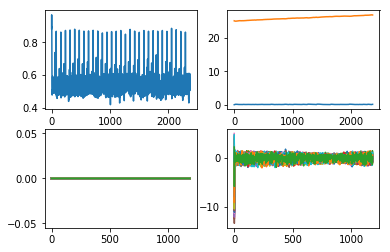

0.30763464027118315


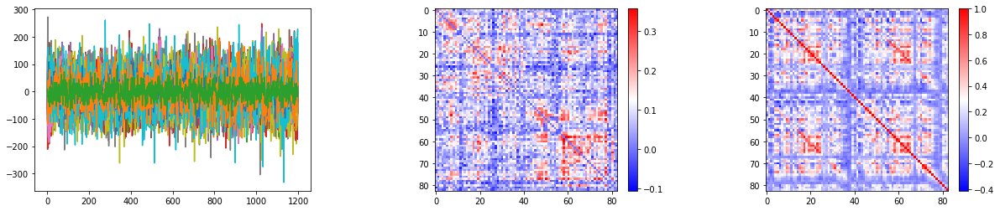

0.28821129451614463


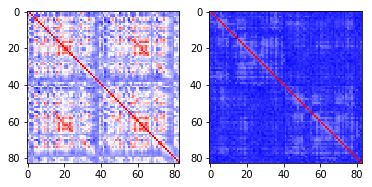

50 512835


<Figure size 432x288 with 0 Axes>

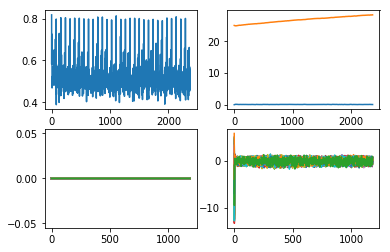

0.47109620078986353


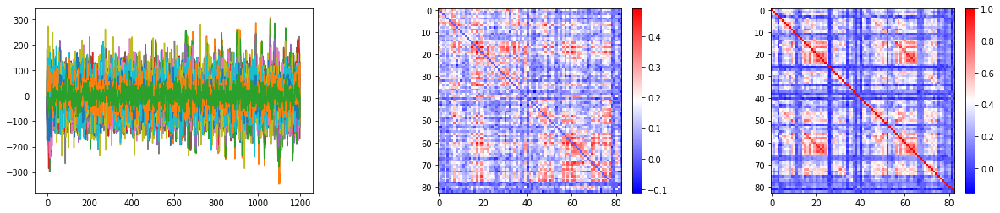

0.5180304733096273


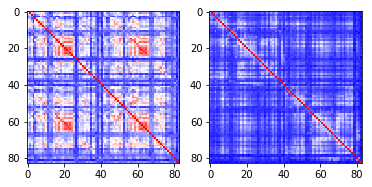

51 257542


<Figure size 432x288 with 0 Axes>

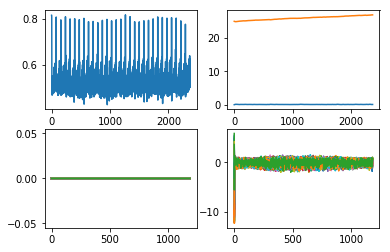

0.2704145324689232


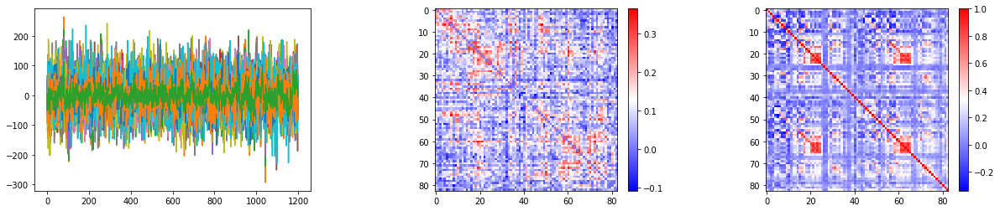

0.34894499375629395


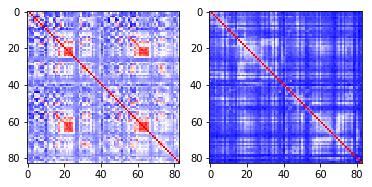

52 529549


<Figure size 432x288 with 0 Axes>

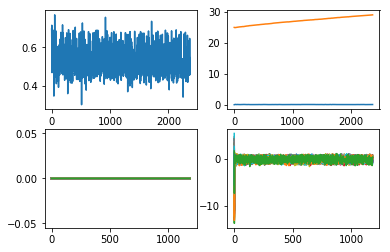

0.44772858378830327


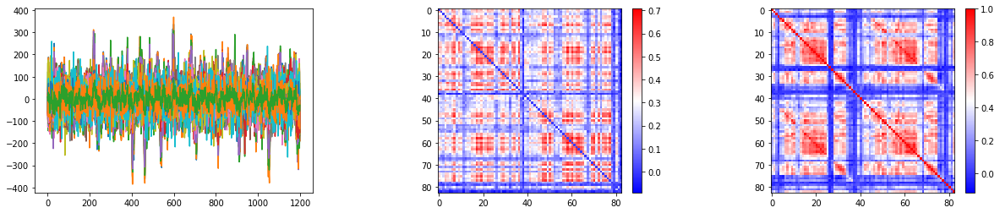

0.4608440508833761


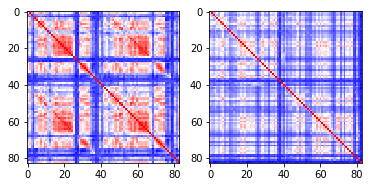

53 173738


<Figure size 432x288 with 0 Axes>

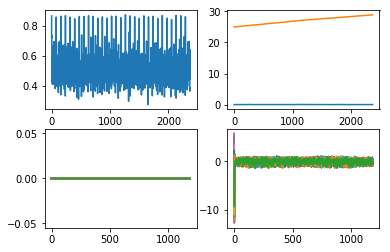

0.5255700961032342


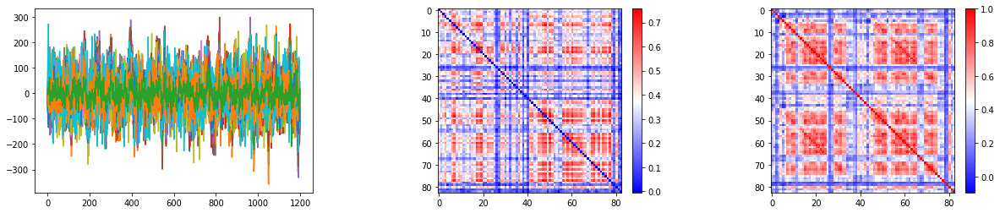

0.5269168313619306


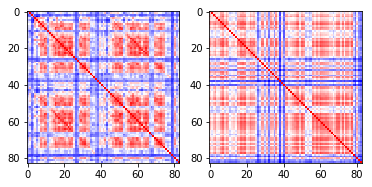

54 214423
55 177746


<Figure size 432x288 with 0 Axes>

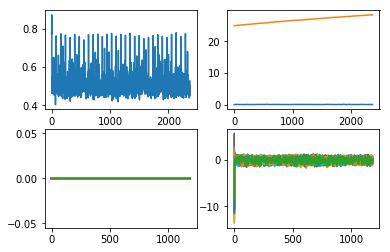

0.4157645462523668


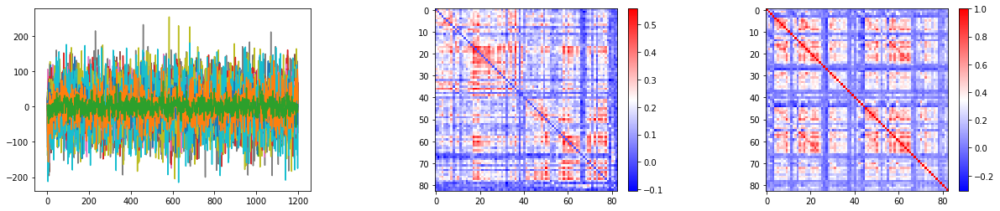

0.4505186126870119


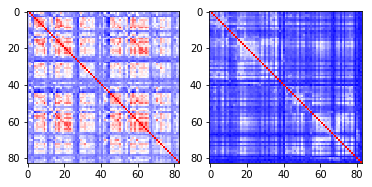

56 171532


<Figure size 432x288 with 0 Axes>

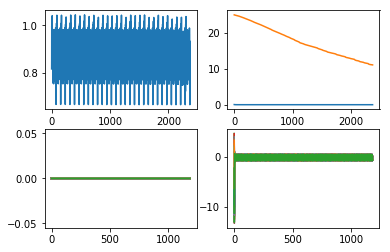

0.05643064037507297


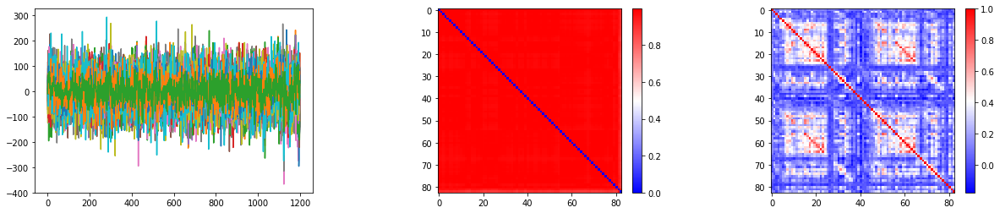

0.01058699056362864


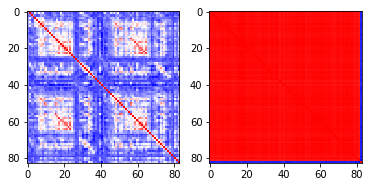

57 480141


<Figure size 432x288 with 0 Axes>

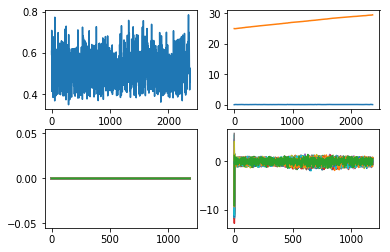

0.3878076968941476


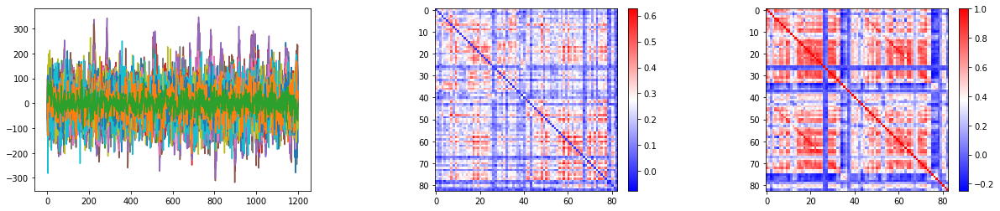

0.39763065411772586


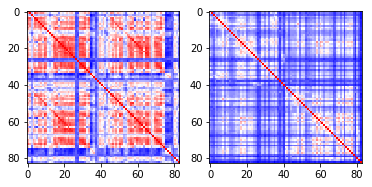

58 285446


<Figure size 432x288 with 0 Axes>

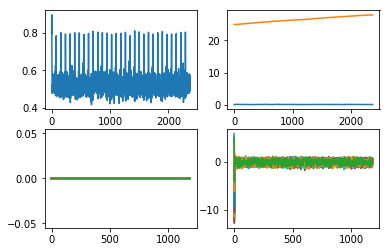

0.2528254811259187


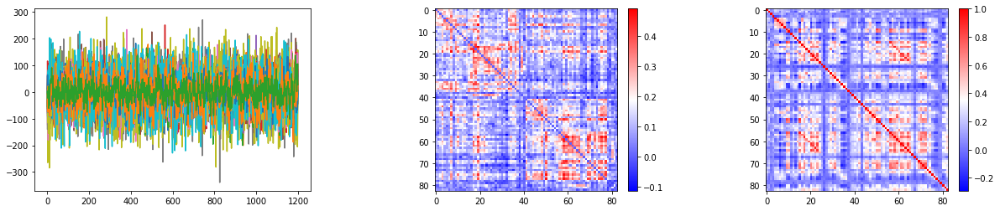

0.33189053463340307


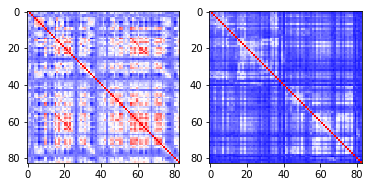

59 176441


<Figure size 432x288 with 0 Axes>

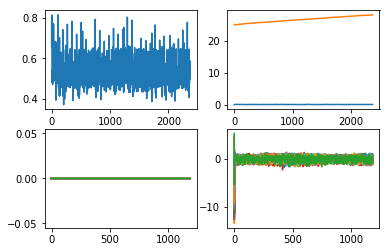

0.39028700002044125


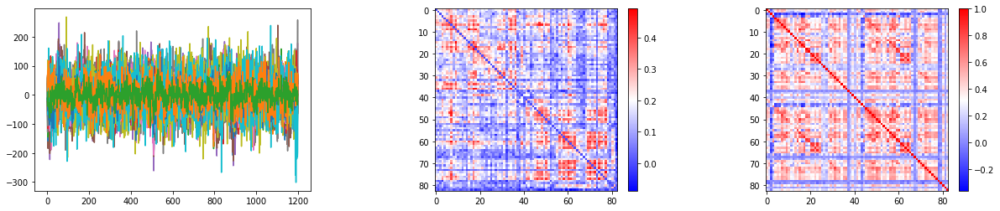

0.37232316178619324


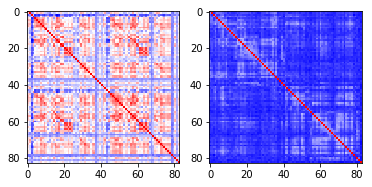

60 280941


<Figure size 432x288 with 0 Axes>

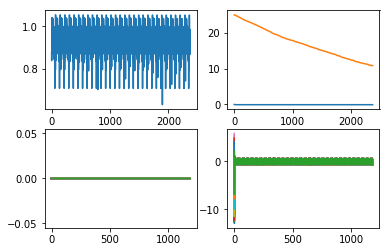

0.171737120325344


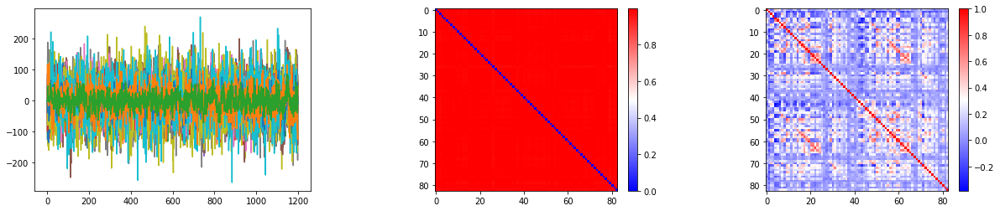

0.13773567925025917


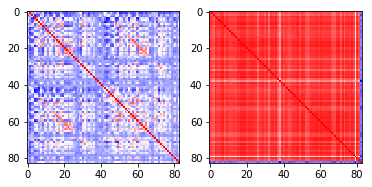

61 115017
62 156435


<Figure size 432x288 with 0 Axes>

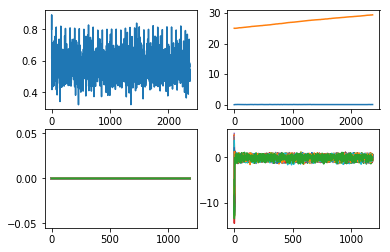

0.3842833476601941


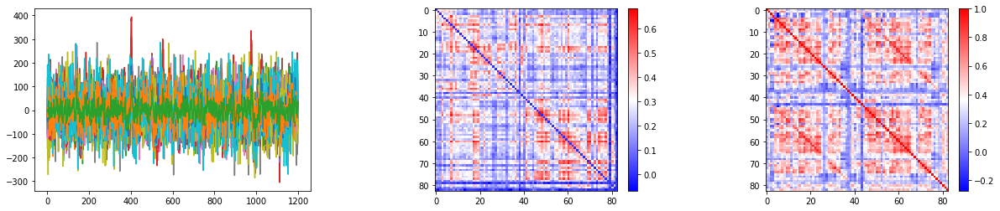

0.39034774316939846


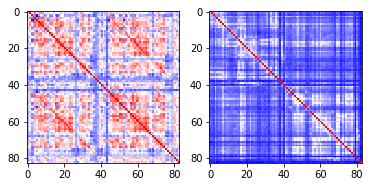

63 965771
64 448347


<Figure size 432x288 with 0 Axes>

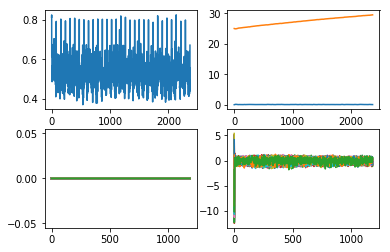

0.3399611659097539


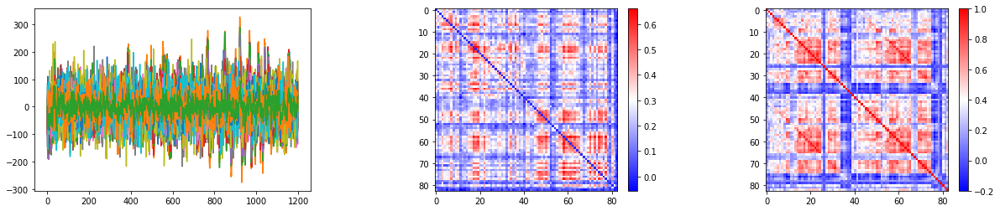

0.3504982583796363


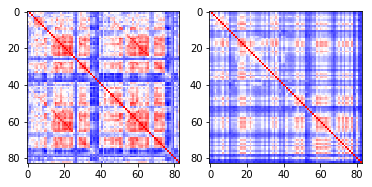

65 173233
66 173536


<Figure size 432x288 with 0 Axes>

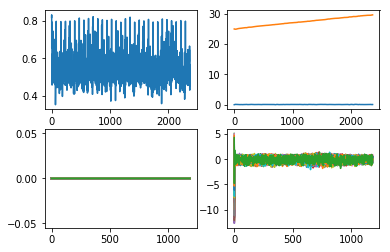

0.339372254054949


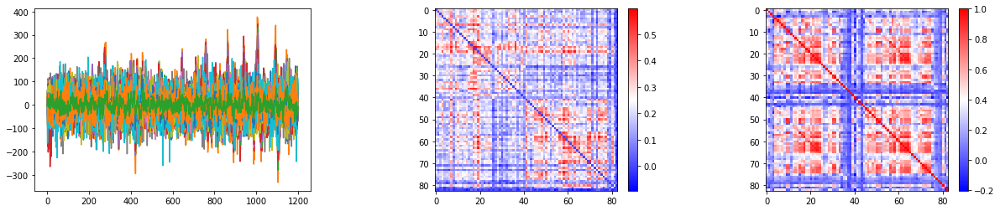

0.3830869489438331


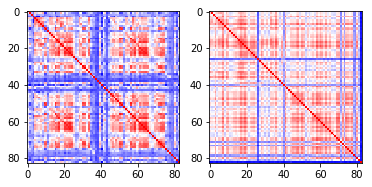

67 904044
68 175035


<Figure size 432x288 with 0 Axes>

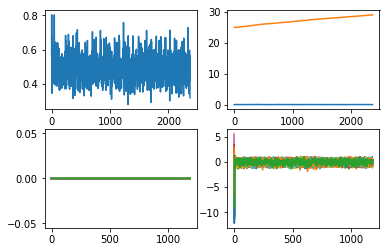

0.5128868046150937


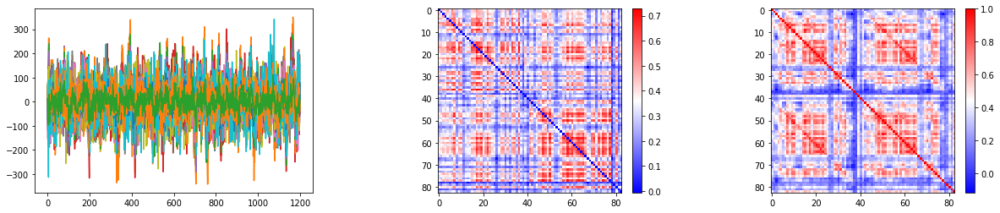

0.5121148282295995


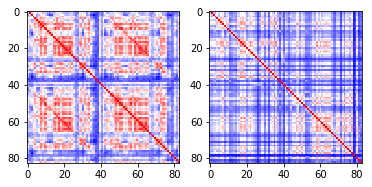

69 150928


<Figure size 432x288 with 0 Axes>

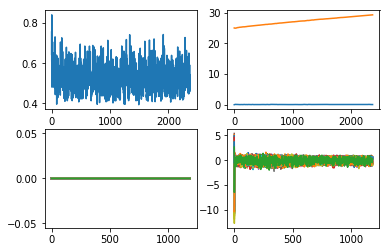

0.35943755285464957


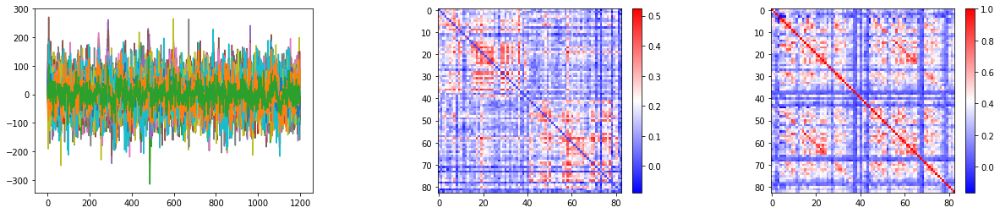

0.44051196313701707


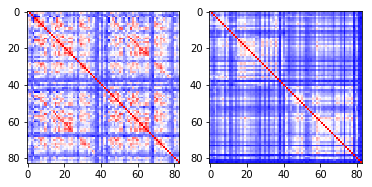

70 316835


<Figure size 432x288 with 0 Axes>

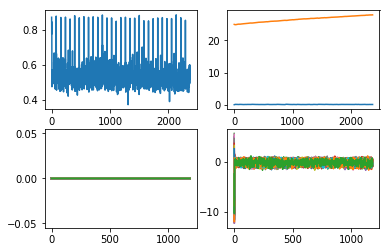

0.29927166104206454


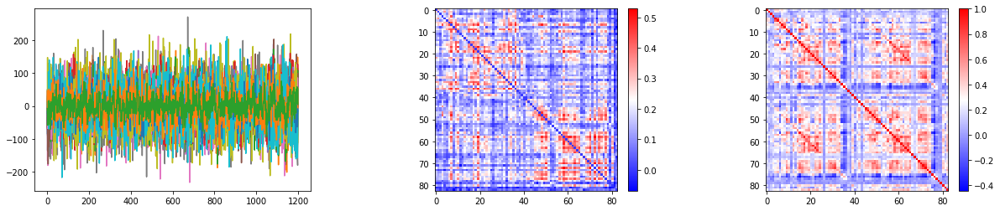

0.27650110789345544


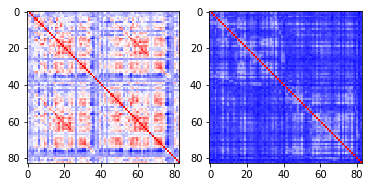

71 211215
72 171633


<Figure size 432x288 with 0 Axes>

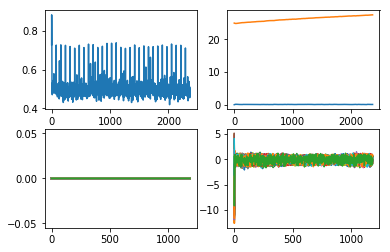

0.3436408998282523


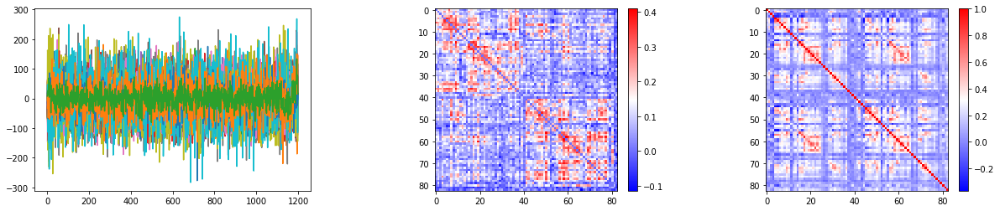

0.3661123523253317


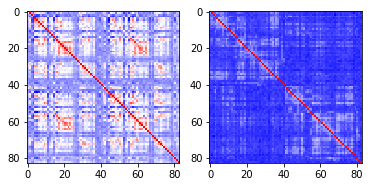

73 305830


<Figure size 432x288 with 0 Axes>

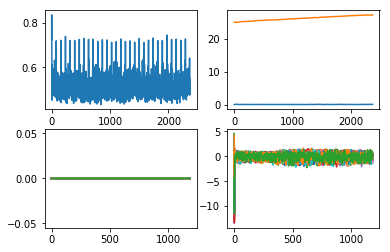

0.24882235861633295


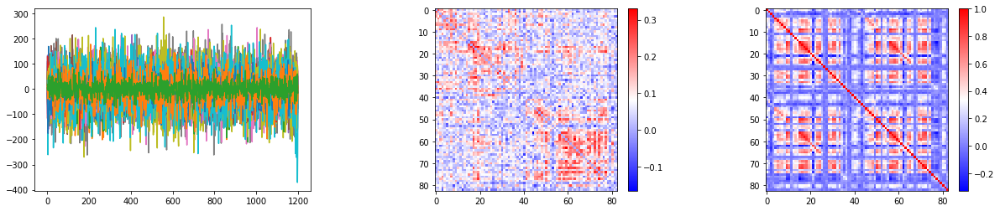

0.3227129270809711


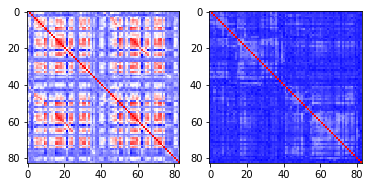

74 926862
75 547046


<Figure size 432x288 with 0 Axes>

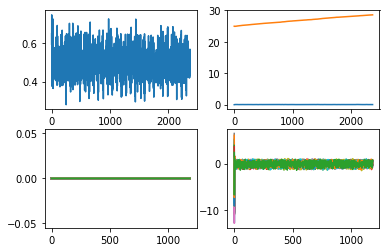

0.5638903374775119


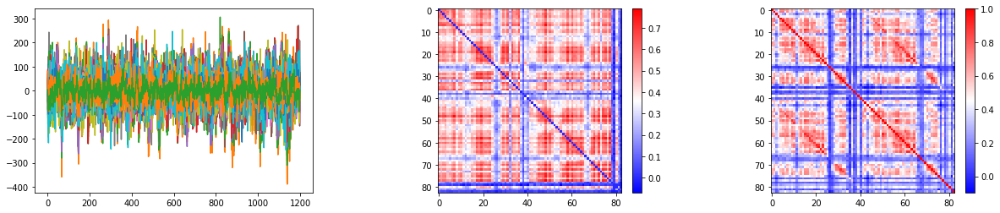

0.5702919445819825


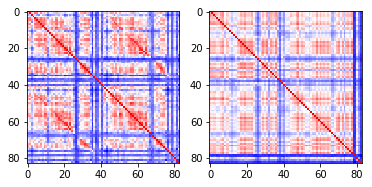

76 154936


<Figure size 432x288 with 0 Axes>

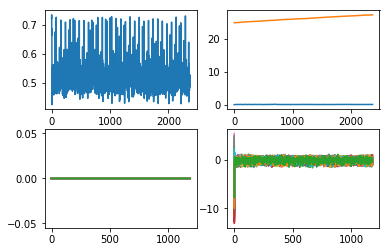

0.37127280063614315


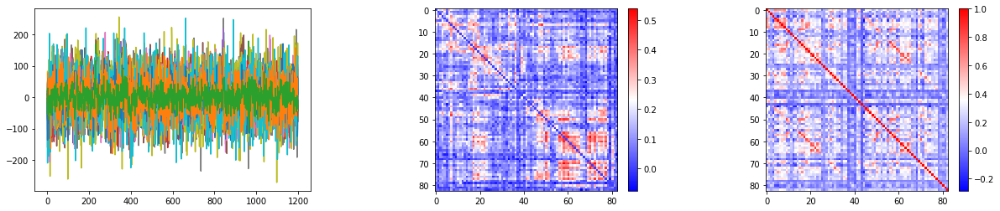

0.3594722190933475


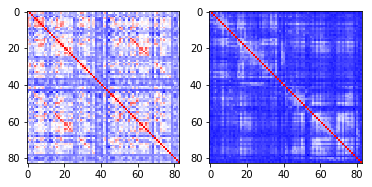

77 127327
78 318637
79 158338
80 910241
81 191336
82 286650


<Figure size 432x288 with 0 Axes>

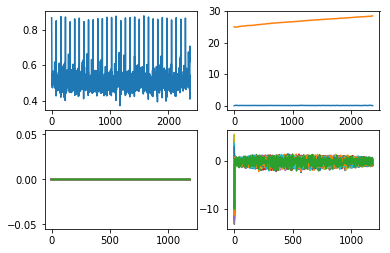

0.4118117766639712


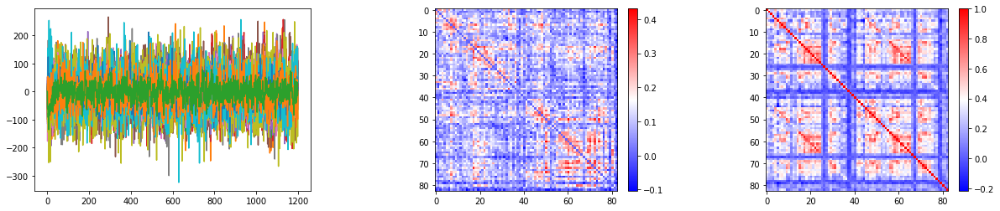

0.5739104115033983


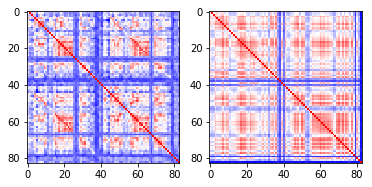

83 753251
84 486759


<Figure size 432x288 with 0 Axes>

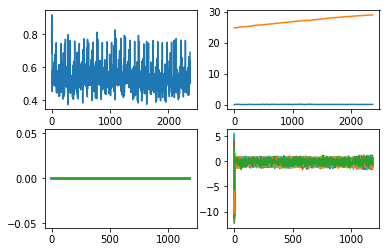

0.42604122725921295


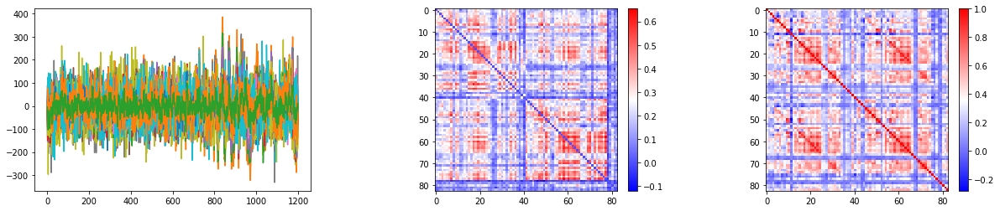

0.34933444975630235


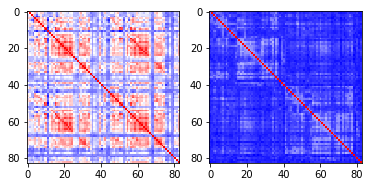

85 153025


<Figure size 432x288 with 0 Axes>

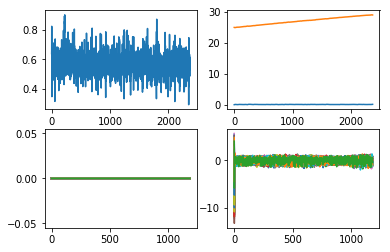

0.5629404099536441


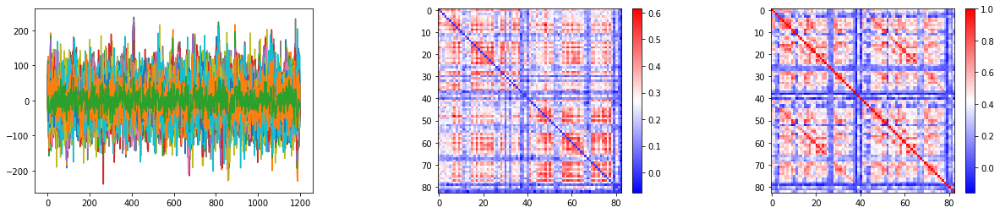

0.45945926024021494


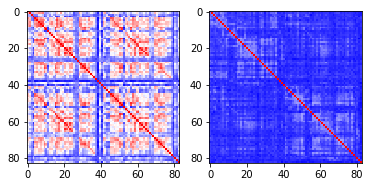

86 200008
87 803240
88 156637


<Figure size 432x288 with 0 Axes>

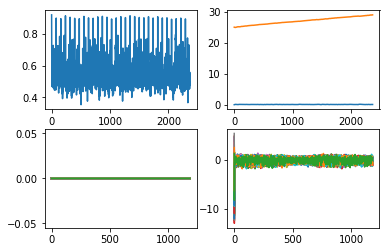

0.5598628312411293


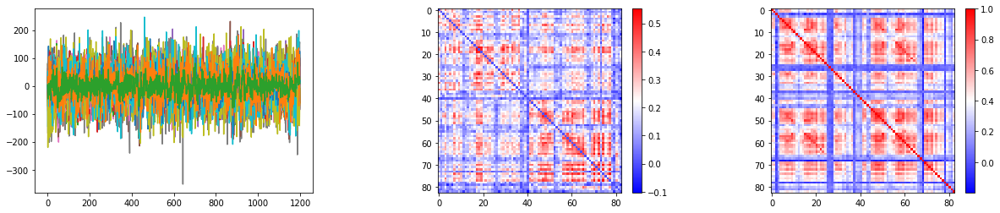

0.5860153774038792


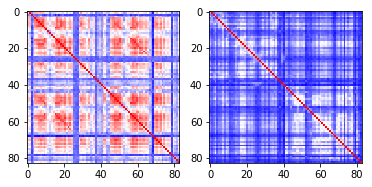

89 149842


<Figure size 432x288 with 0 Axes>

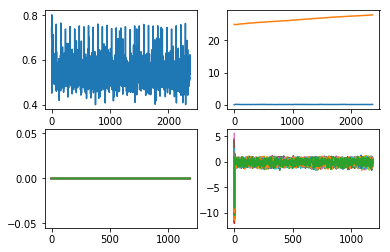

0.3547505068015479


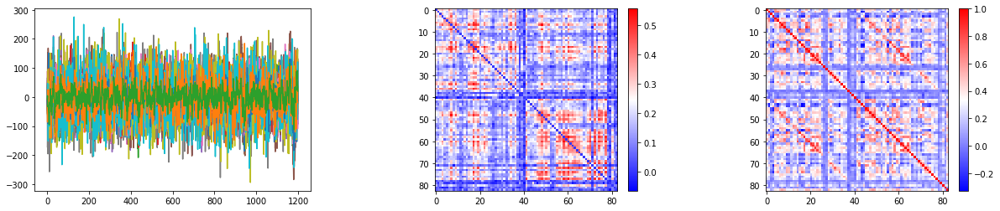

0.33619587653045346


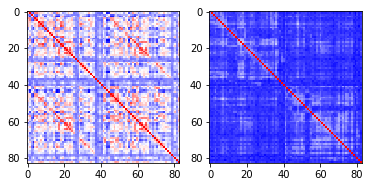

90 159744
91 299154


<Figure size 432x288 with 0 Axes>

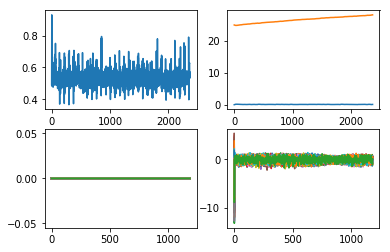

0.34738456743629725


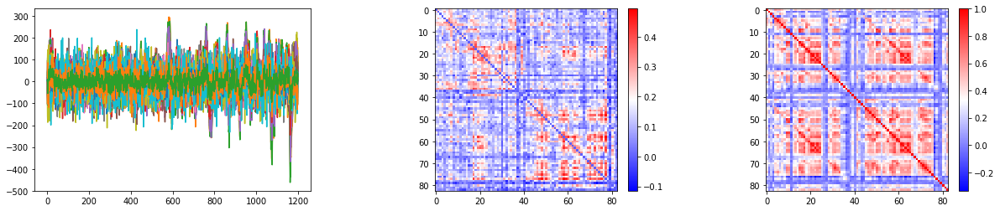

0.35680632289333547


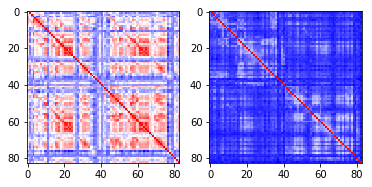

92 957974
93 671855
94 173940


<Figure size 432x288 with 0 Axes>

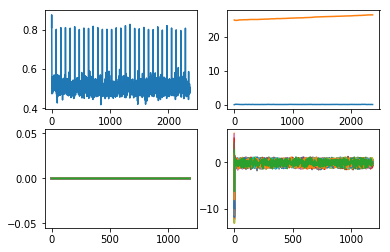

0.3467750856228961


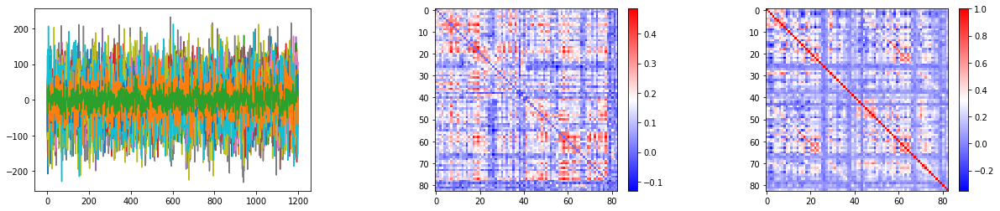

0.3610038596842765


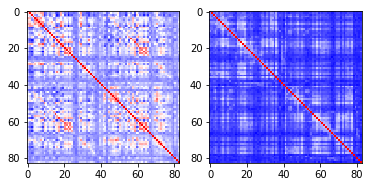

95 465852


<Figure size 432x288 with 0 Axes>

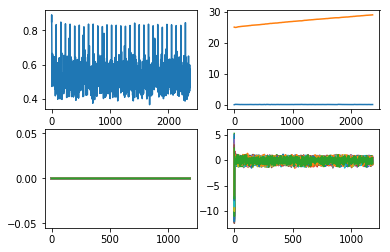

0.35229387509661014


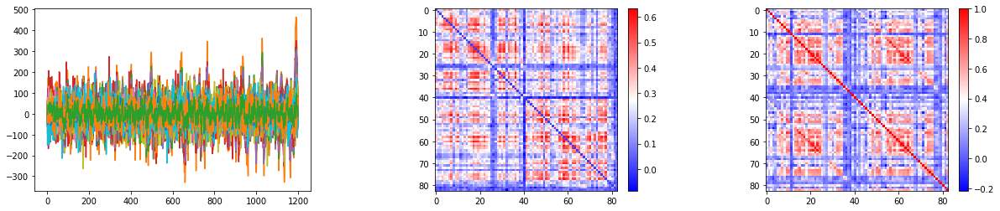

0.36840566732337543


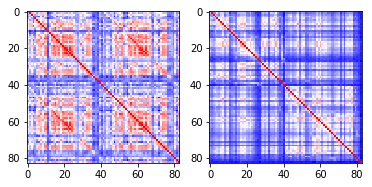

96 150423


<Figure size 432x288 with 0 Axes>

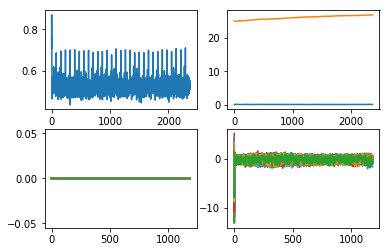

0.25548240201035766


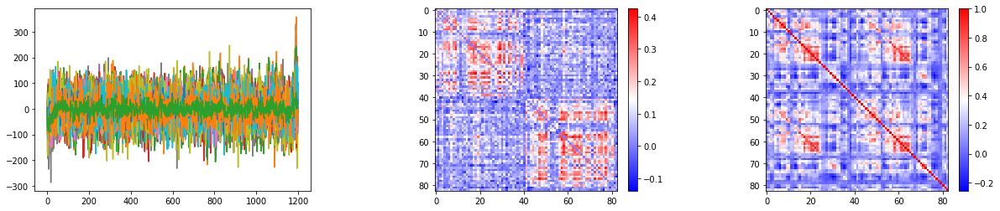

0.25095682331947566


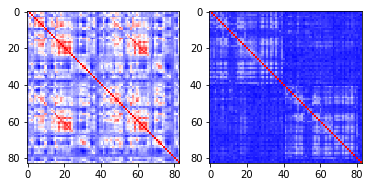

97 599469
98 199251


<Figure size 432x288 with 0 Axes>

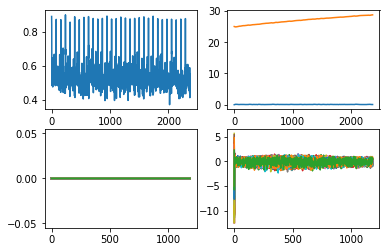

0.4211076466778567


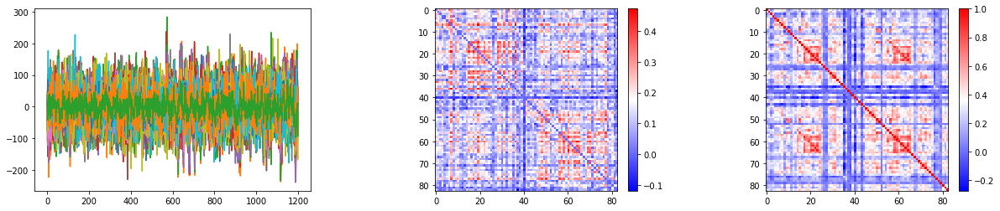

0.49717489480138827


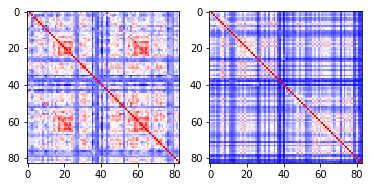

99 816653
100 158843


<Figure size 432x288 with 0 Axes>

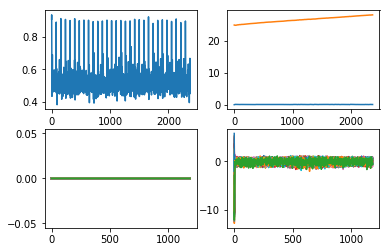

0.39497913744187363


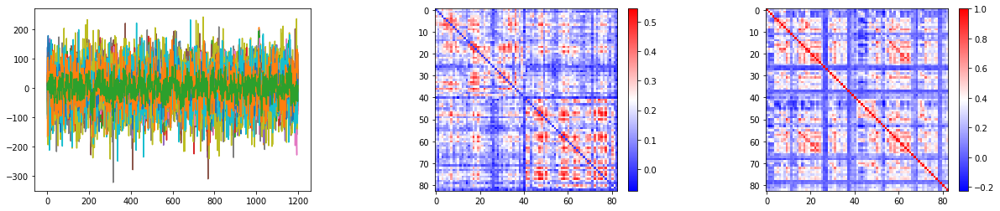

0.46171938663127576


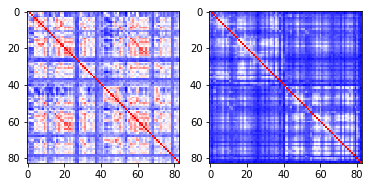

101 151627


<Figure size 432x288 with 0 Axes>

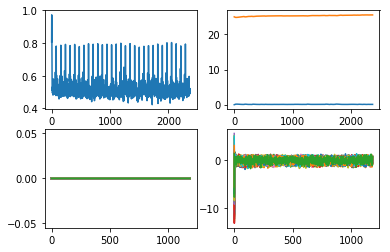

0.2957204057046131


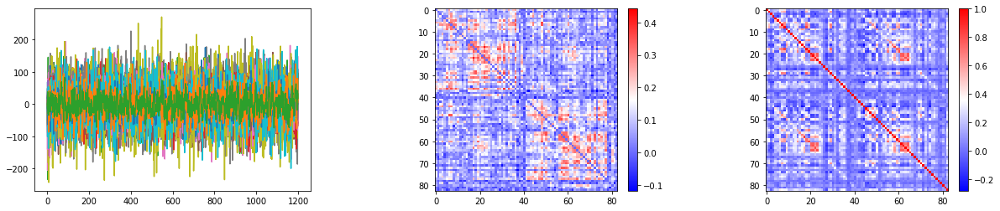

0.31362261535174424


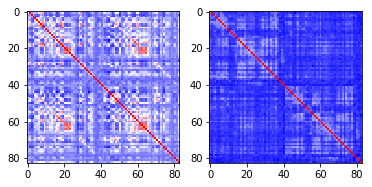

102 197651


<Figure size 432x288 with 0 Axes>

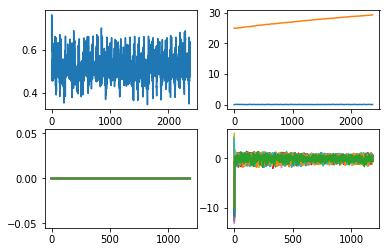

0.5069769732006472


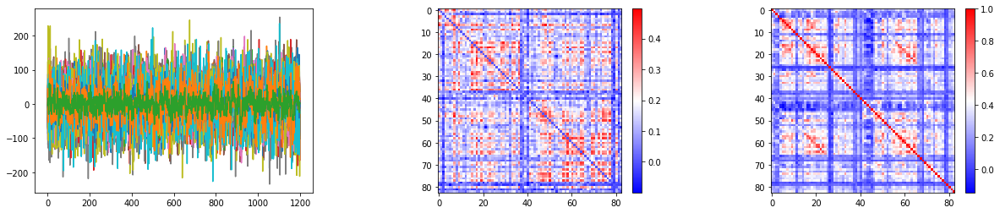

0.5066274574664108


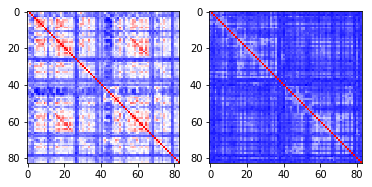

103 175540
104 555651


<Figure size 432x288 with 0 Axes>

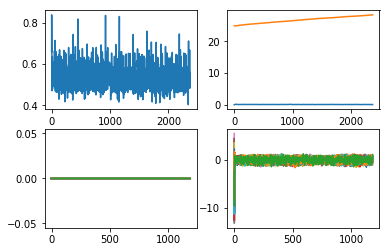

0.3496471226494745


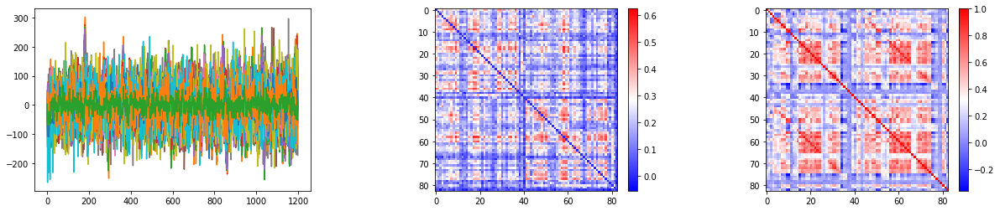

0.3400905034905307


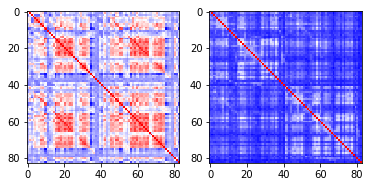

105 896778
106 792867
107 580347
108 153631


<Figure size 432x288 with 0 Axes>

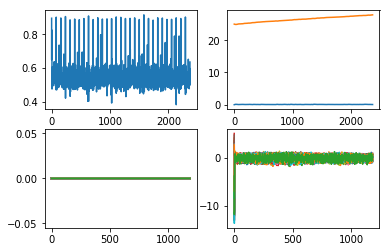

0.3170290923508199


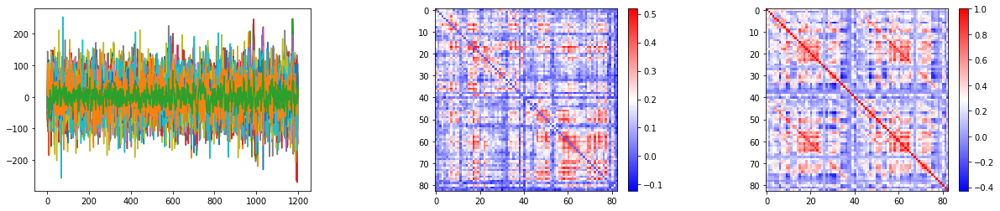

0.3369848772615572


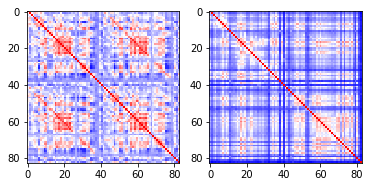

109 304727


<Figure size 432x288 with 0 Axes>

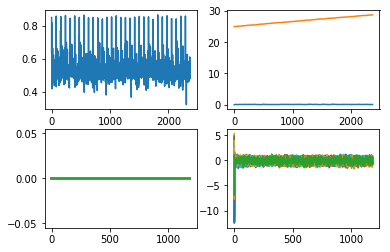

0.4831005904185755


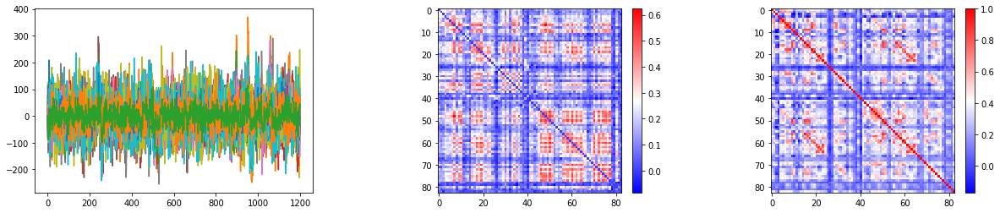

0.48539095736380933


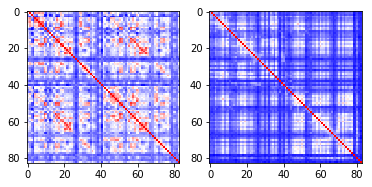

110 207123
111 303624
112 174841


<Figure size 432x288 with 0 Axes>

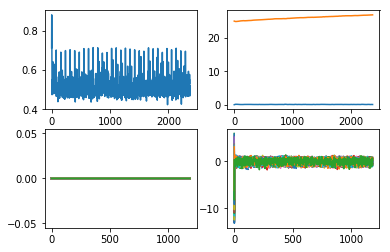

0.31839101103036516


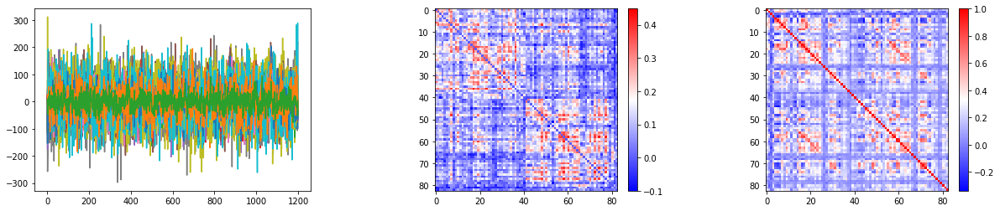

0.3676548989116956


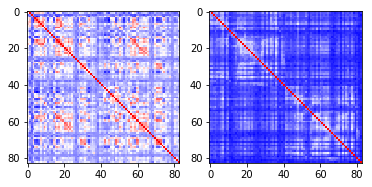

113 573249


<Figure size 432x288 with 0 Axes>

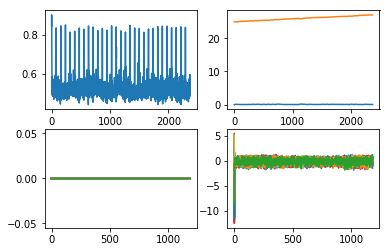

0.36364567192013747


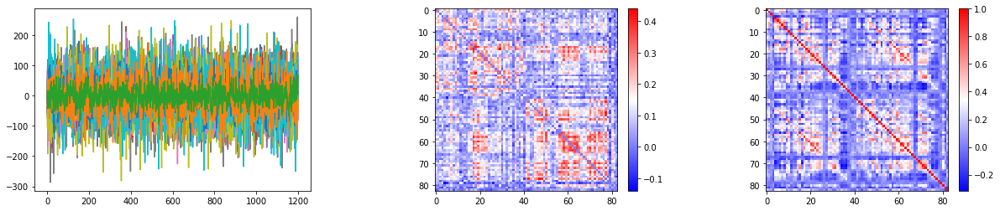

0.3527522435567164


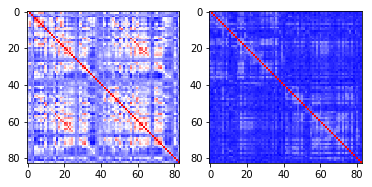

114 872764
115 179548
116 144428
117 529953


<Figure size 432x288 with 0 Axes>

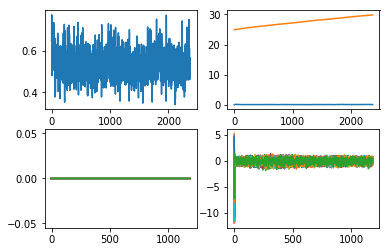

0.3092670849008651


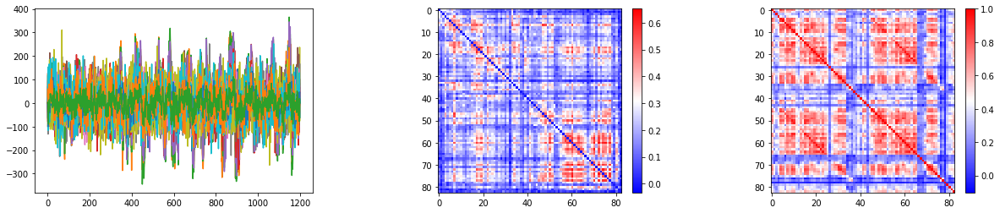

0.3152975759704638


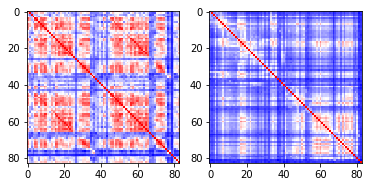

118 199655


<Figure size 432x288 with 0 Axes>

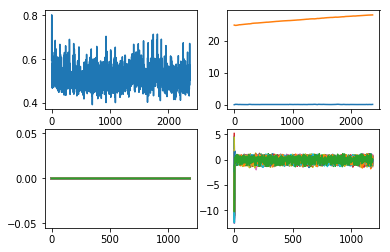

0.3503395051162798


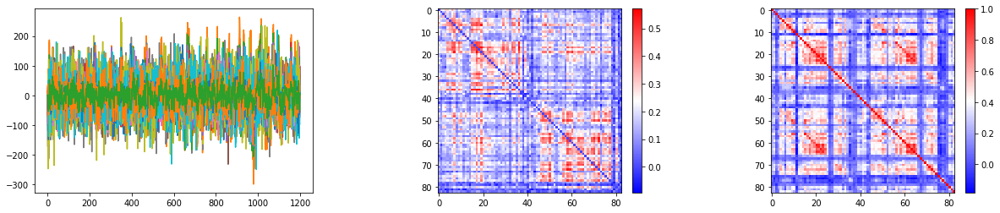

0.3107005448671753


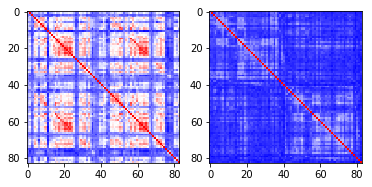

119 182739


<Figure size 432x288 with 0 Axes>

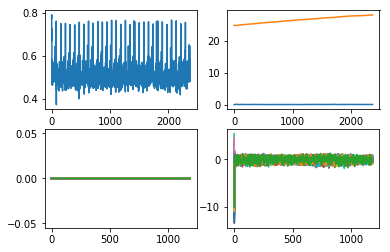

0.35597097824131796


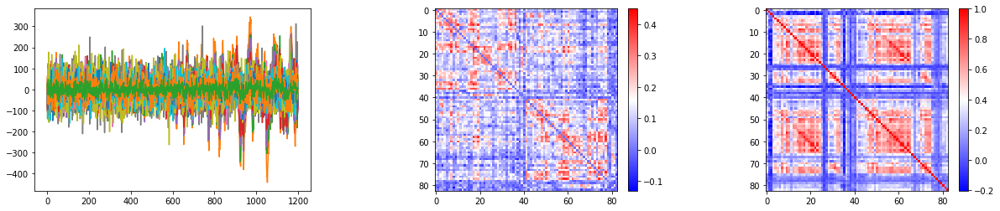

0.43139707128975746


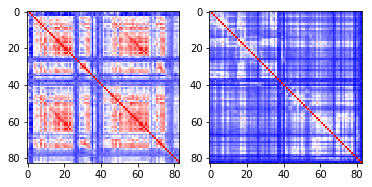

120 690152
121 150726
122 566454


<Figure size 432x288 with 0 Axes>

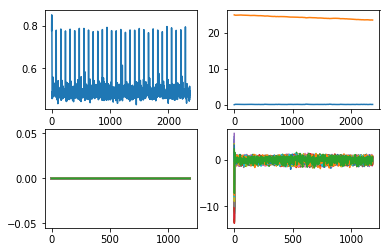

0.36027756211322604


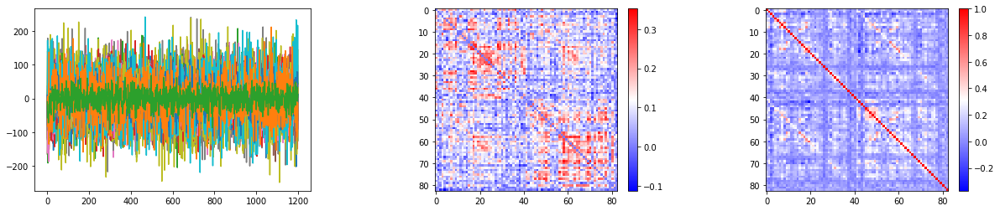

0.41165812799884033


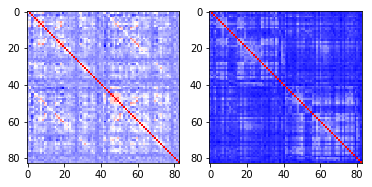

123 268850


<Figure size 432x288 with 0 Axes>

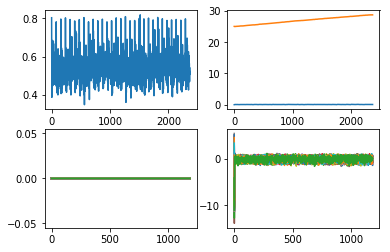

0.40680258941338365


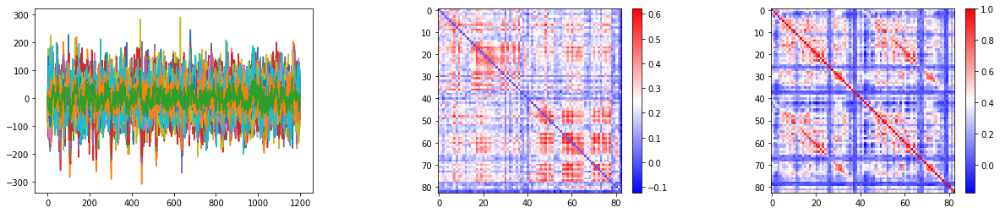

0.3677200885938451


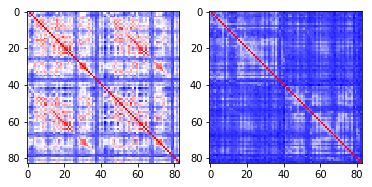

124 923755
125 479762
126 176037


<Figure size 432x288 with 0 Axes>

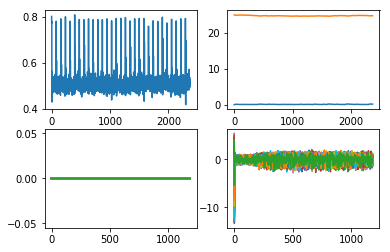

0.19798665625227316


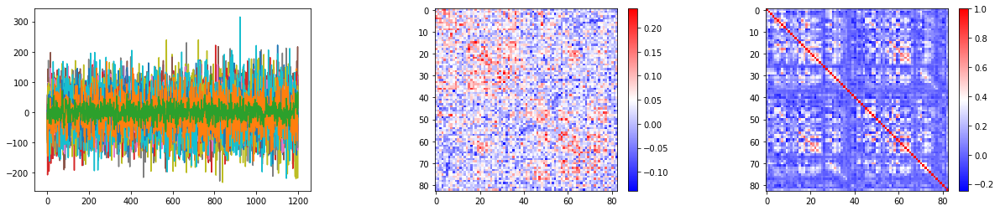

0.25610270633674054


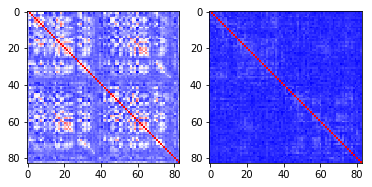

127 192439
128 693461
129 175237


<Figure size 432x288 with 0 Axes>

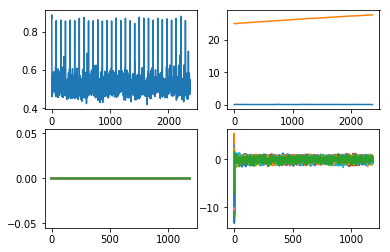

0.382787576628039


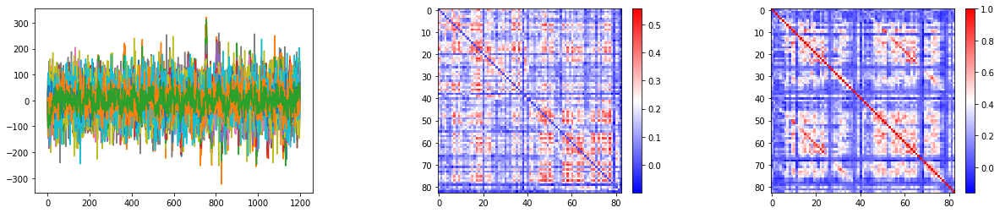

0.3927918651980388


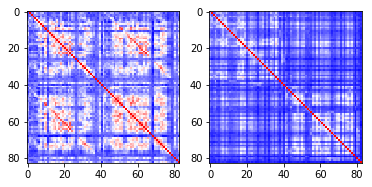

130 198249


<Figure size 432x288 with 0 Axes>

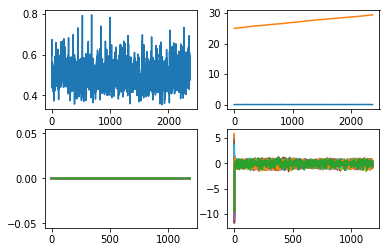

0.4731863082926753


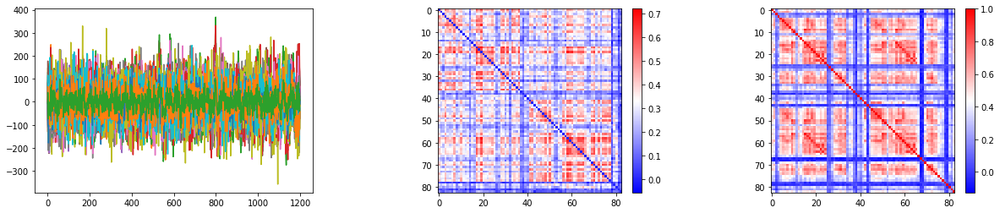

0.48192781679182006


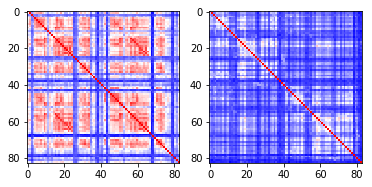

131 580650
132 176744


<Figure size 432x288 with 0 Axes>

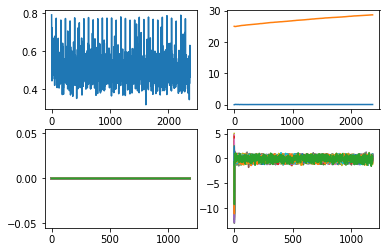

0.47196377250588817


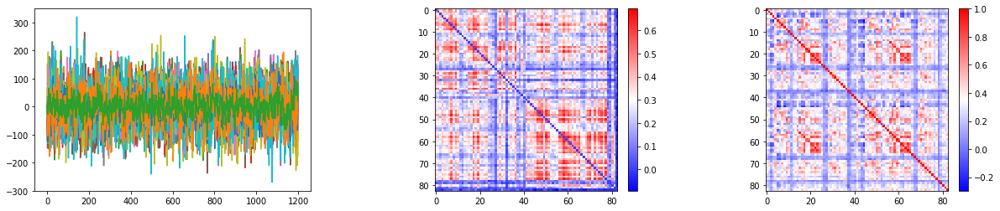

0.4758854599253209


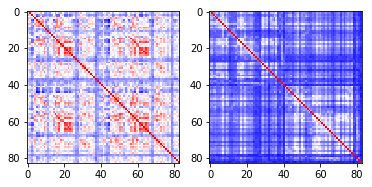

133 571144


<Figure size 432x288 with 0 Axes>

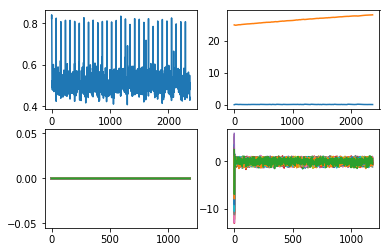

0.4423050913916458


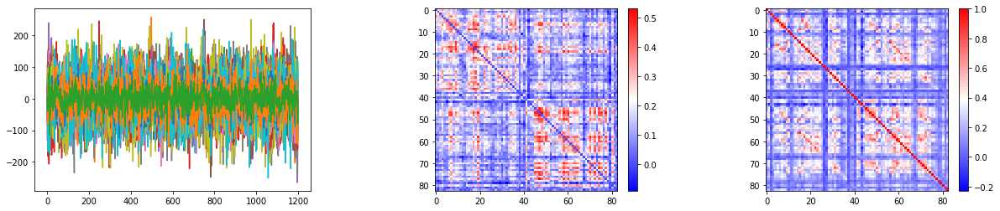

0.48561583851550905


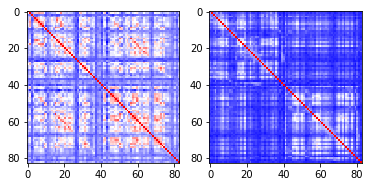

134 562345


<Figure size 432x288 with 0 Axes>

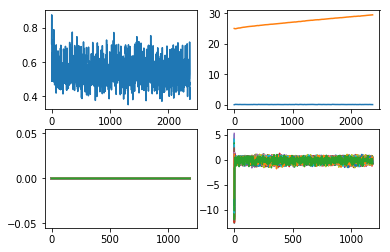

0.3699401529782286


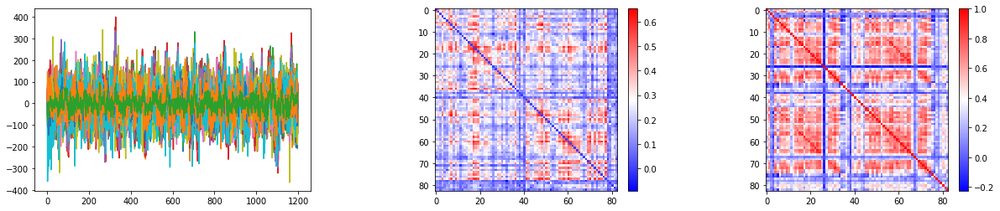

0.38193381525611075


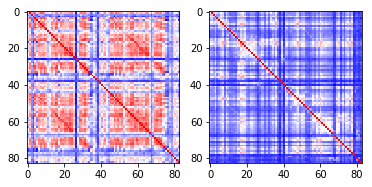

135 199453


<Figure size 432x288 with 0 Axes>

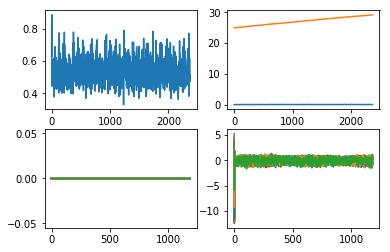

0.4302383598958444


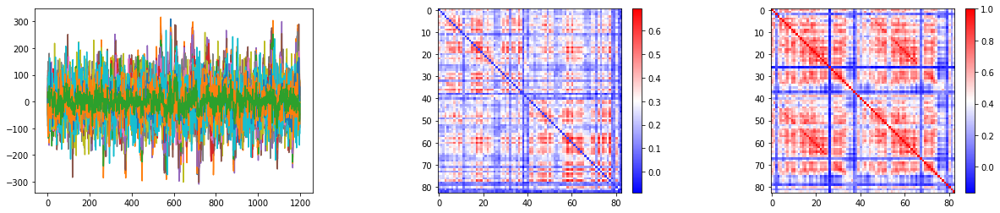

0.36840338233075604


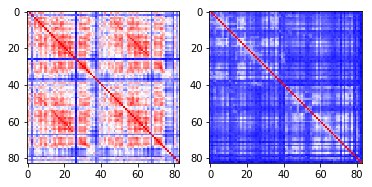

136 180836


<Figure size 432x288 with 0 Axes>

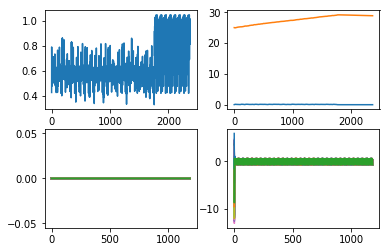

0.3190046655180775


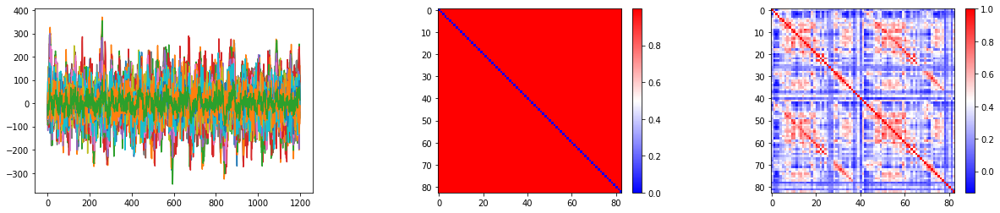

0.3052605744982689


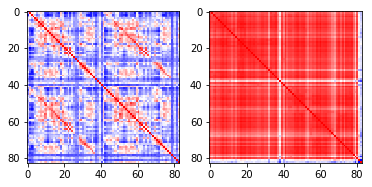

137 257845


<Figure size 432x288 with 0 Axes>

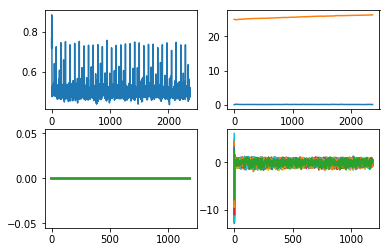

0.30185064207260126


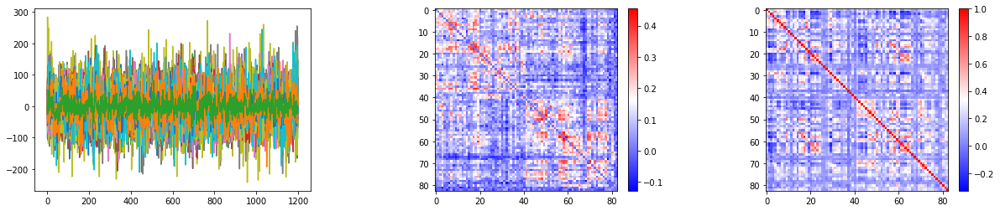

0.3237176421553048


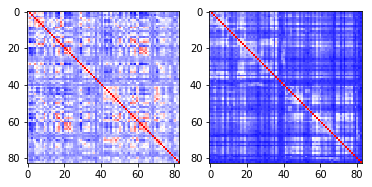

138 180735


<Figure size 432x288 with 0 Axes>

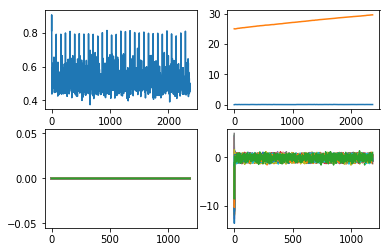

0.40878289150204483


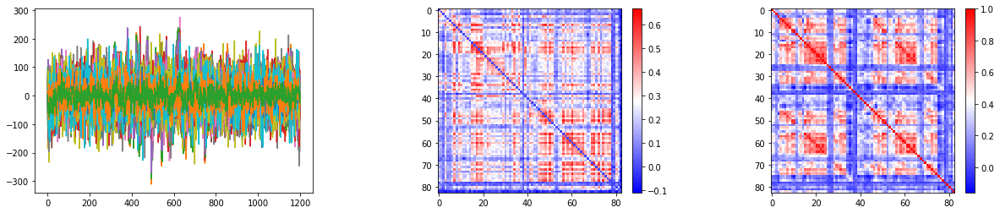

0.40247581285925377


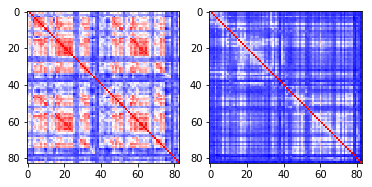

139 150524


<Figure size 432x288 with 0 Axes>

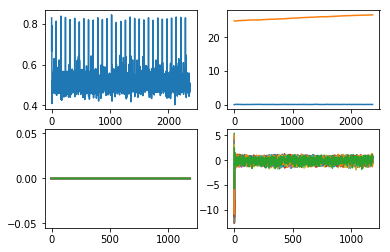

0.2817491222652331


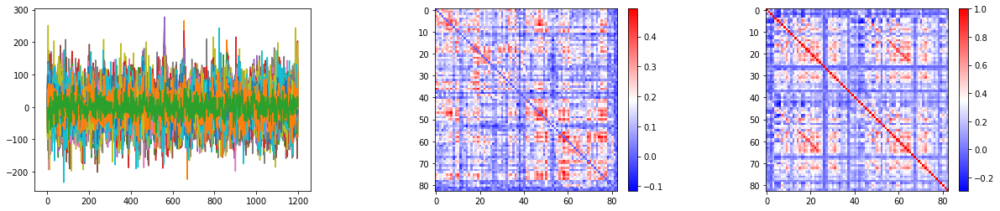

0.3277145578566319


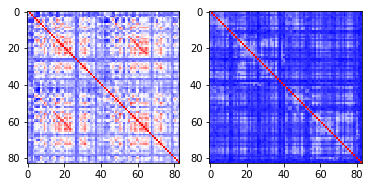

140 174437


<Figure size 432x288 with 0 Axes>

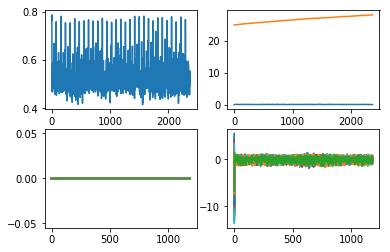

0.3068923933397061


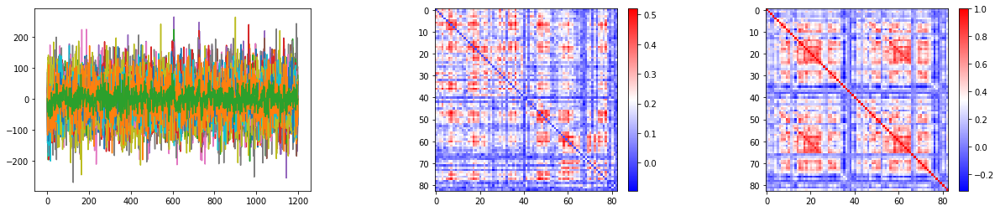

0.3014742870908544


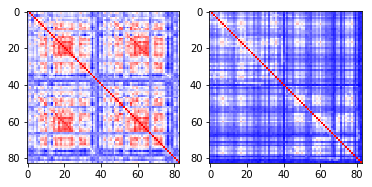

141 150625


<Figure size 432x288 with 0 Axes>

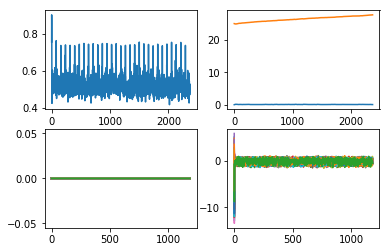

0.33028947702957123


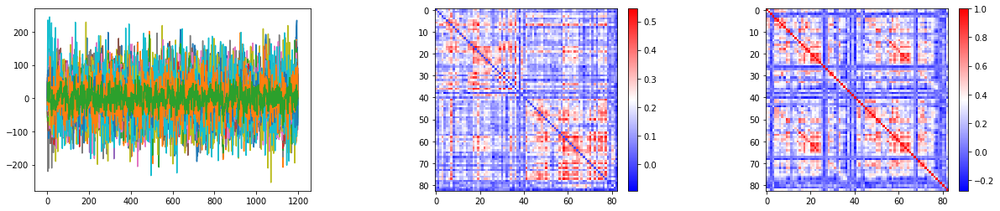

0.3853257390021107


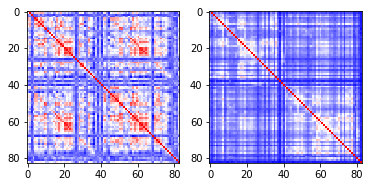

142 524135
143 172534


<Figure size 432x288 with 0 Axes>

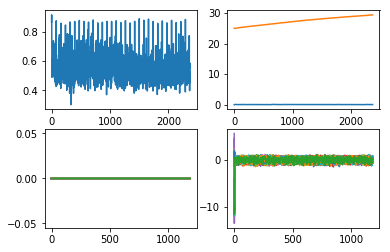

0.37216405812106534


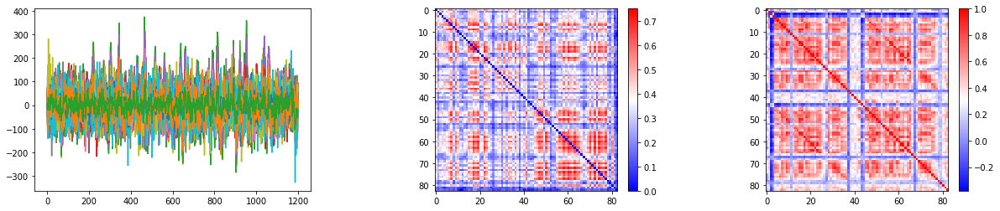

0.4010584396527355


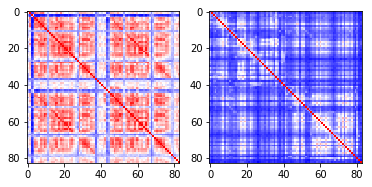

144 744553
145 506234
146 541943


<Figure size 432x288 with 0 Axes>

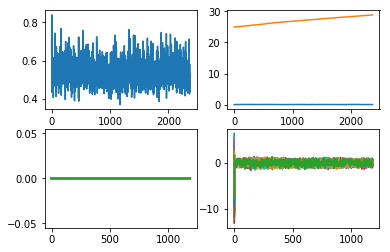

0.35928547972512814


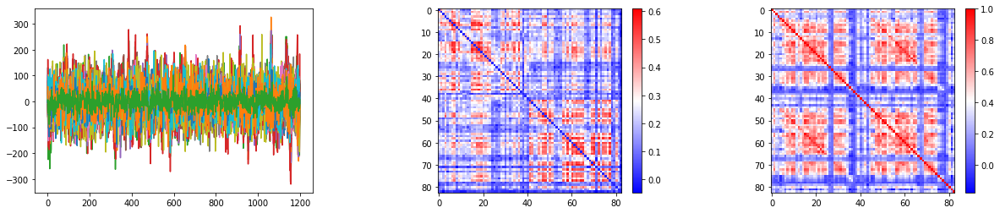

0.40210021158289705


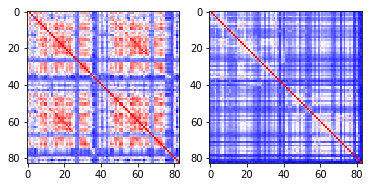

147 287248


<Figure size 432x288 with 0 Axes>

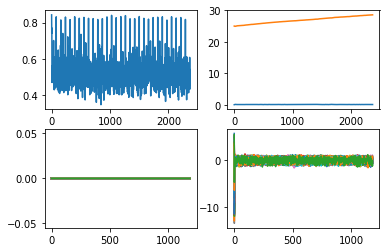

0.45707187794670157


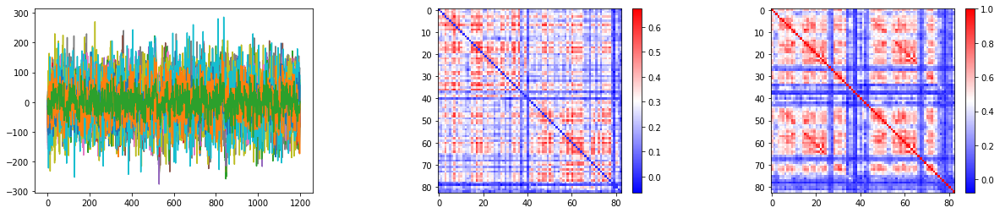

0.4621883049298992


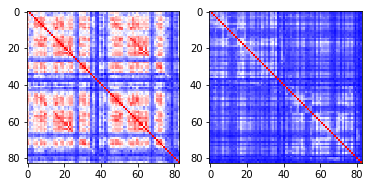

148 207426
149 657659
150 826353
151 644044
152 158540


<Figure size 432x288 with 0 Axes>

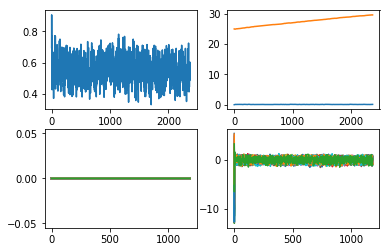

0.46591658594441504


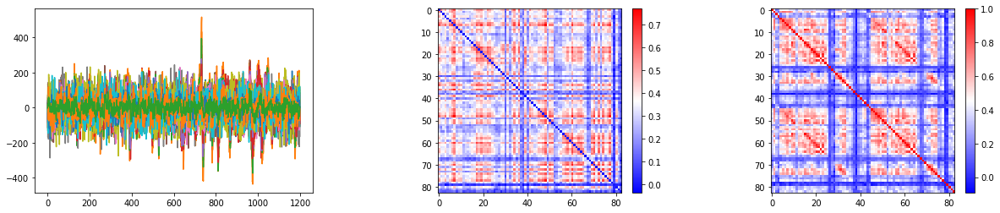

0.402348375619636


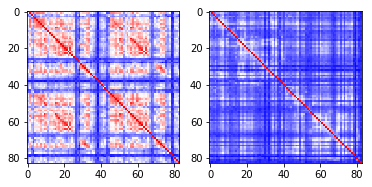

153 182032


<Figure size 432x288 with 0 Axes>

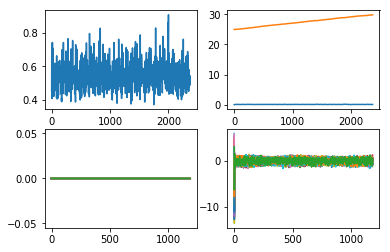

0.3618114236193904


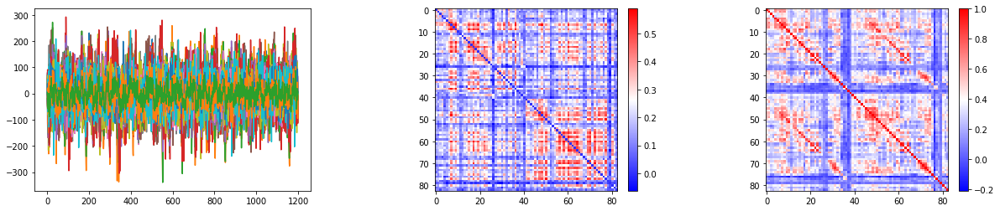

0.3466353819574263


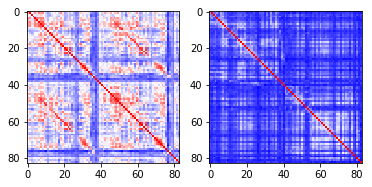

154 100206
155 217429
156 185846
157 173839


<Figure size 432x288 with 0 Axes>

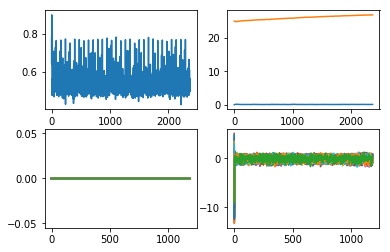

0.297568840609621


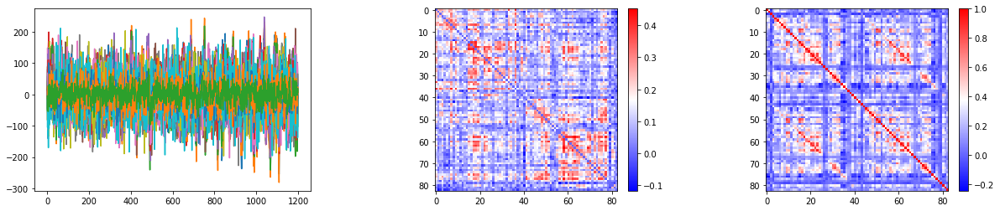

0.3017706146878782


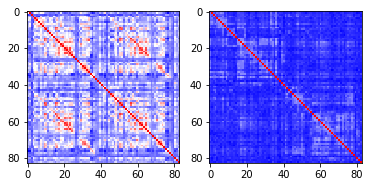

158 887373
159 549757


<Figure size 432x288 with 0 Axes>

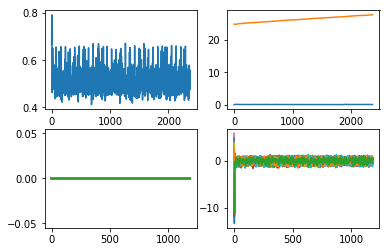

0.41700858608638347


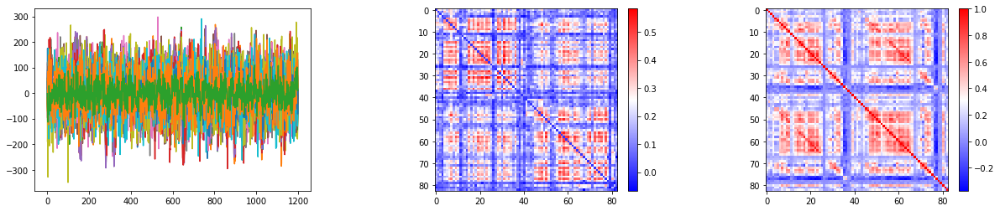

0.3977273561722118


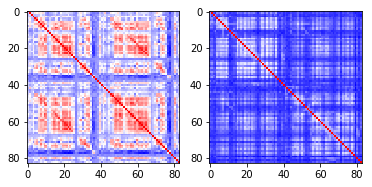

160 275645


<Figure size 432x288 with 0 Axes>

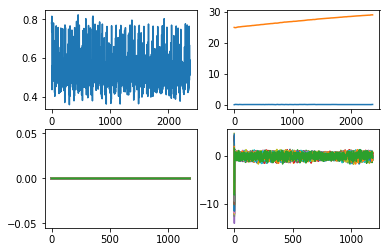

0.4632368644693027


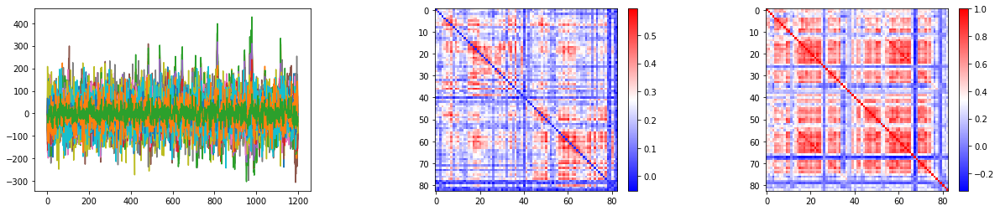

0.38029252737188124


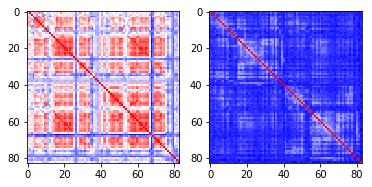

161 154734
162 545345


<Figure size 432x288 with 0 Axes>

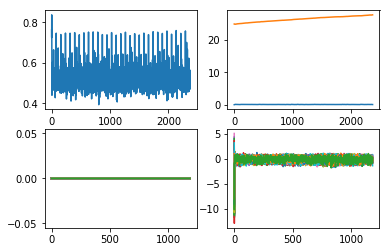

0.3991663415203621


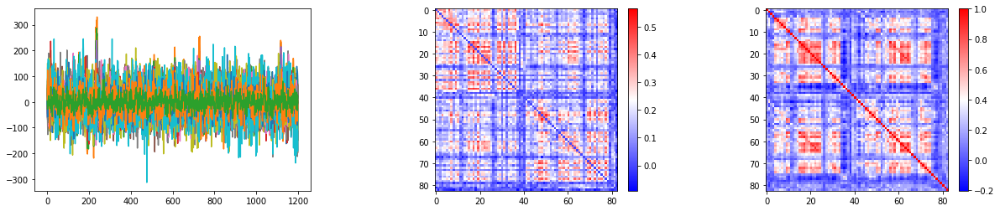

0.38402288282239716


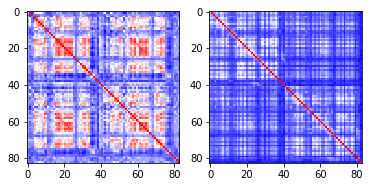

163 991267
164 158035


<Figure size 432x288 with 0 Axes>

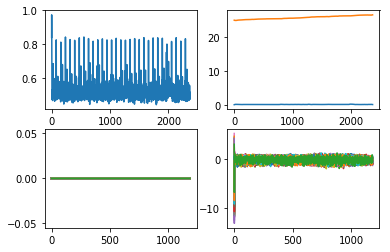

0.27261809388767666


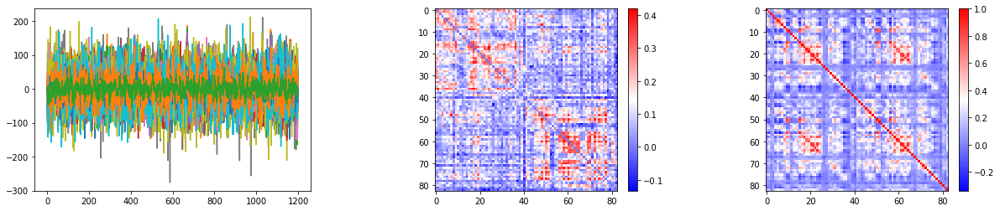

0.3181493161545589


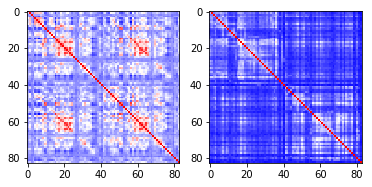

165 353740
166 175338
167 195647
168 316633


<Figure size 432x288 with 0 Axes>

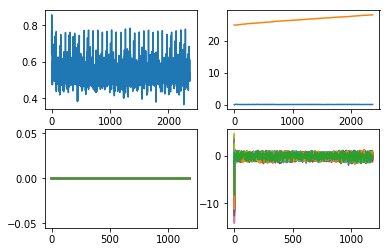

0.3753303197587997


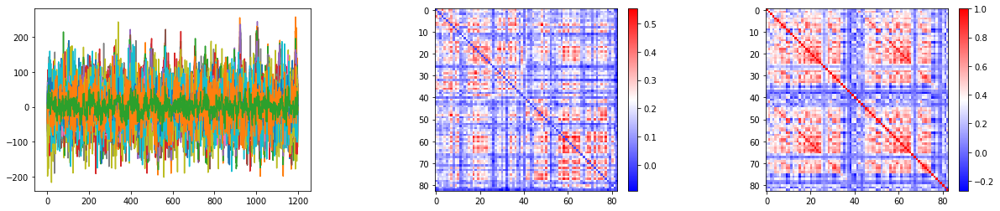

0.3455651471916471


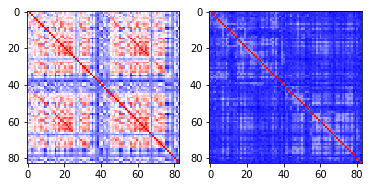

169 150019
170 285345


<Figure size 432x288 with 0 Axes>

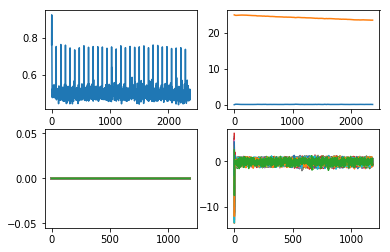

0.33346033270334813


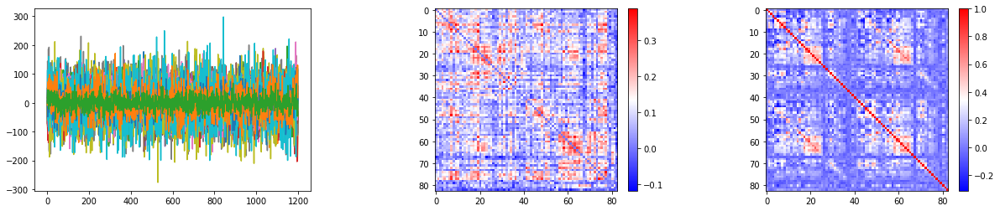

0.3677917828786957


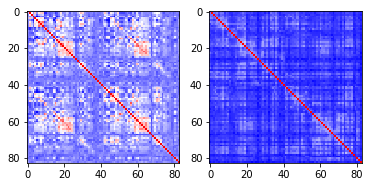

171 199958


<Figure size 432x288 with 0 Axes>

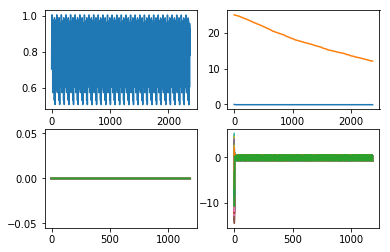

0.3468118659437522


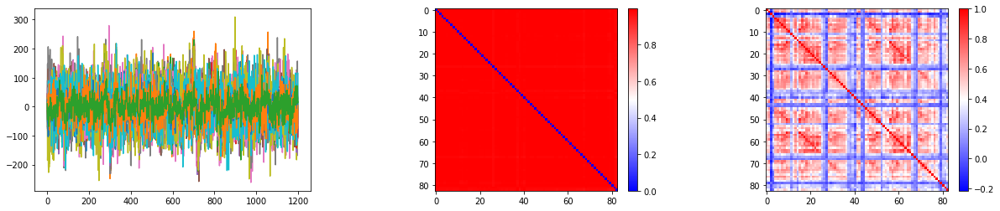

0.38668007582445846


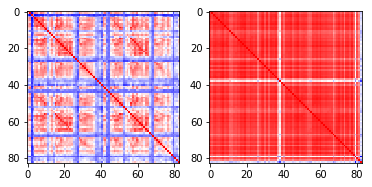

172 153429


<Figure size 432x288 with 0 Axes>

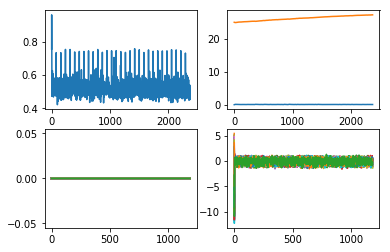

0.42173052570271274


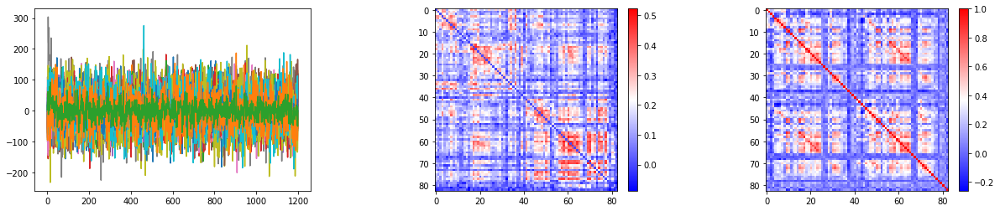

0.4430970841861087


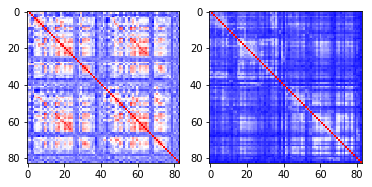

173 182436


<Figure size 432x288 with 0 Axes>

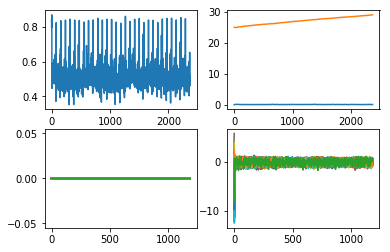

0.5741793255451199


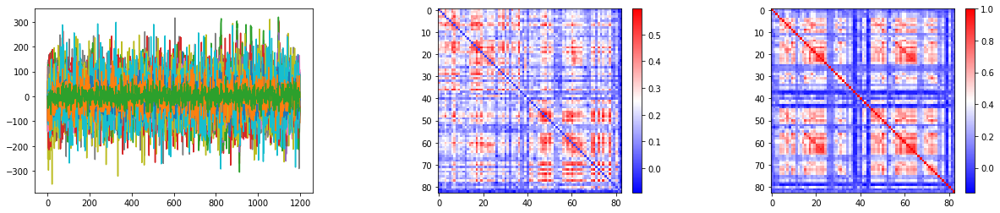

0.5543011882805029


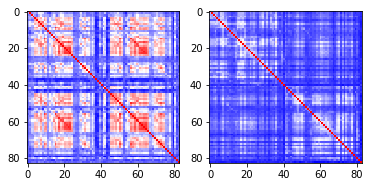

174 572045


<Figure size 432x288 with 0 Axes>

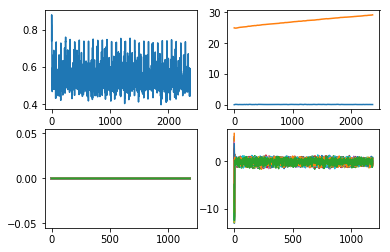

0.35900482606408957


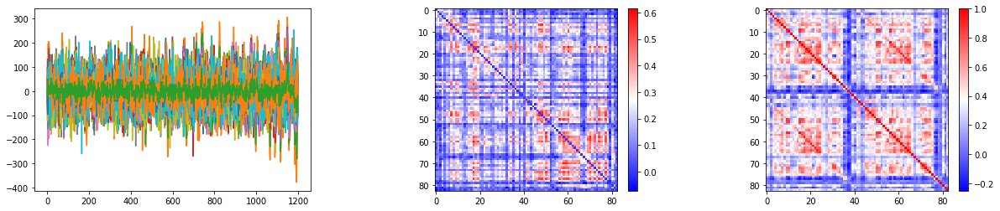

0.4207704388923545


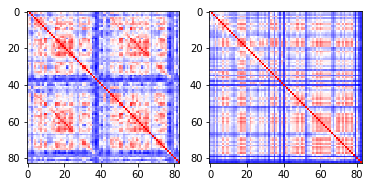

175 130922
176 268749
177 456346


<Figure size 432x288 with 0 Axes>

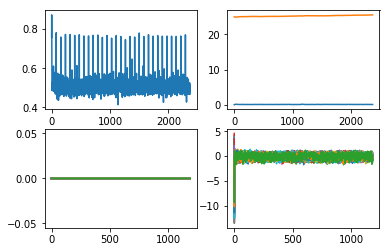

0.4050370626415906


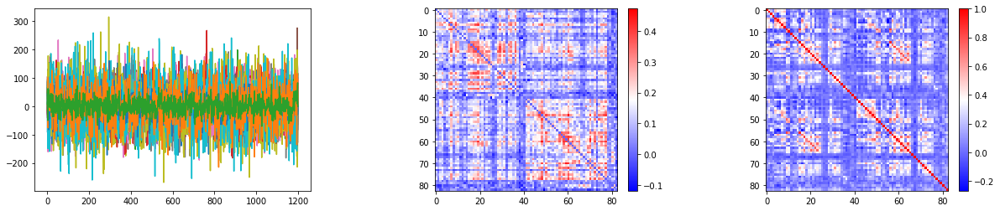

0.3985596501055251


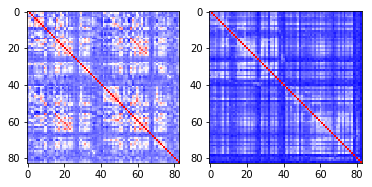

178 555348


<Figure size 432x288 with 0 Axes>

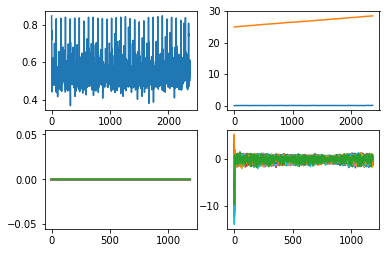

0.3357750276486831


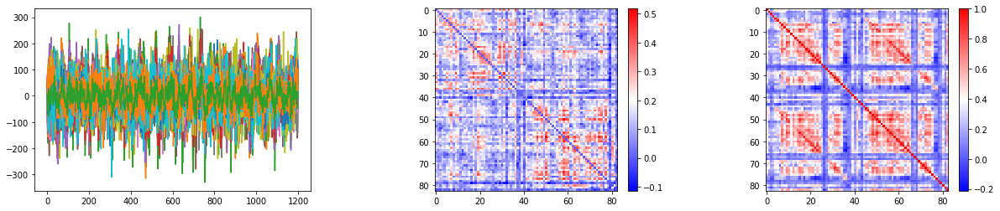

0.2580593115743817


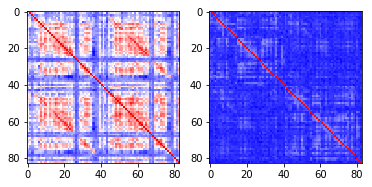

179 724446
180 280739


<Figure size 432x288 with 0 Axes>

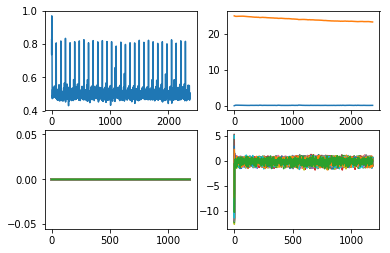

0.2499839988888389


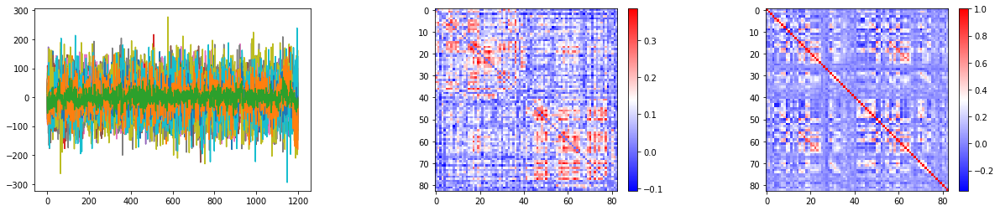

0.2503996985139001


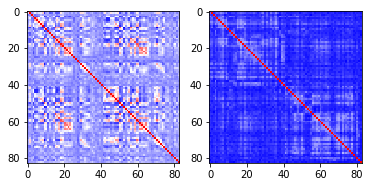

181 153732


<Figure size 432x288 with 0 Axes>

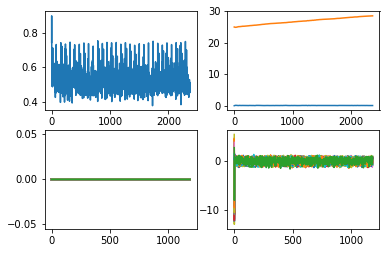

0.49045075176081504


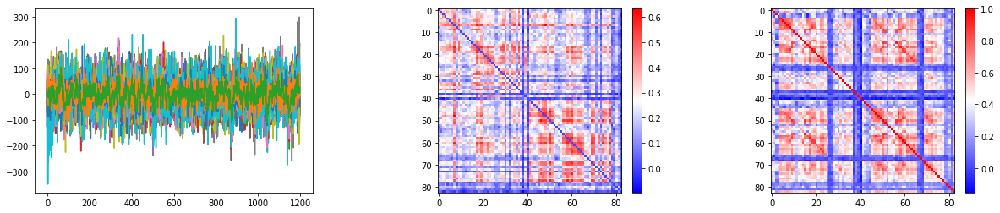

0.5113971115292429


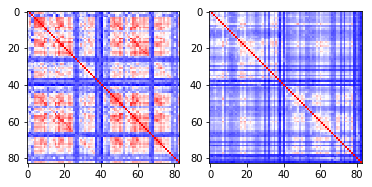

182 198855


<Figure size 432x288 with 0 Axes>

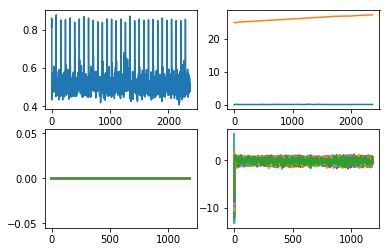

0.3458804358208369


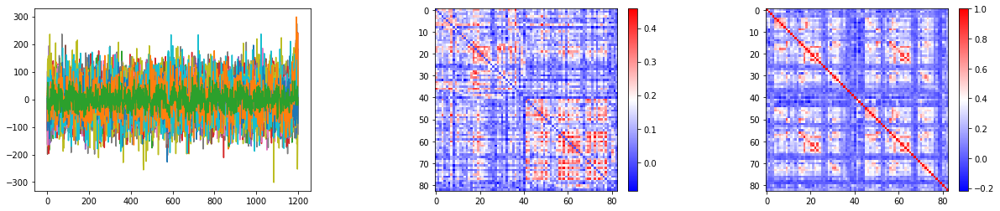

0.36767922368529316


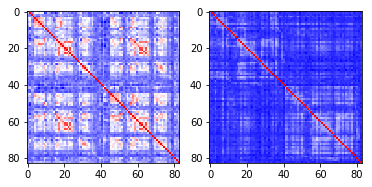

183 540436


<Figure size 432x288 with 0 Axes>

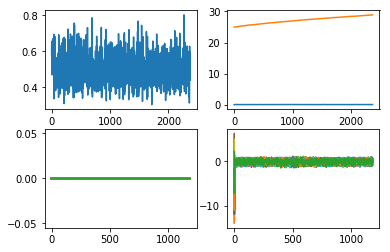

0.463685742217653


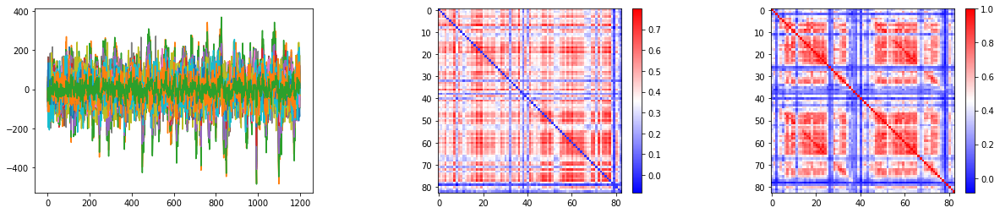

0.46392175857544776


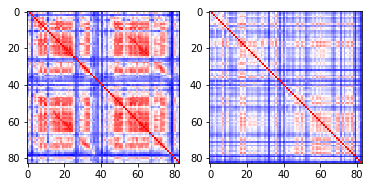

184 173435


<Figure size 432x288 with 0 Axes>

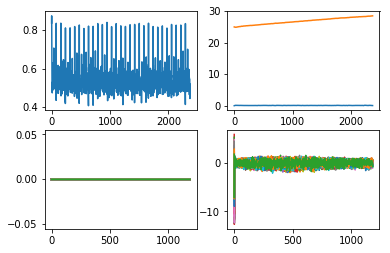

0.40436362291218125


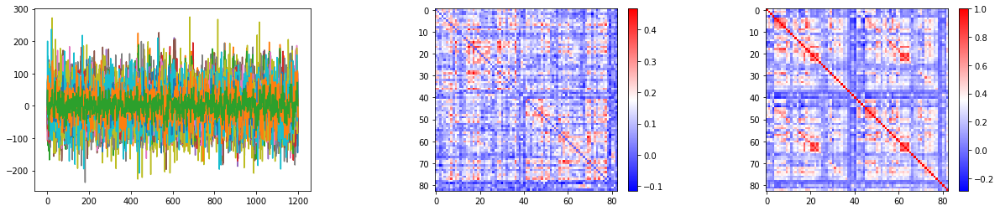

0.46531969673073764


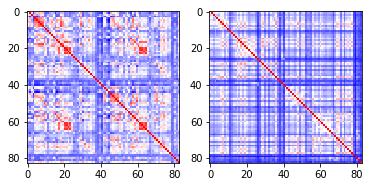

185 233326
186 580044


<Figure size 432x288 with 0 Axes>

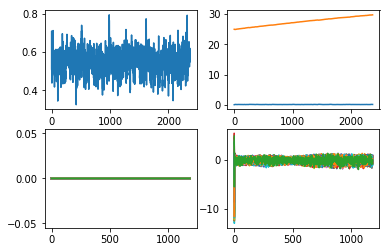

0.3545817318051931


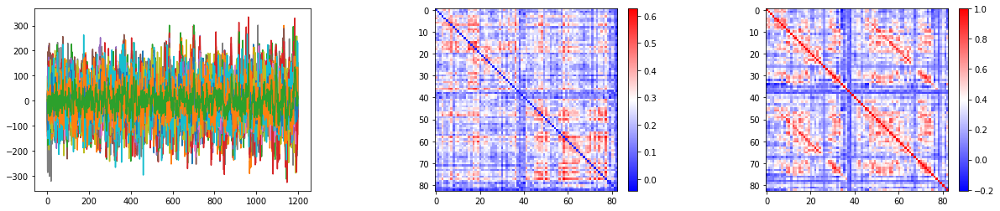

0.30832723432632164


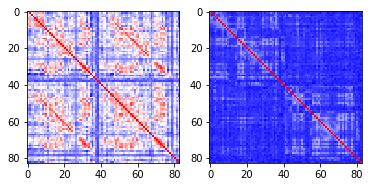

187 351938
188 523032


<Figure size 432x288 with 0 Axes>

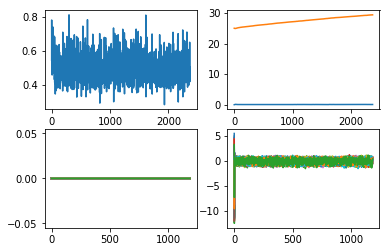

0.5931087087212762


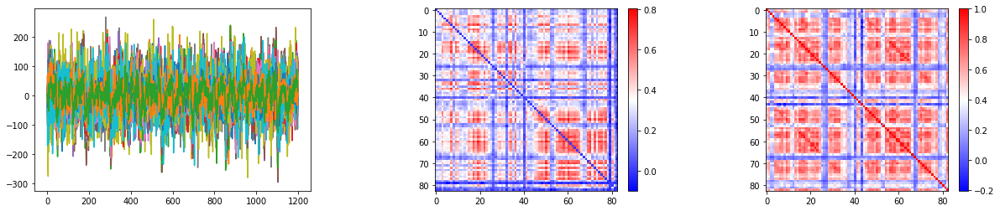

0.5763442829129262


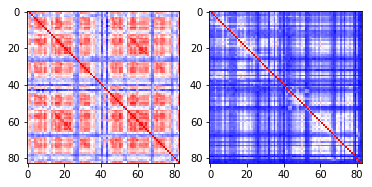

189 856968
190 177645


<Figure size 432x288 with 0 Axes>

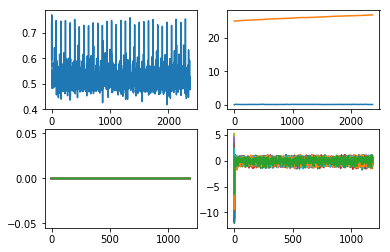

0.2757177116695615


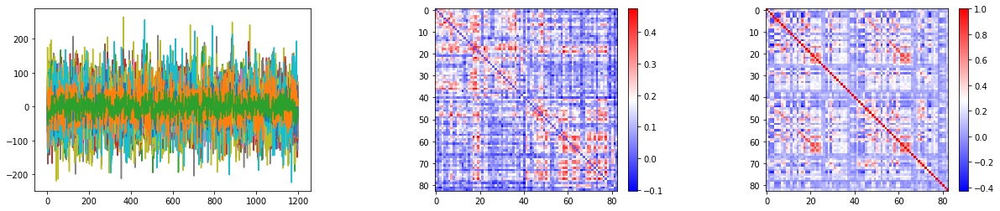

0.30647016601404786


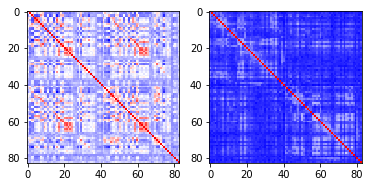

191 162228
192 263436


<Figure size 432x288 with 0 Axes>

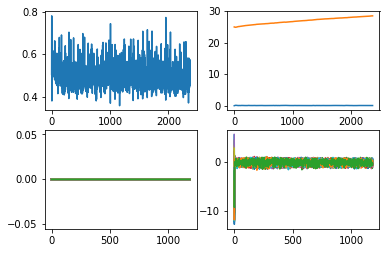

0.3680220513079969


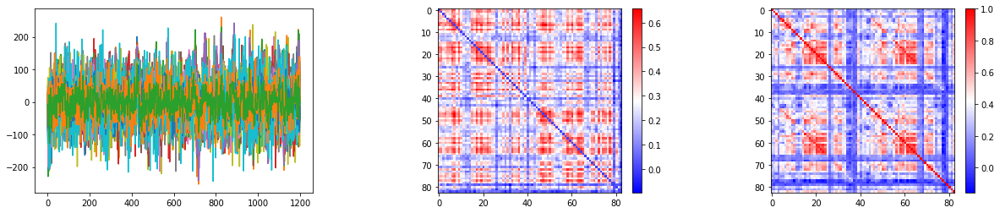

0.37976119770415023


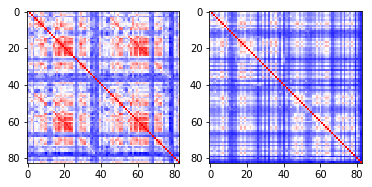

193 927359
194 896879
195 901139
196 154431


<Figure size 432x288 with 0 Axes>

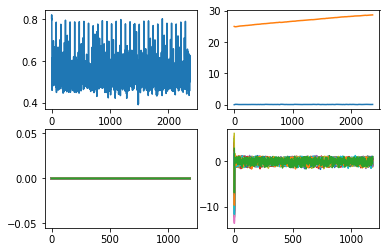

0.4056486552648951


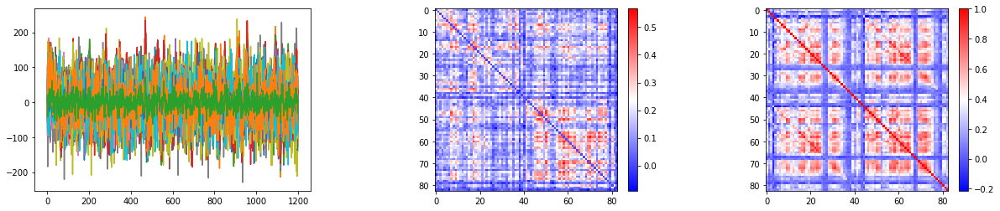

0.3841848858021003


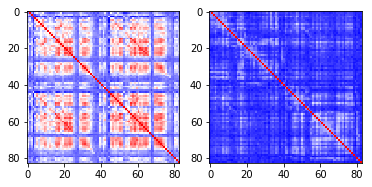

197 475855


<Figure size 432x288 with 0 Axes>

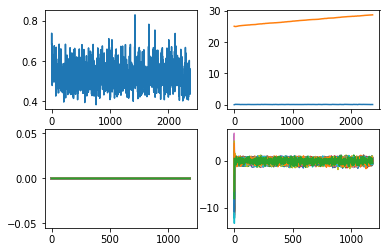

0.3608555614875137


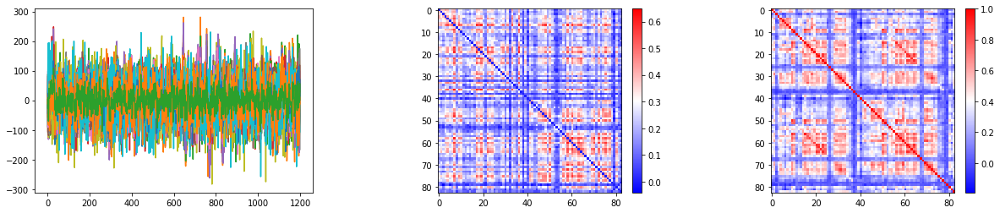

0.39318372691325976


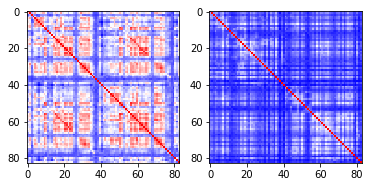

198 530635


<Figure size 432x288 with 0 Axes>

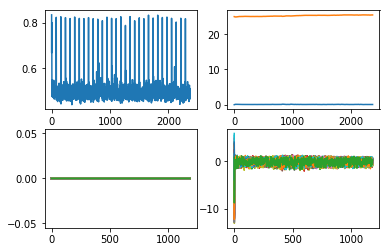

0.4430927358736027


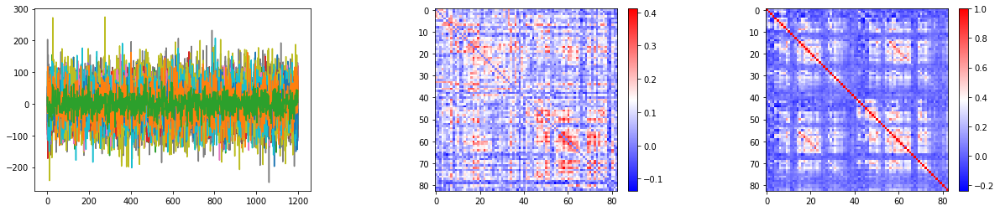

0.5166603039970719


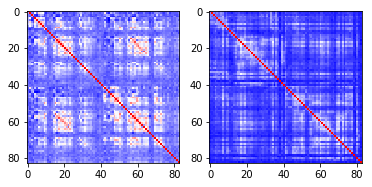

199 843151
200 175439


<Figure size 432x288 with 0 Axes>

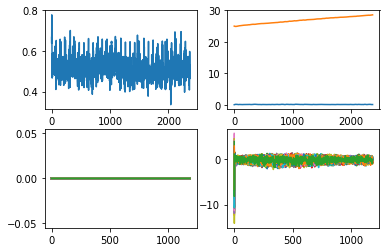

0.43055731941121606


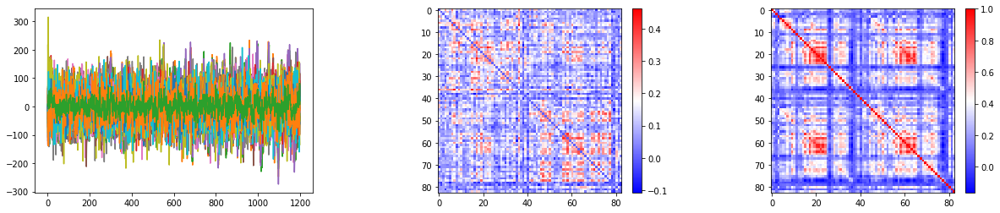

0.48226930295040427


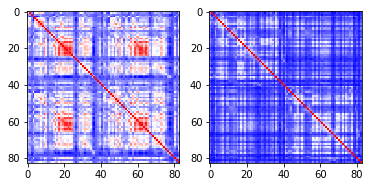

201 144125
202 510326


<Figure size 432x288 with 0 Axes>

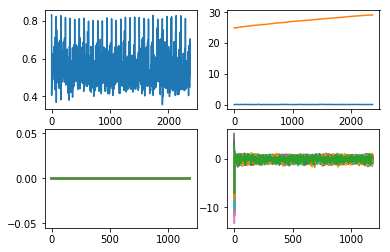

0.2988712384896374


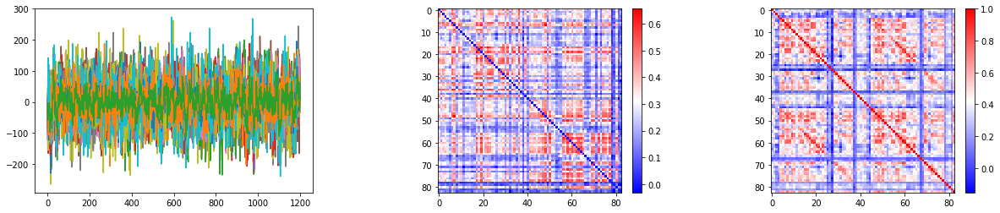

0.3029650062162276


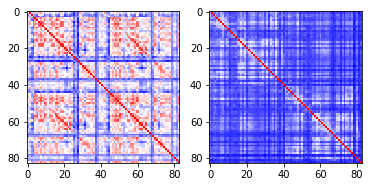

203 293748


<Figure size 432x288 with 0 Axes>

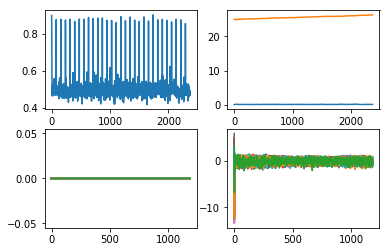

0.36071746251875353


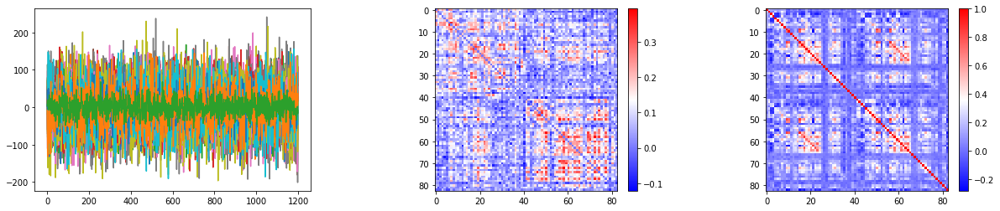

0.38102983184118067


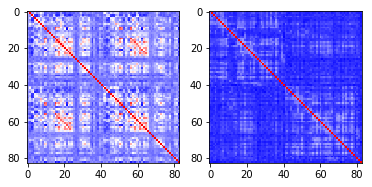

204 148436
205 128935
206 459453


<Figure size 432x288 with 0 Axes>

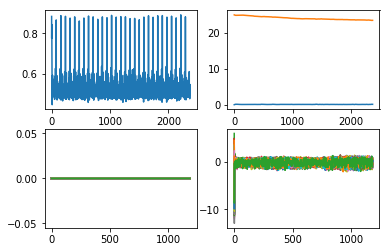

0.21118896762040978


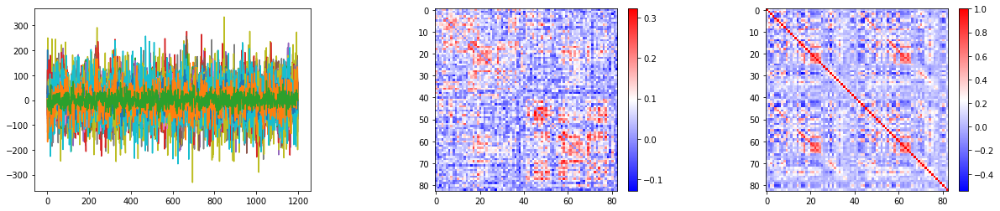

0.2563243815995537


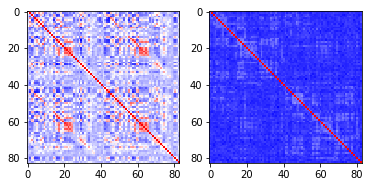

207 485757


<Figure size 432x288 with 0 Axes>

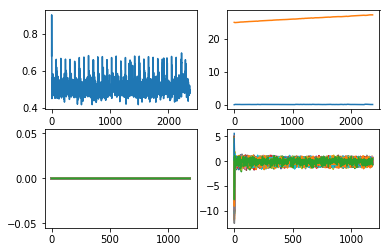

0.4019629510027905


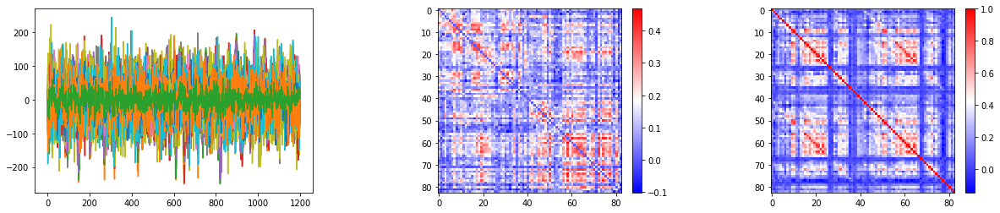

0.4585930545349684


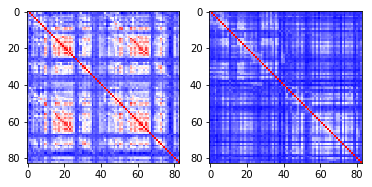

208 304020


<Figure size 432x288 with 0 Axes>

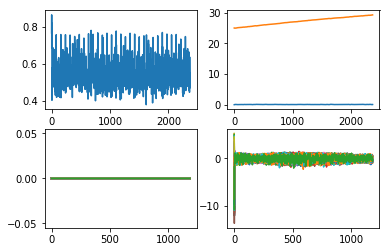

0.3688730330646955


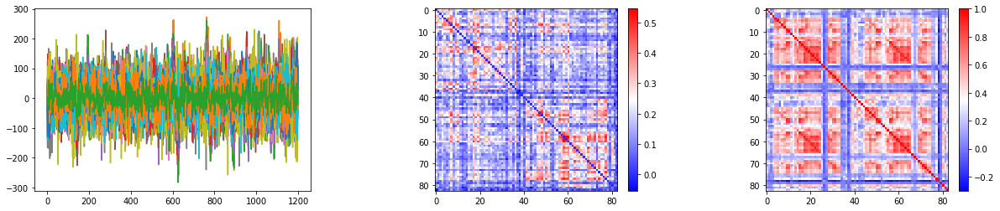

0.3915380477437361


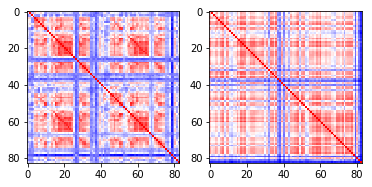

209 142828
210 209834
211 378857
212 522434


<Figure size 432x288 with 0 Axes>

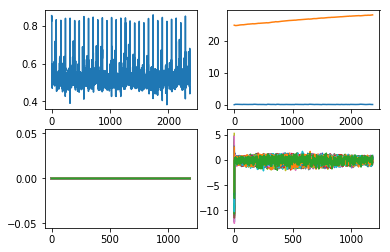

0.2414874047022719


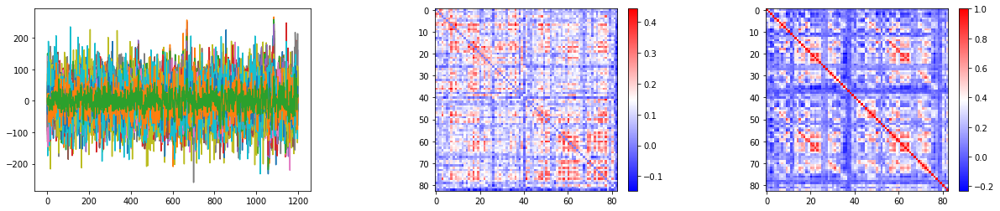

0.2568783795591106


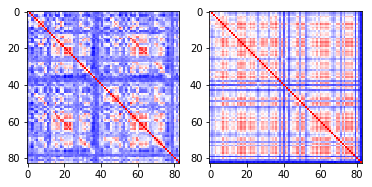

213 151425


<Figure size 432x288 with 0 Axes>

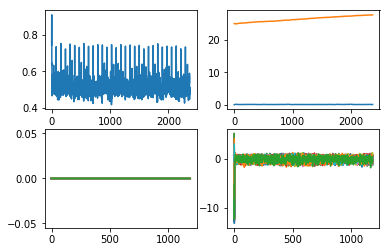

0.3778267777248296


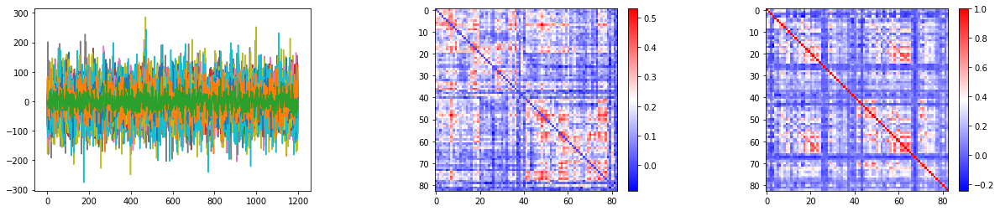

0.39121971163343744


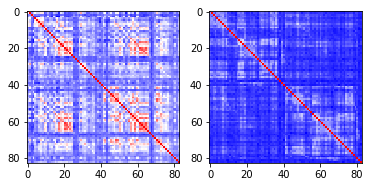

214 180937
215 580751
216 289555


<Figure size 432x288 with 0 Axes>

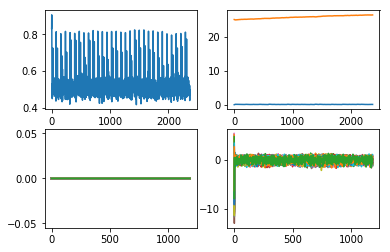

0.40366023173006726


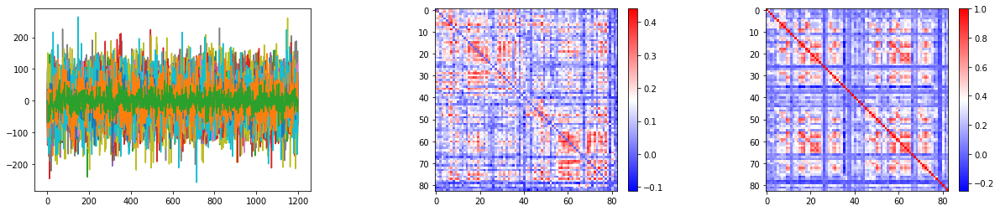

0.4914295701590591


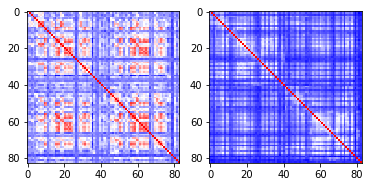

217 175742


<Figure size 432x288 with 0 Axes>

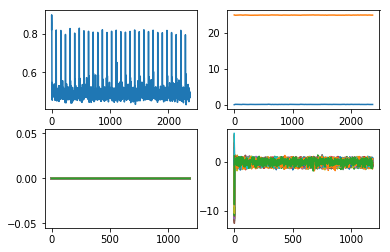

0.3373813297972317


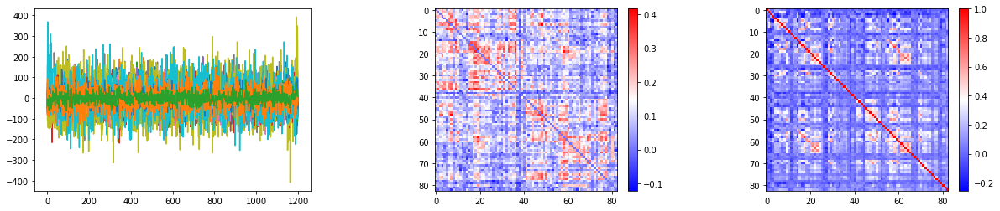

0.3942551174036396


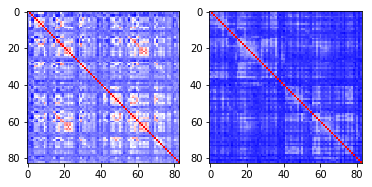

218 308331


<Figure size 432x288 with 0 Axes>

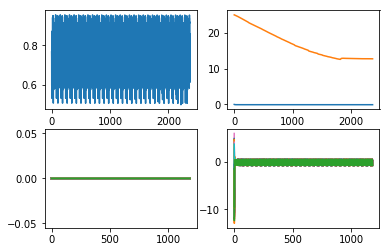

0.07450648157747024


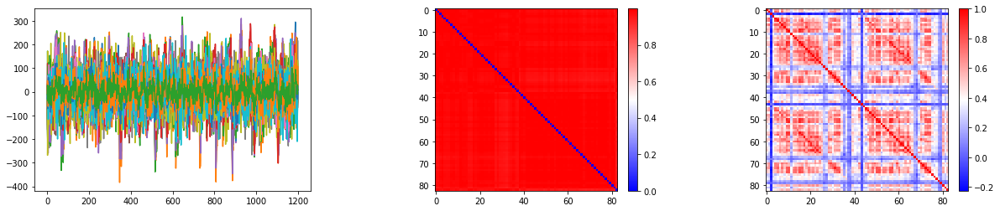

0.4407210540390793


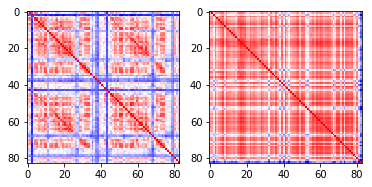

219 187850
220 912447
221 513736


<Figure size 432x288 with 0 Axes>

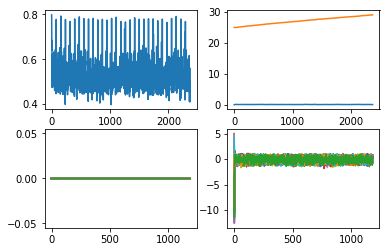

0.4045397532956702


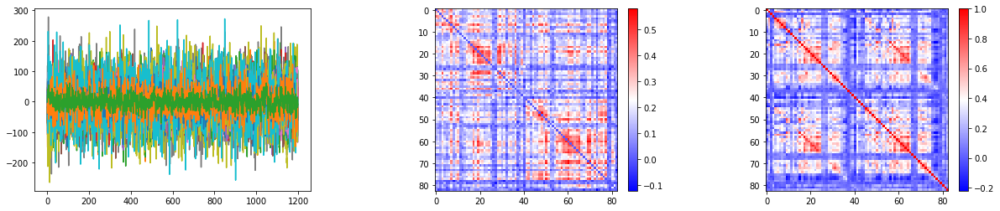

0.45756111520871146


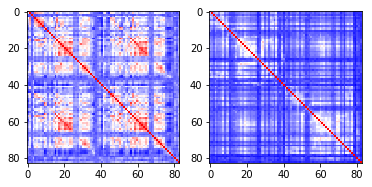

222 441939


<Figure size 432x288 with 0 Axes>

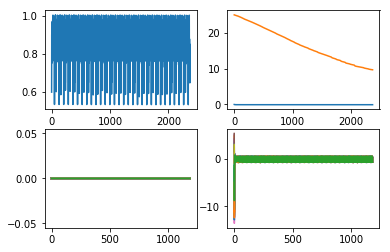

0.24142890320360375


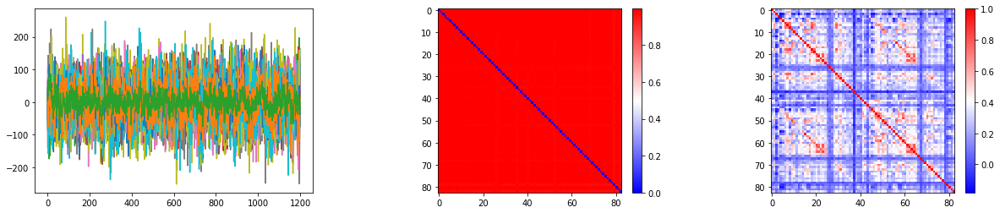

0.42056772511097407


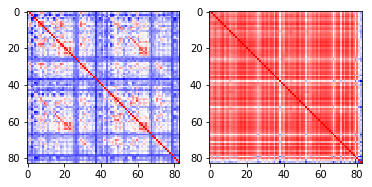

223 158136


<Figure size 432x288 with 0 Axes>

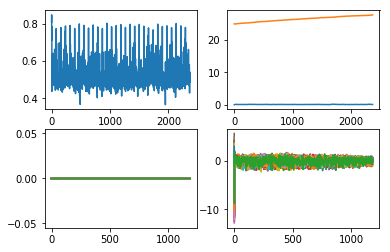

0.3652600068862232


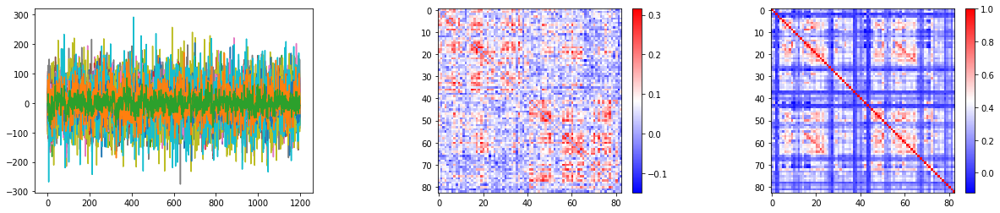

0.4858839157597861


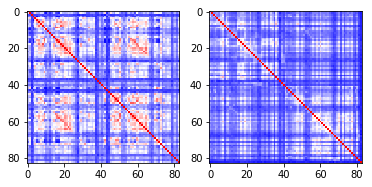

224 497865


<Figure size 432x288 with 0 Axes>

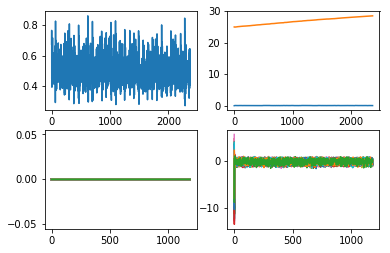

0.47807577053621814


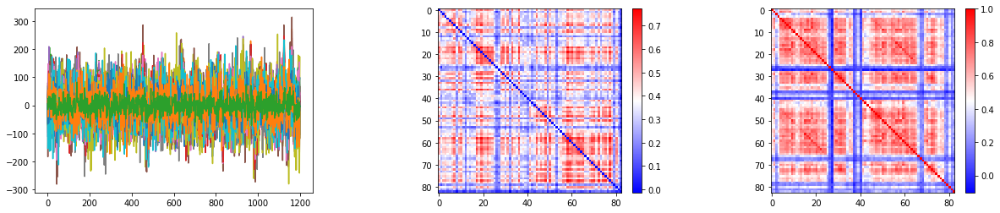

0.49427621102716474


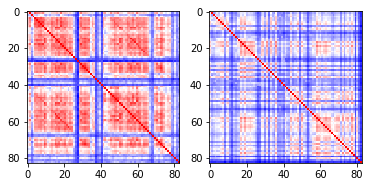

225 124826
226 134829
227 197348


<Figure size 432x288 with 0 Axes>

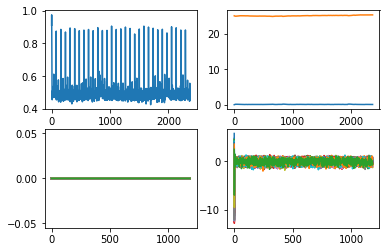

0.4567230513288042


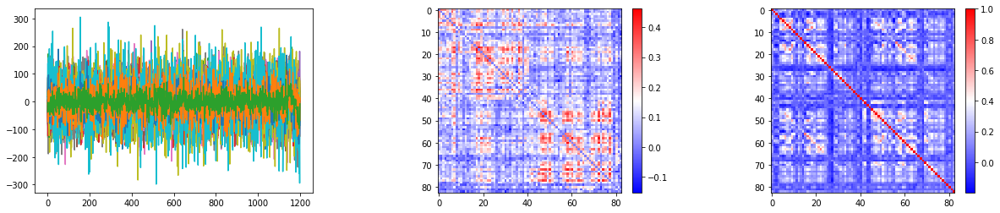

0.44562574539194644


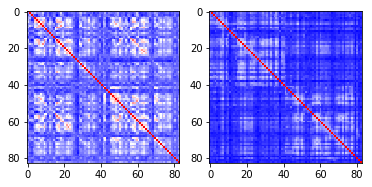

228 194847
229 172433


<Figure size 432x288 with 0 Axes>

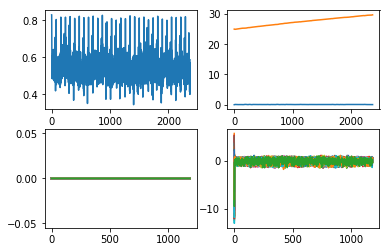

0.3530368272873896


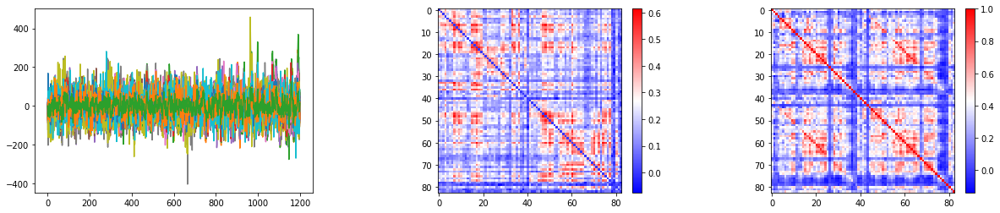

0.3547414174642009


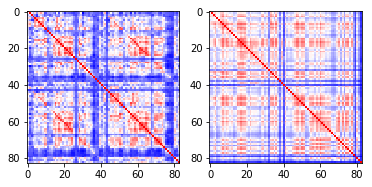

230 214524
231 320826


<Figure size 432x288 with 0 Axes>

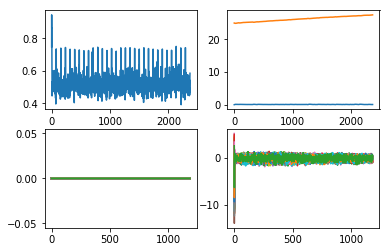

0.3700170944048519


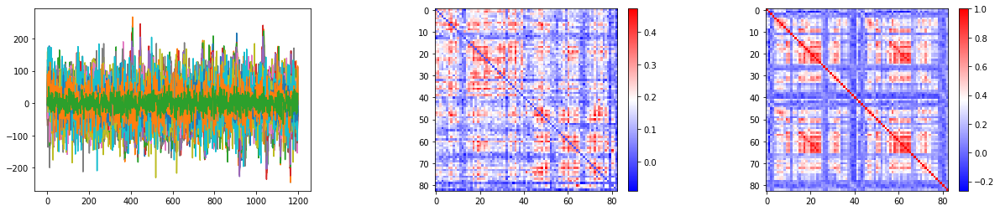

0.43176412949003423


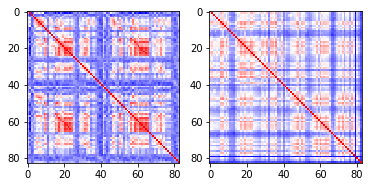

232 310621


<Figure size 432x288 with 0 Axes>

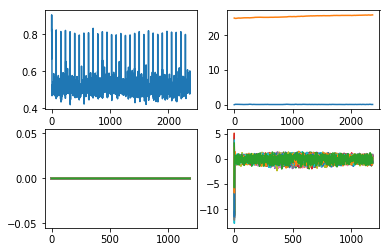

0.27042557770775794


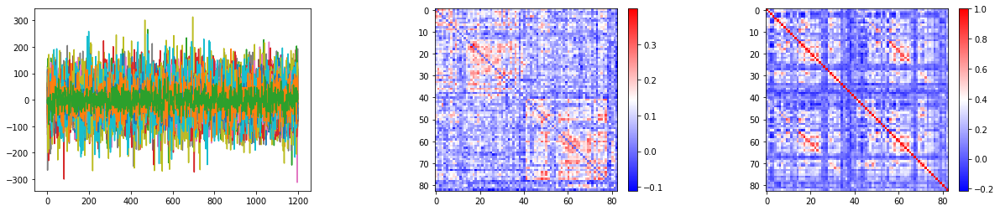

0.3365094858573483


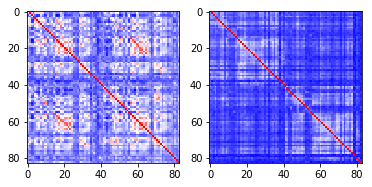

233 173334


<Figure size 432x288 with 0 Axes>

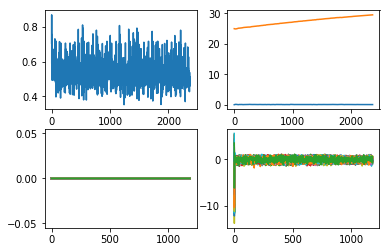

0.2946033709147532


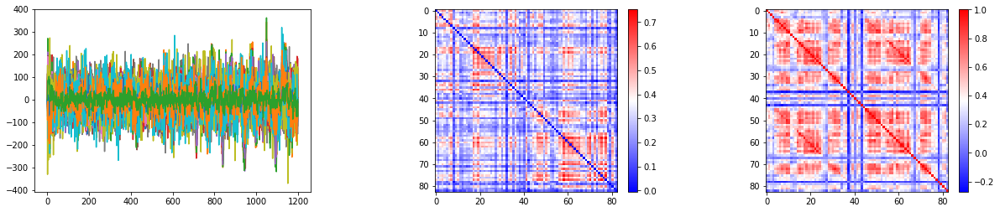

0.3147722339863825


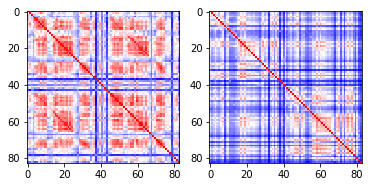

234 284646


<Figure size 432x288 with 0 Axes>

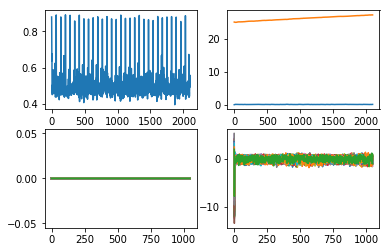

0.4278655188466333


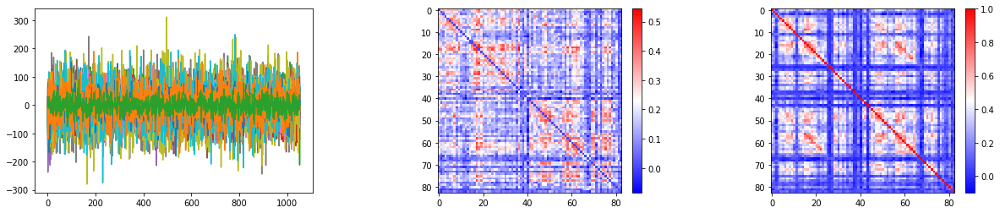

0.41091004910632645


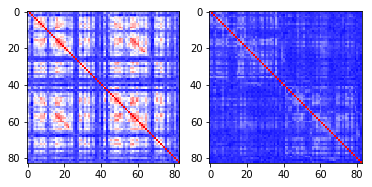

235 155635


<Figure size 432x288 with 0 Axes>

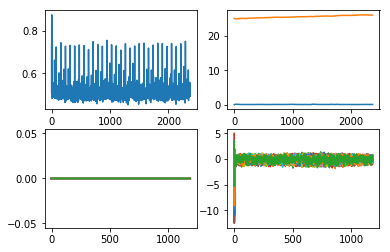

0.31211915650064853


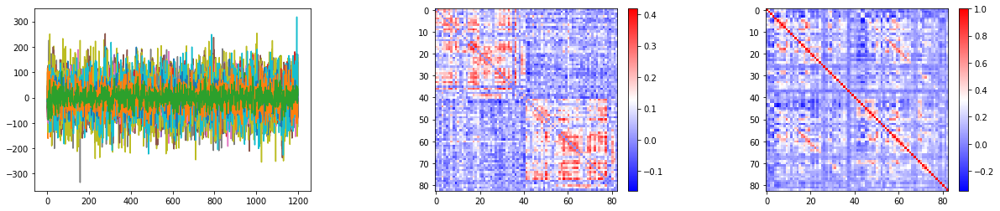

0.33271199051201356


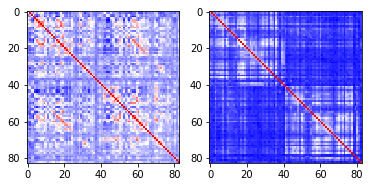

236 152831
237 156031


<Figure size 432x288 with 0 Axes>

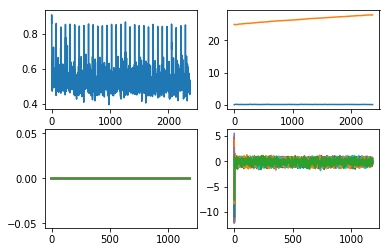

0.4199274964173481


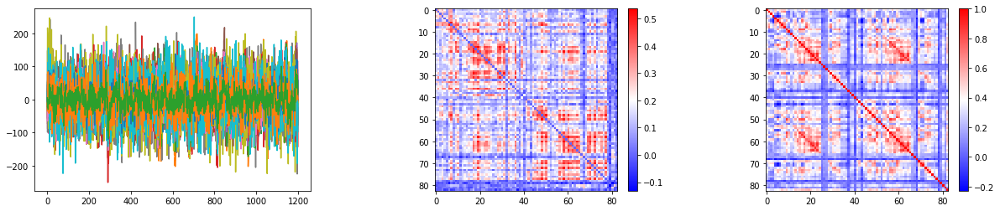

0.44720617898635984


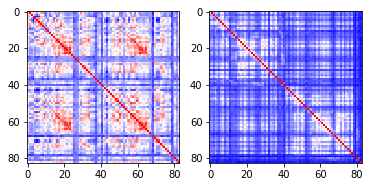

238 153227


<Figure size 432x288 with 0 Axes>

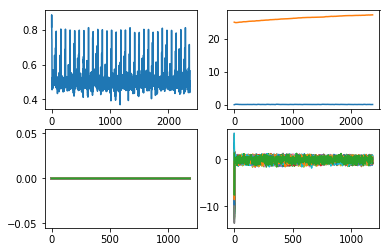

0.46961412489806825


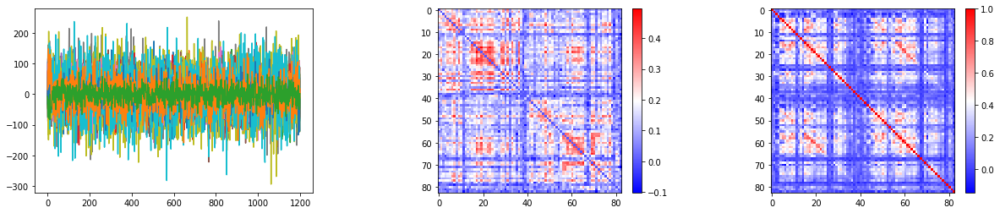

0.5108101743490909


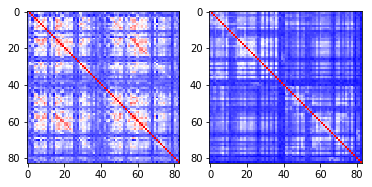

239 176239


<Figure size 432x288 with 0 Axes>

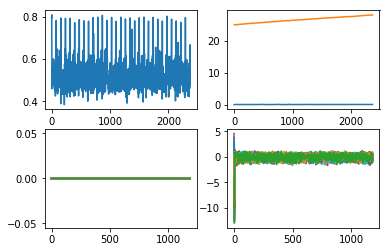

0.4446359071777609


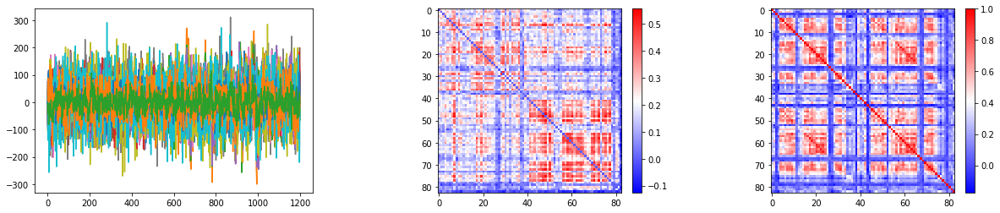

0.4508836060683393


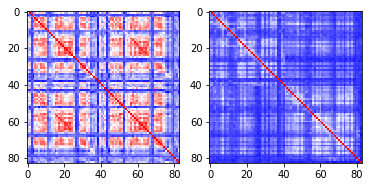

240 160931
241 159946
242 154835


<Figure size 432x288 with 0 Axes>

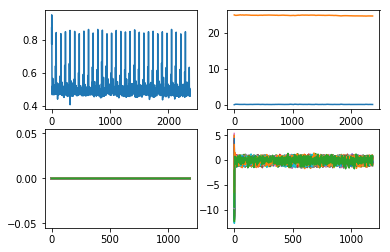

0.42940893812142283


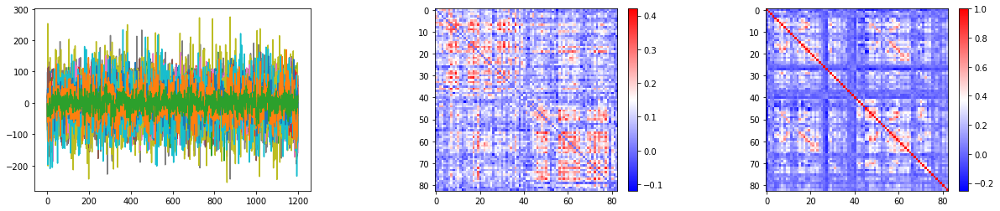

0.5077549098421906


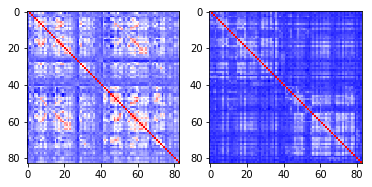

243 157437


<Figure size 432x288 with 0 Axes>

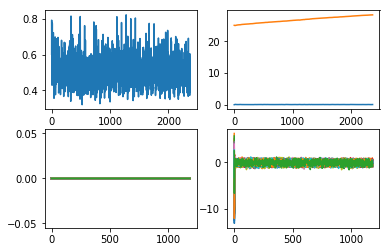

0.4606387993090762


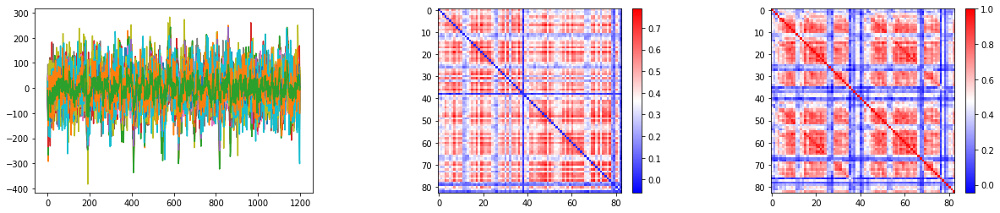

0.45879739858535473


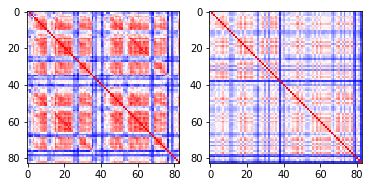

244 467351


<Figure size 432x288 with 0 Axes>

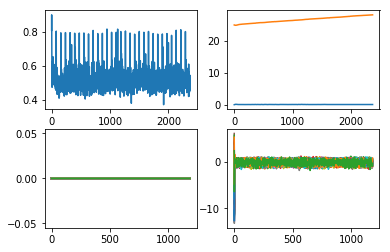

0.32930254108241314


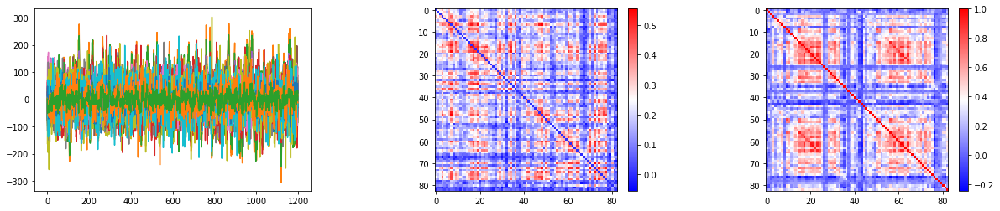

0.40562334356614577


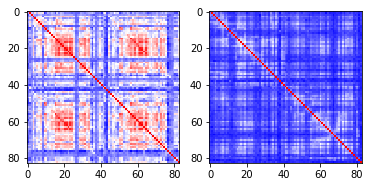

245 183034
246 567052
247 172029
248 149741


<Figure size 432x288 with 0 Axes>

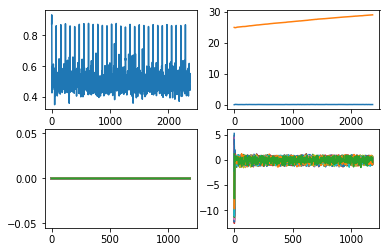

0.3909293983022519


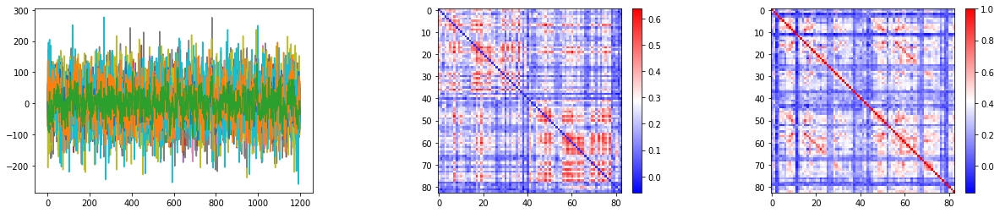

0.39418461936122595


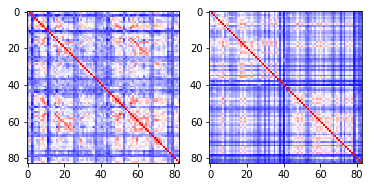

249 727553
250 495255
251 693764
252 521331


<Figure size 432x288 with 0 Axes>

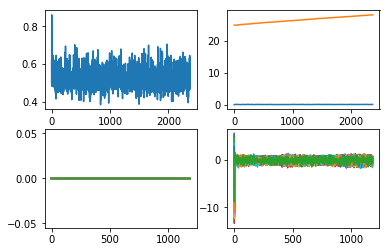

0.3409771789305489


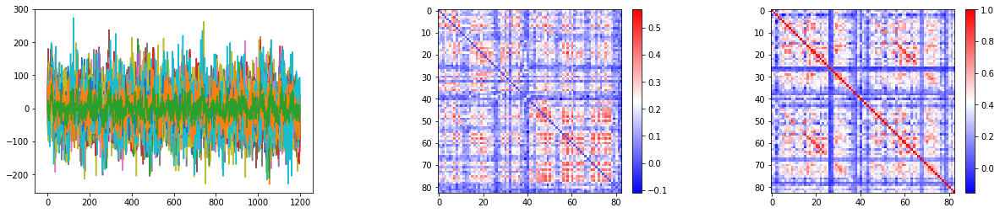

0.3009690550363833


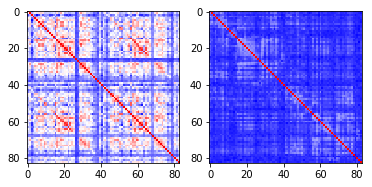

253 149337


<Figure size 432x288 with 0 Axes>

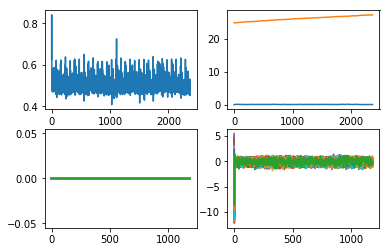

0.3708150696621236


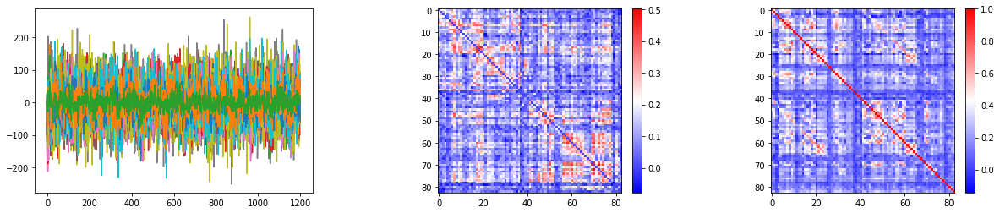

0.3919578607017002


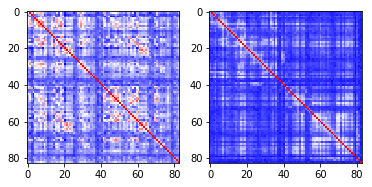

254 101107


<Figure size 432x288 with 0 Axes>

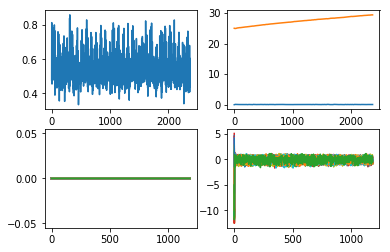

0.4215150558898415


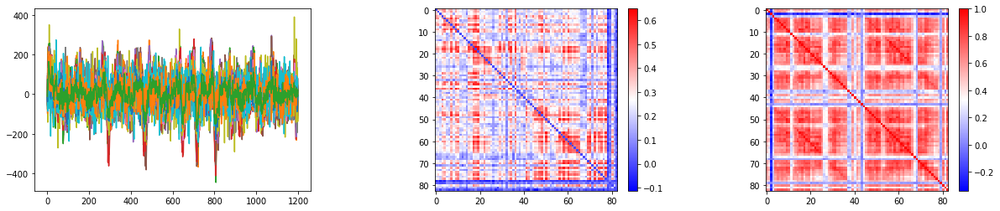

0.4167863133085259


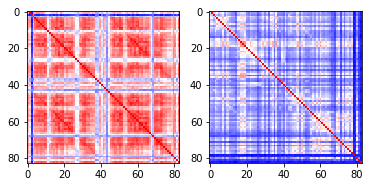

255 598568
256 177241


<Figure size 432x288 with 0 Axes>

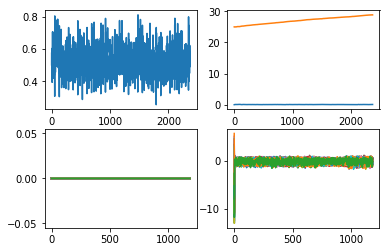

0.3993490926737488


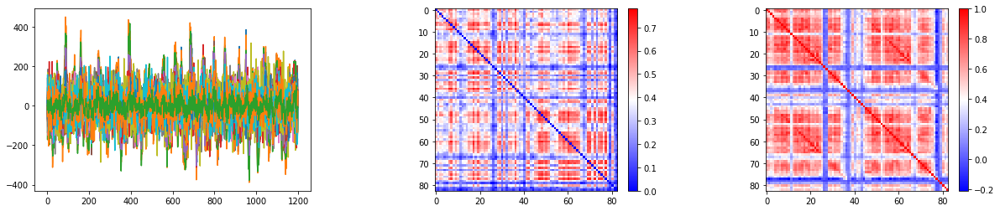

0.31050649438744693


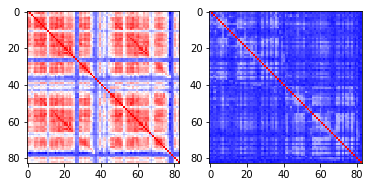

257 576255


<Figure size 432x288 with 0 Axes>

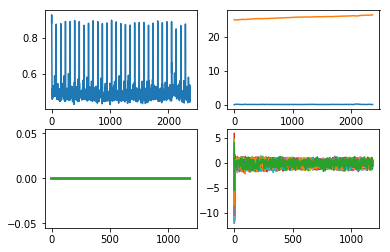

0.34132149646392757


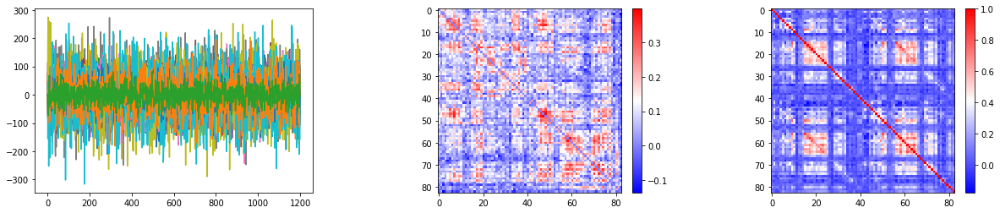

0.38241563583300187


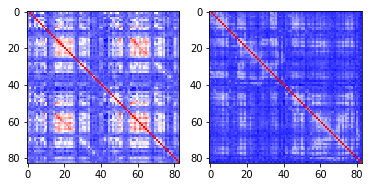

258 155231


<Figure size 432x288 with 0 Axes>

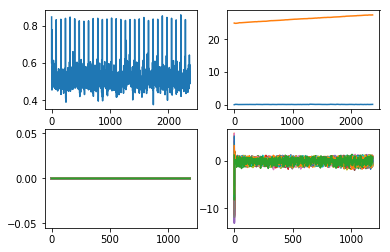

0.34763840542858393


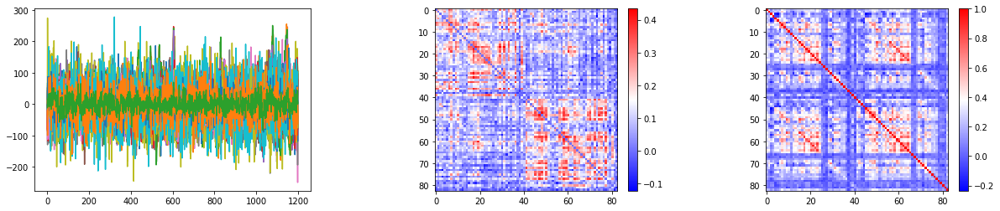

0.33458993051386915


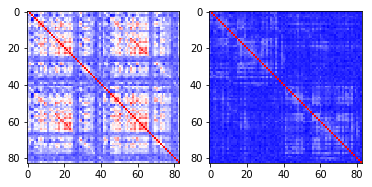

259 149539


<Figure size 432x288 with 0 Axes>

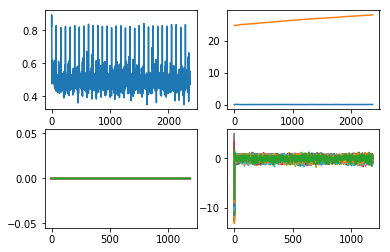

0.4949388114199675


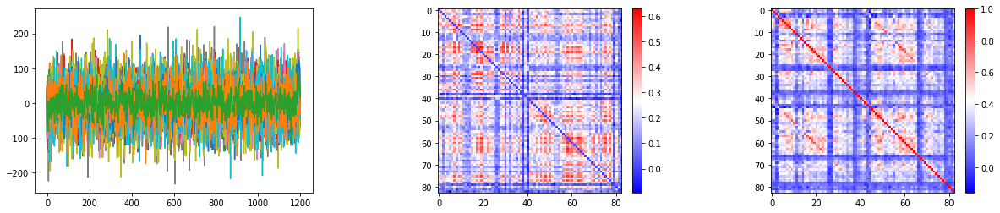

0.4648275258115436


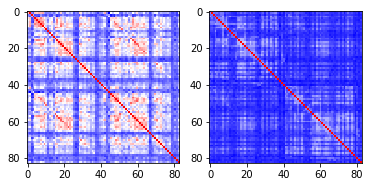

260 157942


<Figure size 432x288 with 0 Axes>

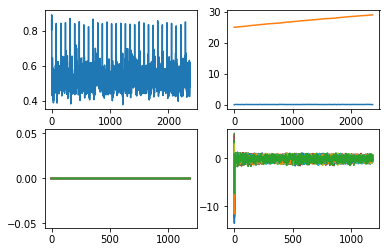

0.37926062684635903


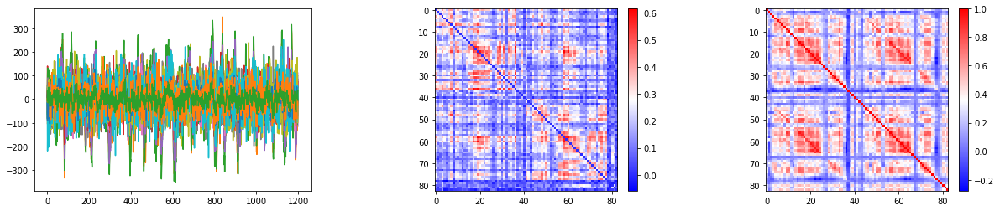

0.4134636729682654


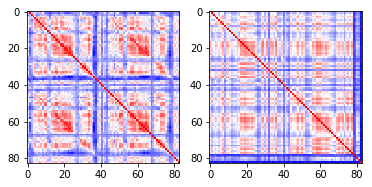

261 553344


<Figure size 432x288 with 0 Axes>

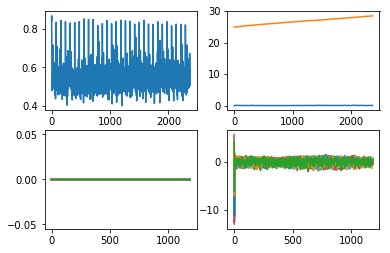

0.3466471538481729


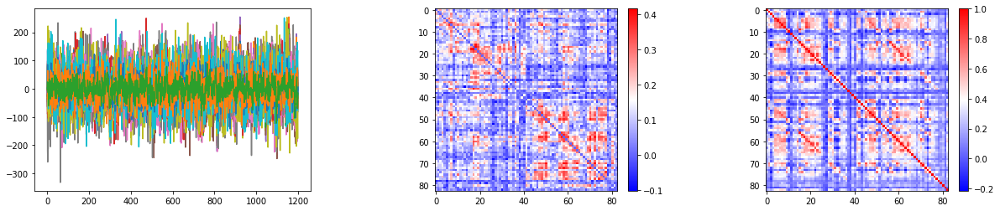

0.3999317805414801


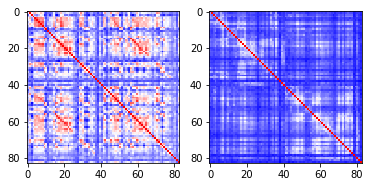

262 500222


<Figure size 432x288 with 0 Axes>

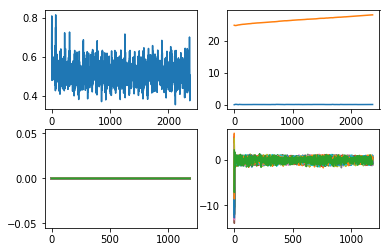

0.41558771772223013


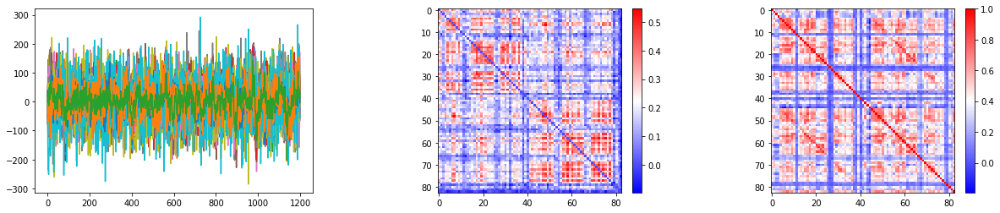

0.45800709771980624


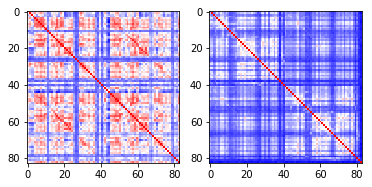

263 100610


<Figure size 432x288 with 0 Axes>

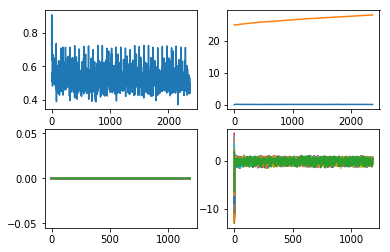

0.3811216401638902


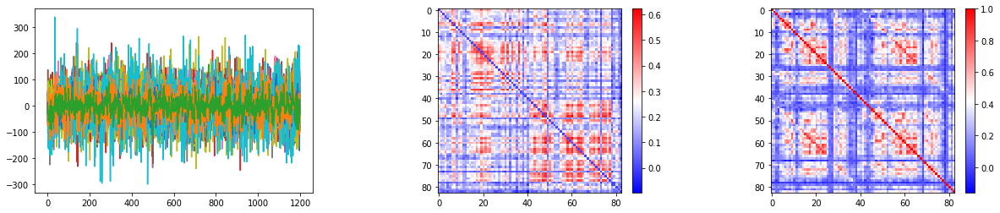

0.4067320940842442


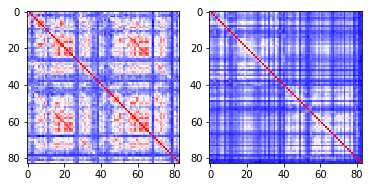

264 346137
265 196346
266 449753
267 812746
268 536647


<Figure size 432x288 with 0 Axes>

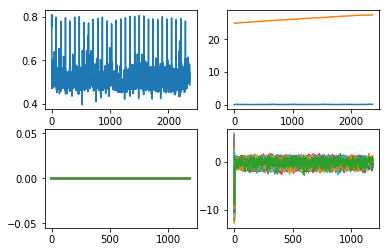

0.2127586236598653


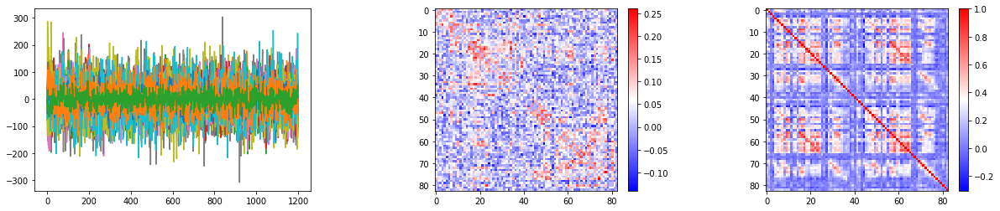

0.3027701940784385


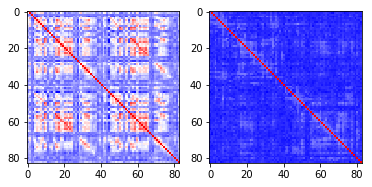

269 525541


<Figure size 432x288 with 0 Axes>

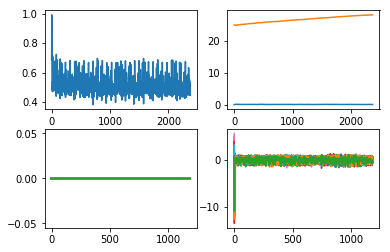

0.349439898773774


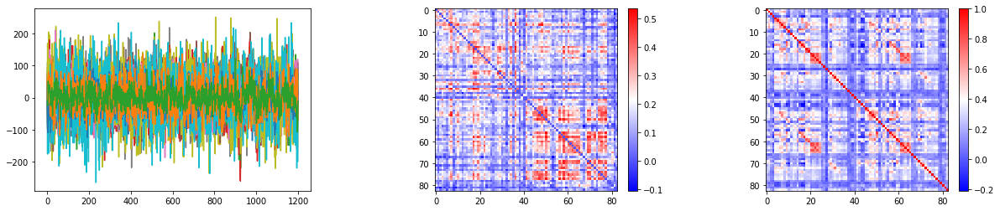

0.38452837128825146


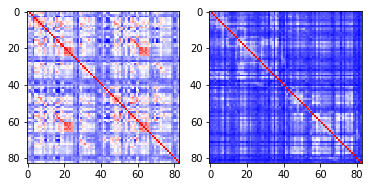

270 180129


<Figure size 432x288 with 0 Axes>

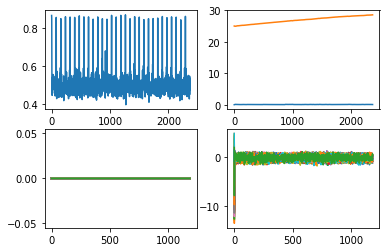

0.43015253907150797


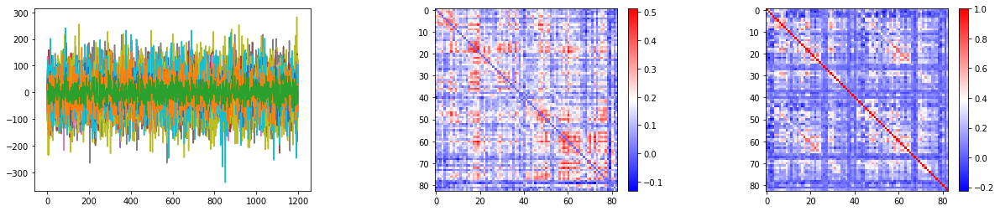

0.4593345650844416


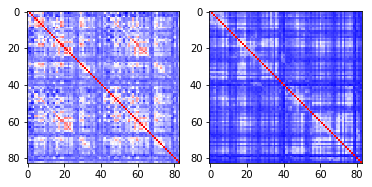

271 303119


<Figure size 432x288 with 0 Axes>

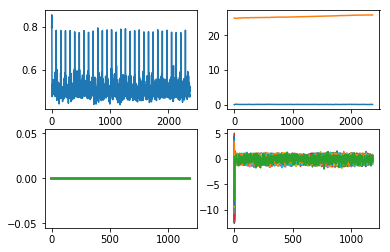

0.3197069439188467


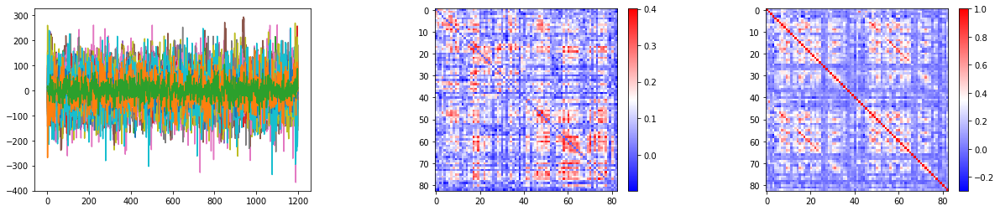

0.3514620186845658


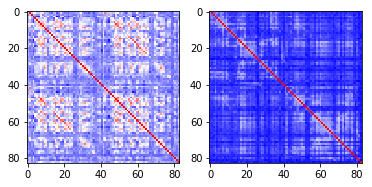

272 307127
273 308129


<Figure size 432x288 with 0 Axes>

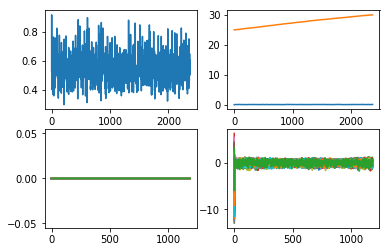

0.47050093999144843


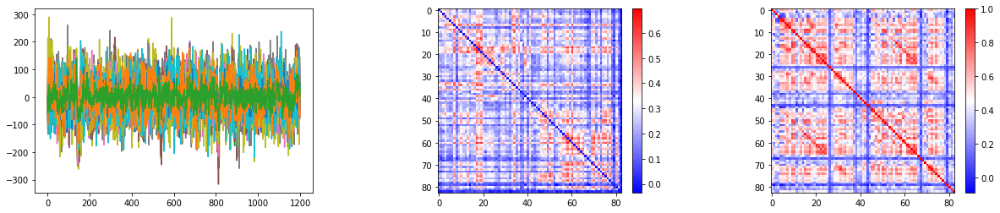

0.37870120453288697


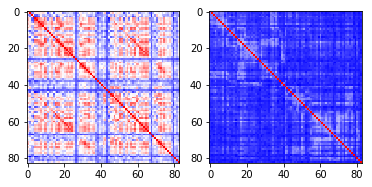

274 283543
275 172938


<Figure size 432x288 with 0 Axes>

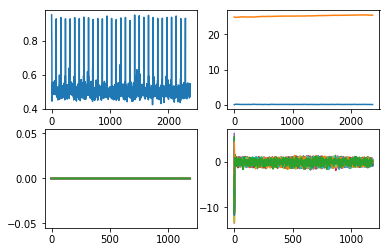

0.23364127762633272


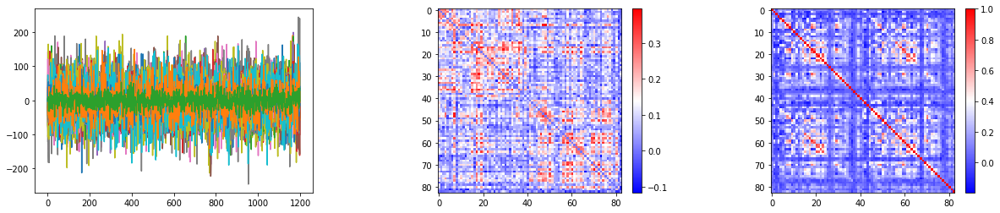

0.2886497644424538


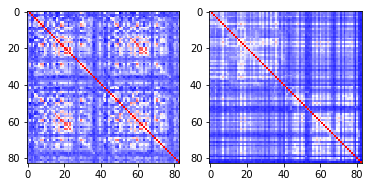

276 256540


<Figure size 432x288 with 0 Axes>

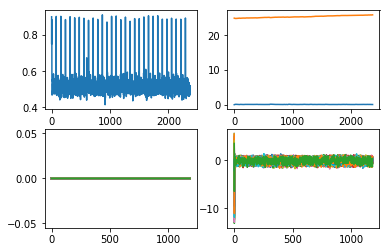

0.33764851173252874


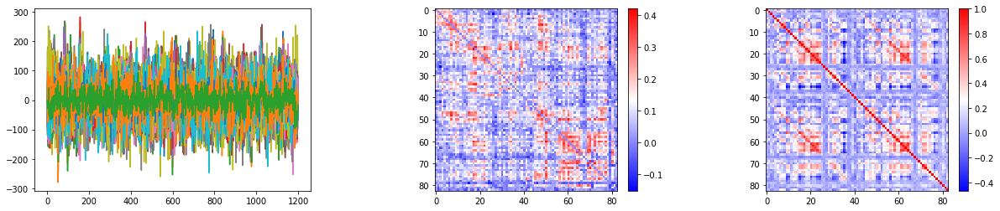

0.3737542763388917


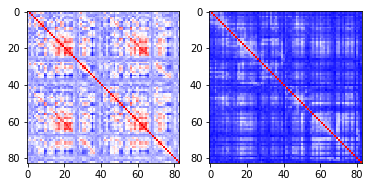

277 531536


<Figure size 432x288 with 0 Axes>

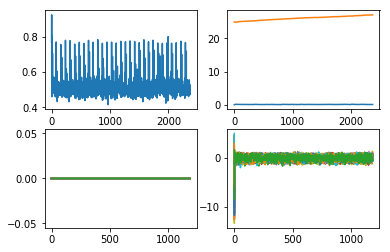

0.40097321392239976


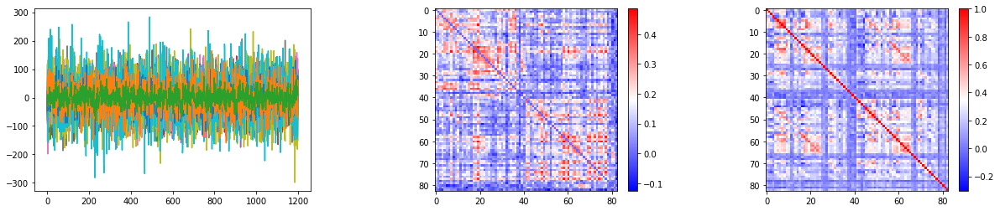

0.45787177804463725


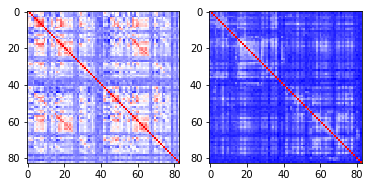

278 101410


<Figure size 432x288 with 0 Axes>

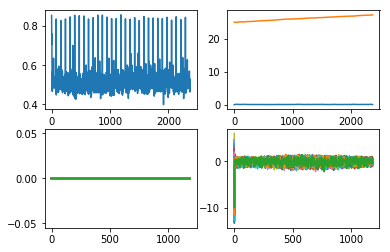

0.3346439174822659


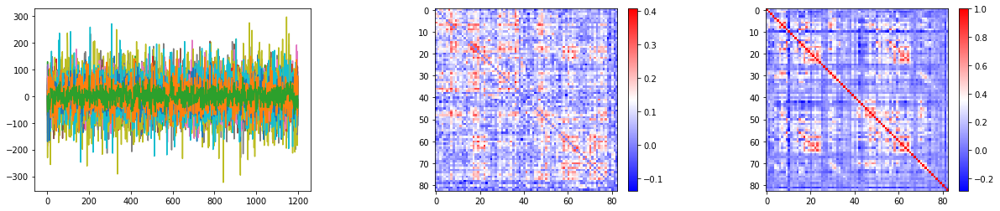

0.3705527513572703


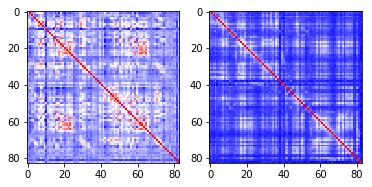

279 568963


<Figure size 432x288 with 0 Axes>

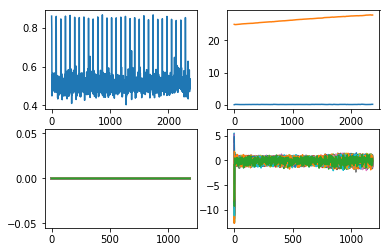

0.3517668968436233


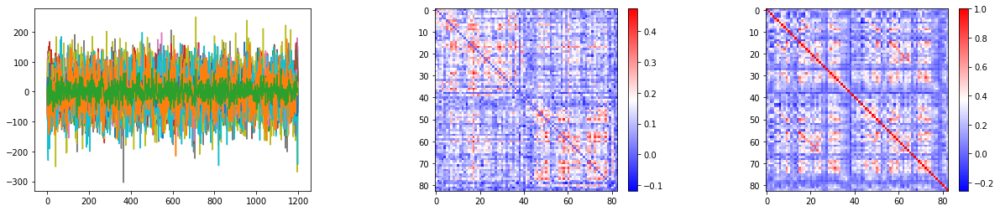

0.27179732847801685


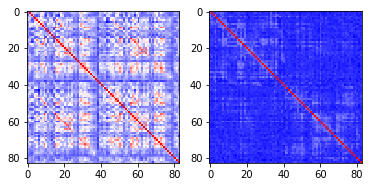

280 149236


<Figure size 432x288 with 0 Axes>

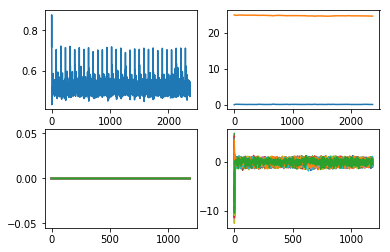

0.3017083830578088


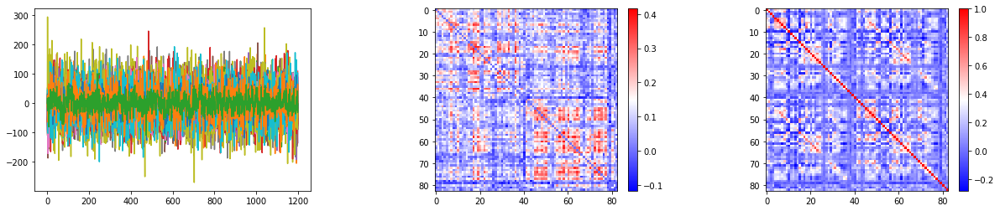

0.31939603242877806


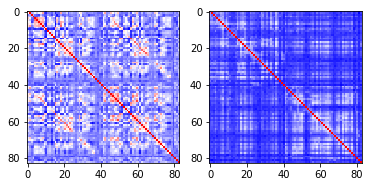

281 156334
282 172130


<Figure size 432x288 with 0 Axes>

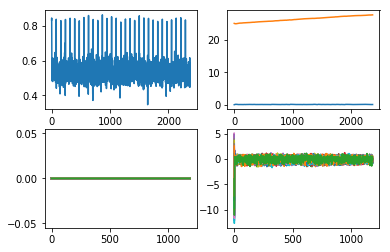

0.33378049950035105


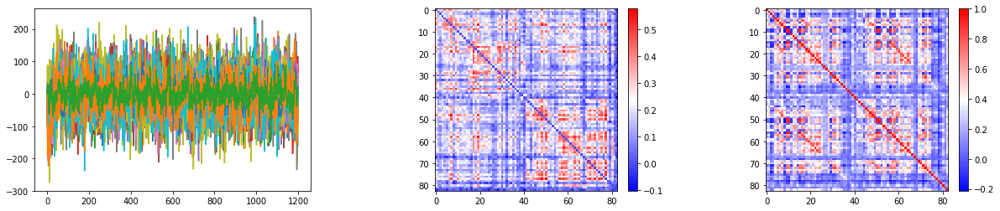

0.32873432224978716


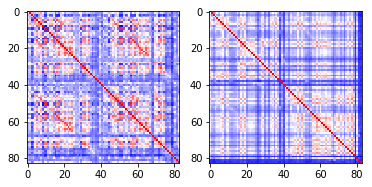

283 557857


<Figure size 432x288 with 0 Axes>

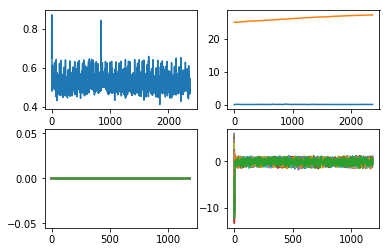

0.34795177404266797


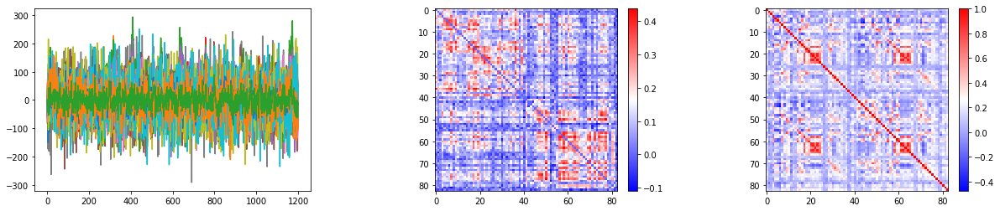

0.351246236230126


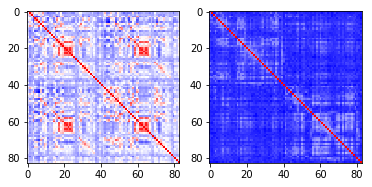

284 715647
285 300618


<Figure size 432x288 with 0 Axes>

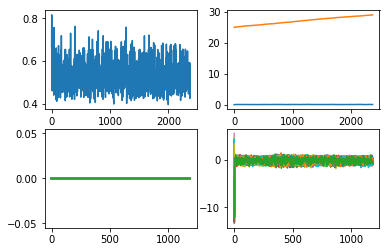

0.4459573452482507


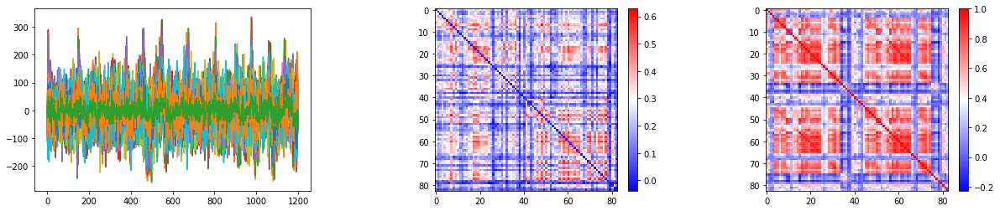

0.4508007584725638


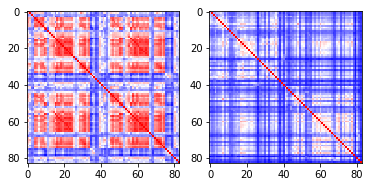

286 153833


<Figure size 432x288 with 0 Axes>

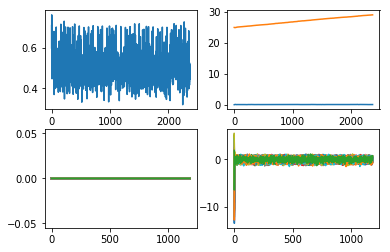

0.48838812747663846


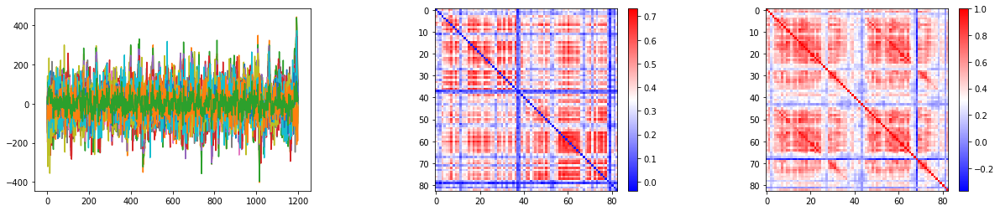

0.4869965483488742


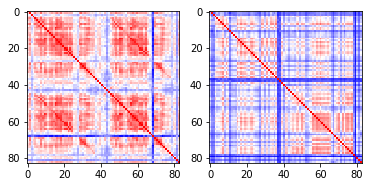

287 951457
288 180432


<Figure size 432x288 with 0 Axes>

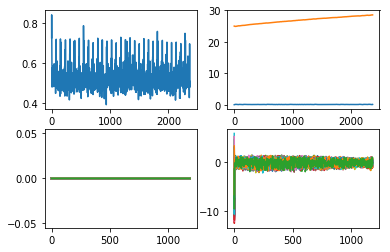

0.4003473479315476


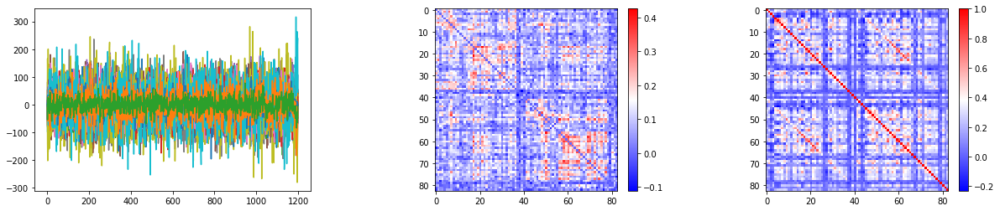

0.49214877954152586


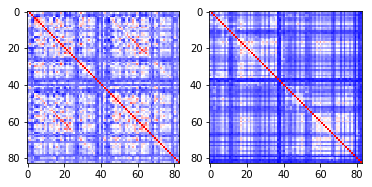

289 176542


<Figure size 432x288 with 0 Axes>

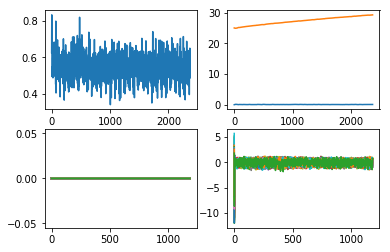

0.42656054901711443


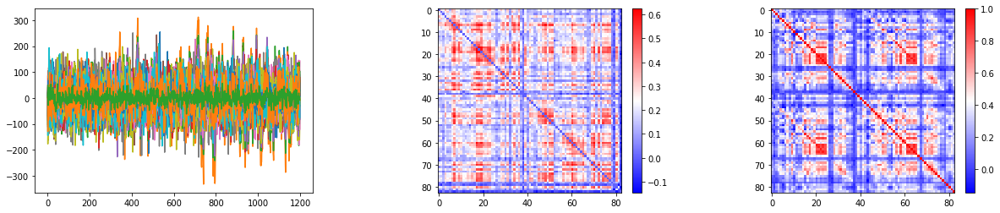

0.49155104138475597


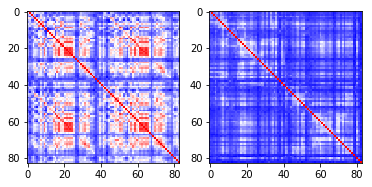

290 473952


<Figure size 432x288 with 0 Axes>

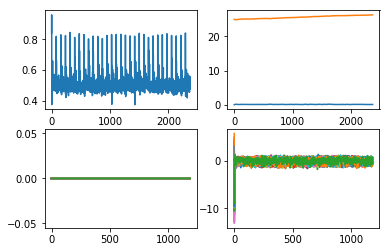

0.42612167690176256


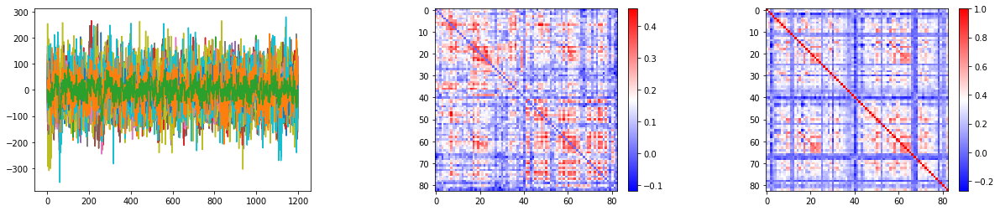

0.4693742782415573


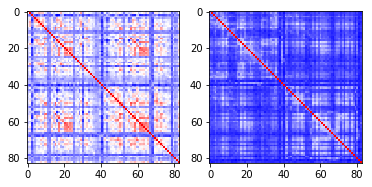

291 380036
292 101915


<Figure size 432x288 with 0 Axes>

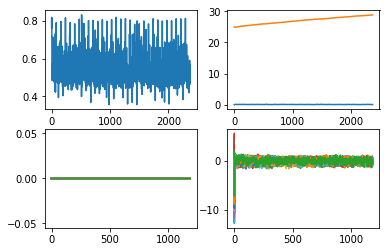

0.45293764569719414


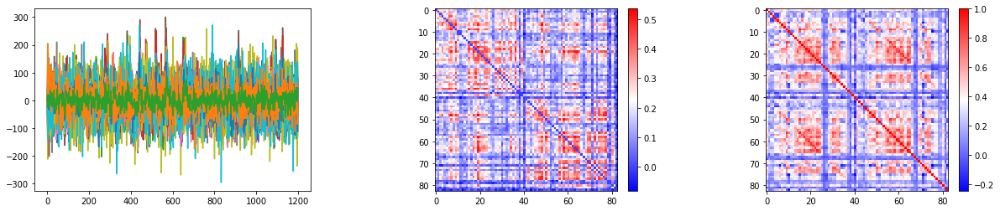

0.49087194480254415


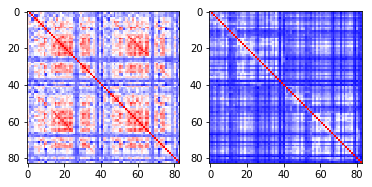

293 499566


<Figure size 432x288 with 0 Axes>

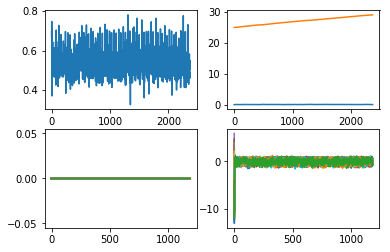

0.38180439637781827


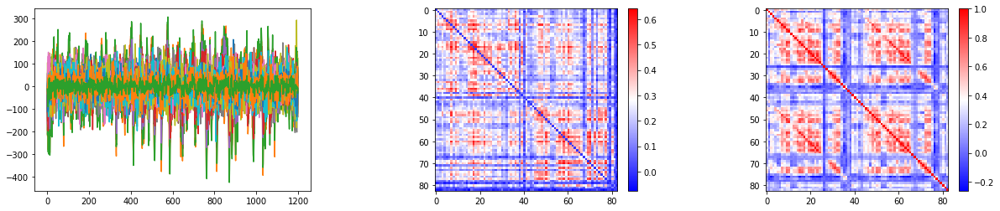

0.37990893061480197


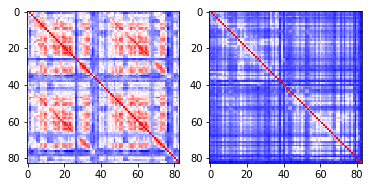

294 573451


<Figure size 432x288 with 0 Axes>

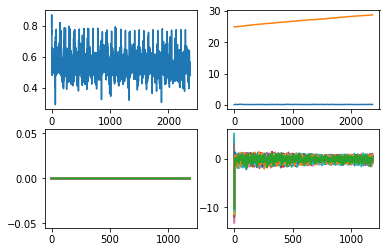

0.4170884365772415


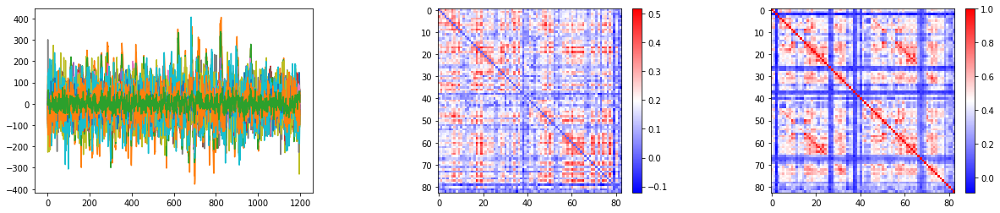

0.4728221199740938


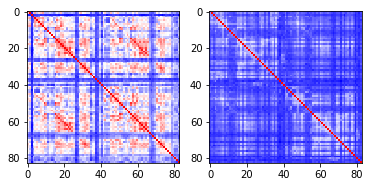

295 159138


<Figure size 432x288 with 0 Axes>

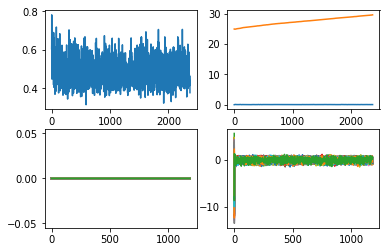

0.4980802378853735


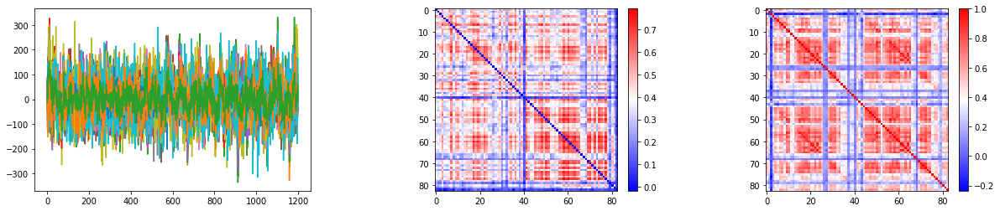

0.5299401884619588


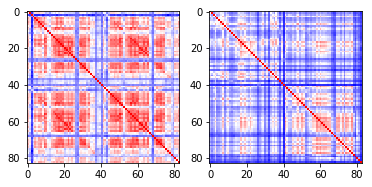

296 571548


<Figure size 432x288 with 0 Axes>

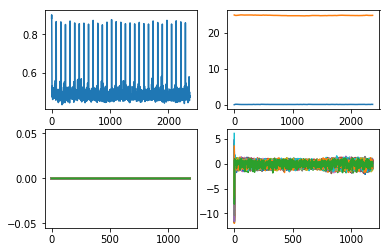

0.3212243778520299


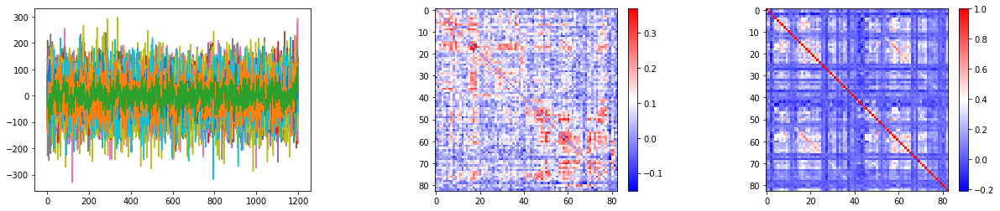

0.31025966529858207


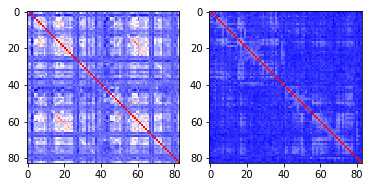

297 298455


<Figure size 432x288 with 0 Axes>

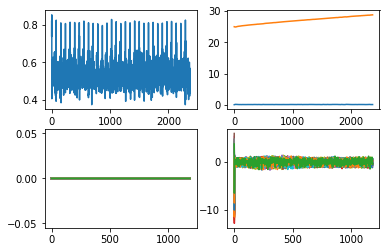

0.3613835006896056


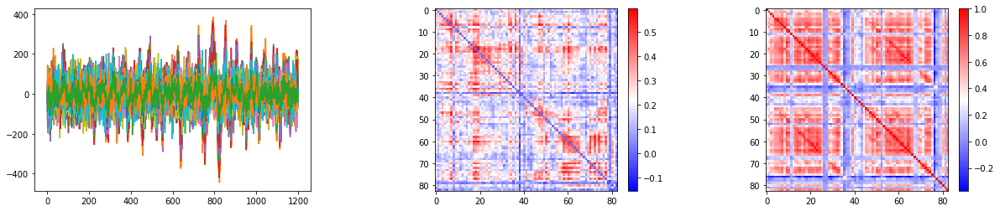

0.3808879980875961


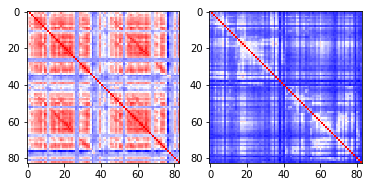

298 517239


<Figure size 432x288 with 0 Axes>

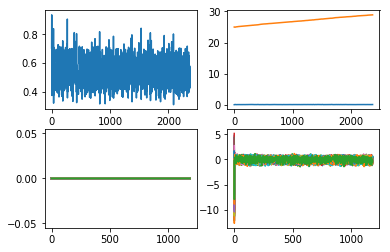

0.39448988170833954


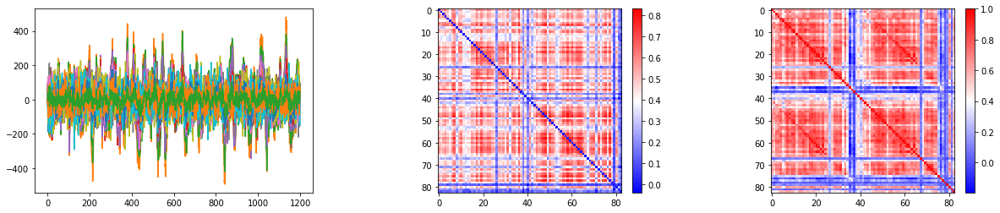

0.3745755255471583


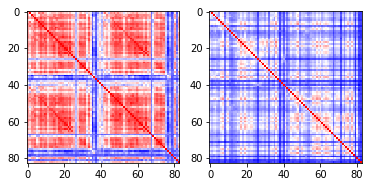

299 100408


<Figure size 432x288 with 0 Axes>

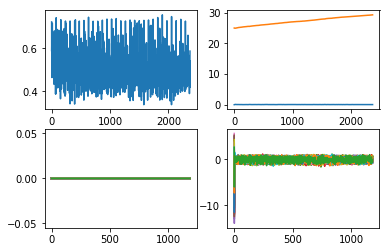

0.4406596324730838


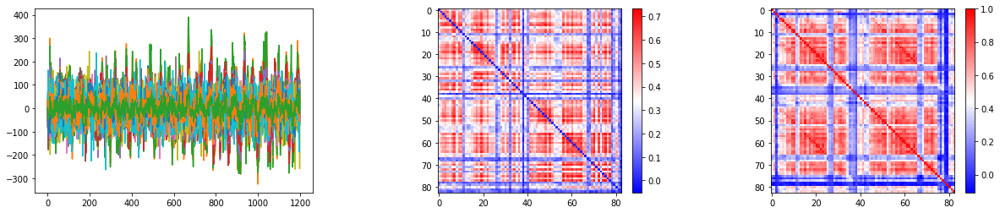

0.4674598107513282


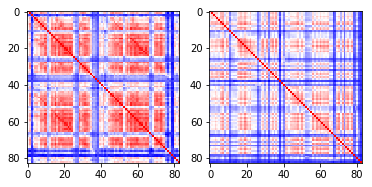

300 565452


<Figure size 432x288 with 0 Axes>

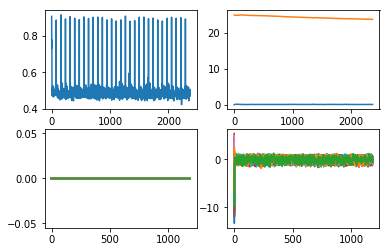

0.36882212204172804


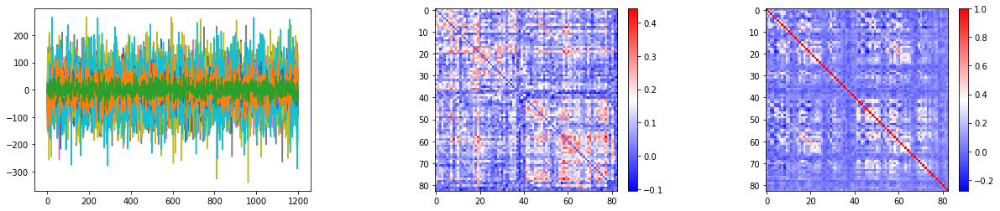

0.4295476910508716


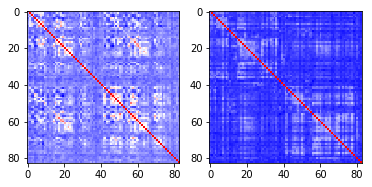

301 173132


<Figure size 432x288 with 0 Axes>

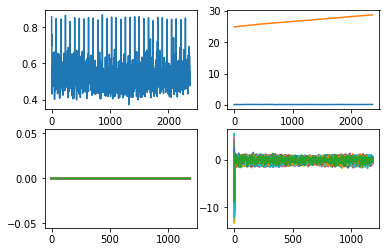

0.3649162305291284


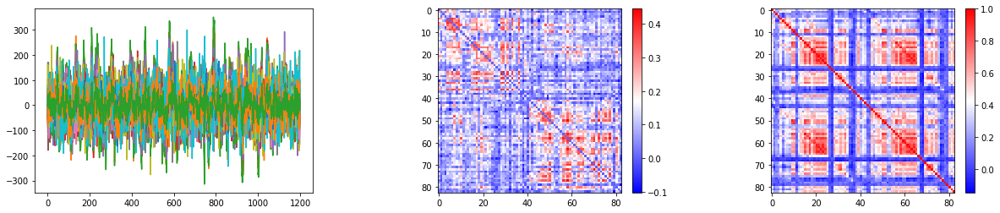

0.3347799003972228


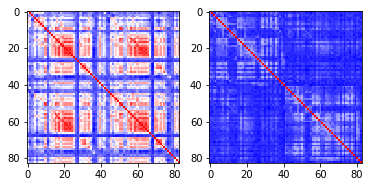

302 182840


<Figure size 432x288 with 0 Axes>

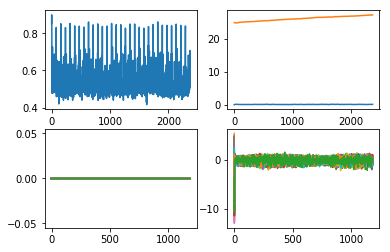

0.3455326902626558


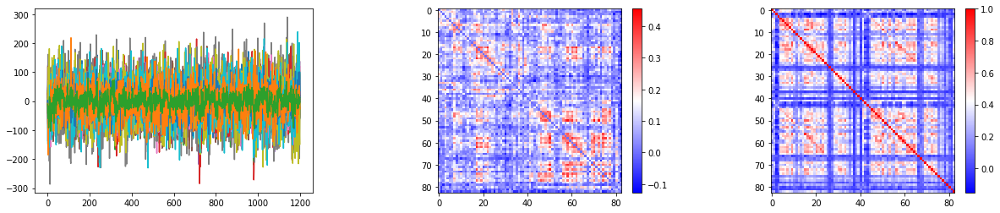

0.3248984496467382


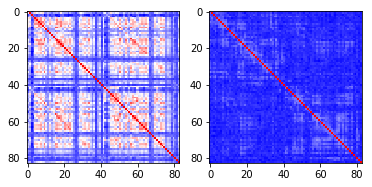

303 181232


<Figure size 432x288 with 0 Axes>

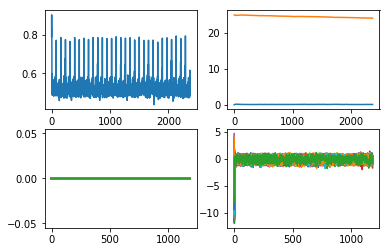

0.27848985312859587


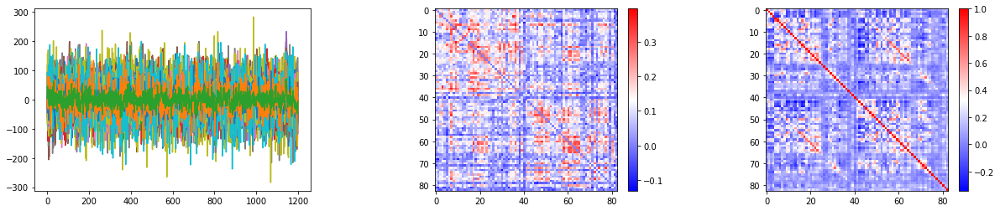

0.33793101034805606


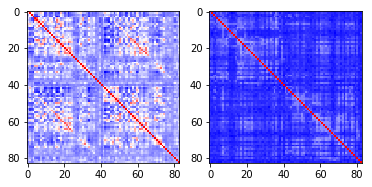

304 445543


<Figure size 432x288 with 0 Axes>

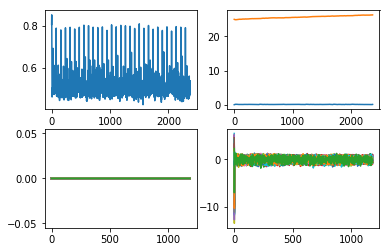

0.4140274782986244


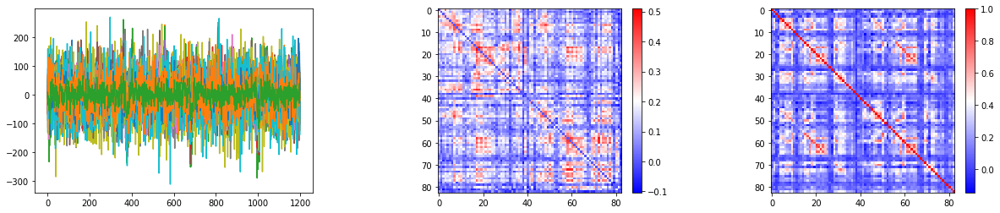

0.4459095295771798


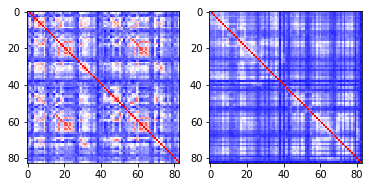

305 206222
306 270332


<Figure size 432x288 with 0 Axes>

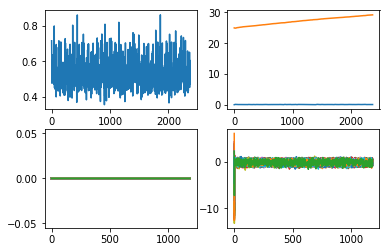

0.48262951145041233


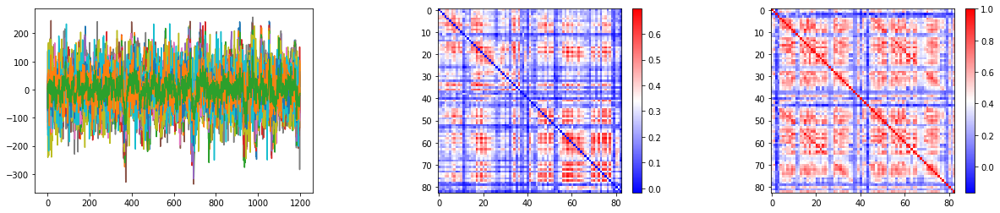

0.5130559378645592


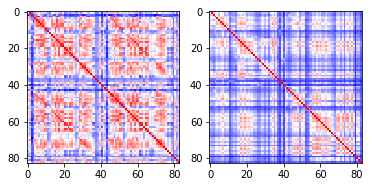

307 185139
308 520228


<Figure size 432x288 with 0 Axes>

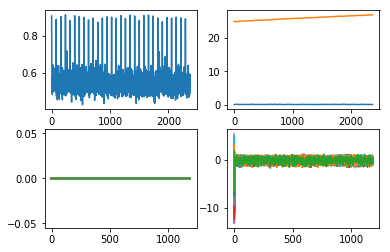

0.23334451152876848


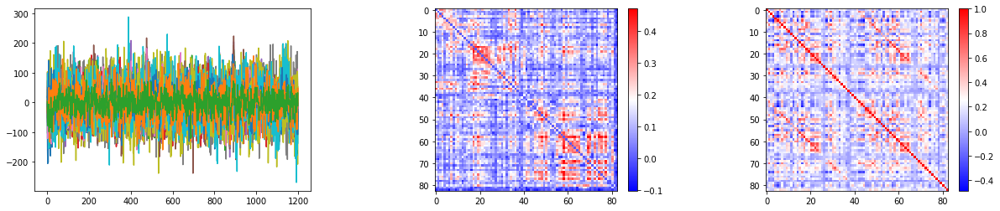

0.2544230368471324


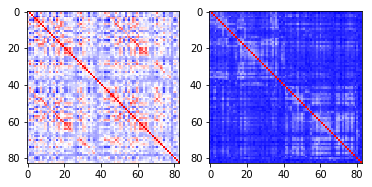

309 453441


<Figure size 432x288 with 0 Axes>

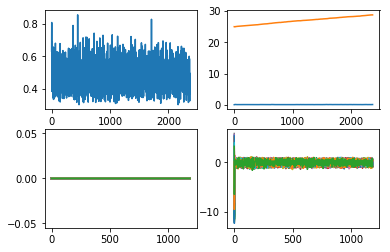

0.4983418069879556


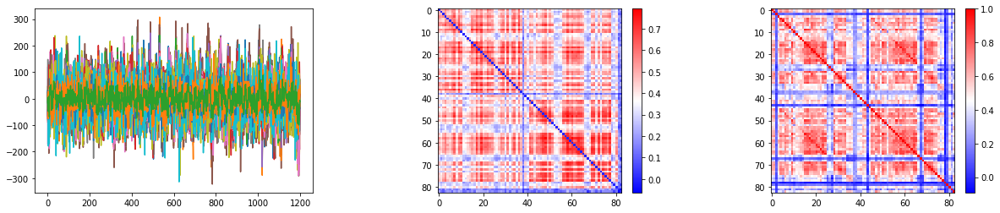

0.5191197627524599


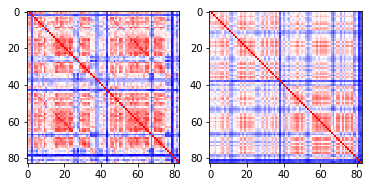

310 766563
311 101006


<Figure size 432x288 with 0 Axes>

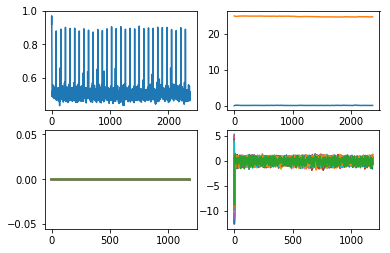

0.29485786124715935


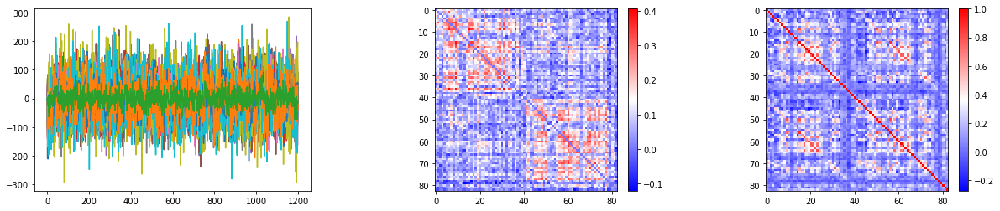

0.35214291192596936


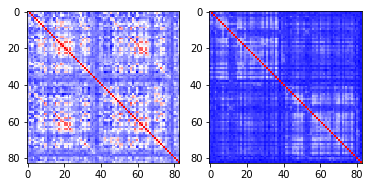

312 148840


<Figure size 432x288 with 0 Axes>

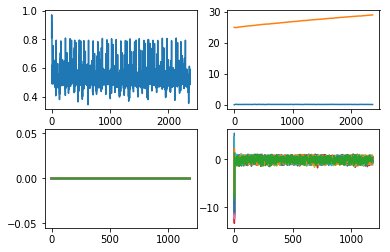

0.38829340098321996


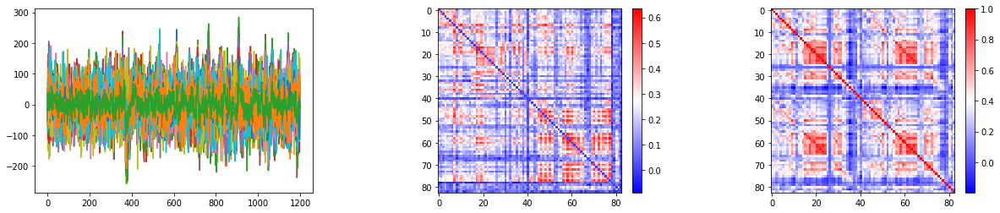

0.4173988792038727


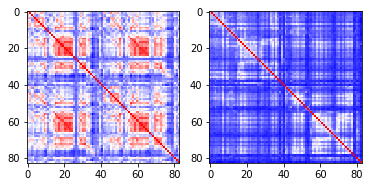

313 102311


<Figure size 432x288 with 0 Axes>

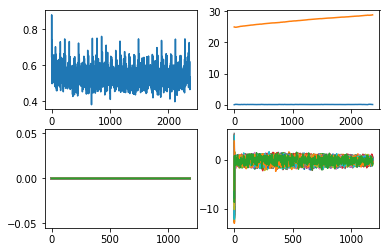

0.24101545670533914


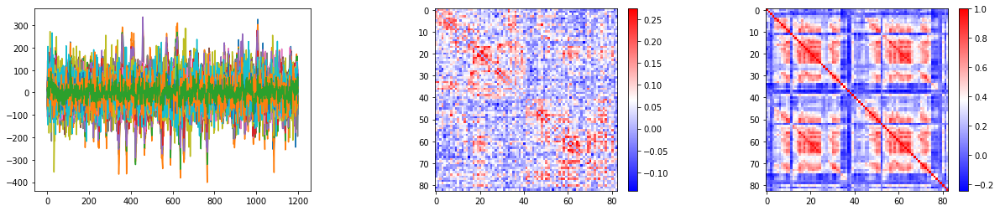

0.35947333237461493


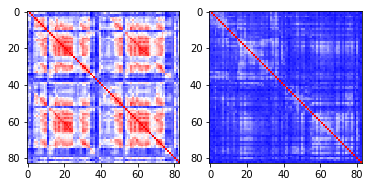

314 199150


<Figure size 432x288 with 0 Axes>

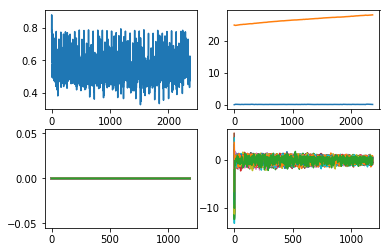

0.3298200744150762


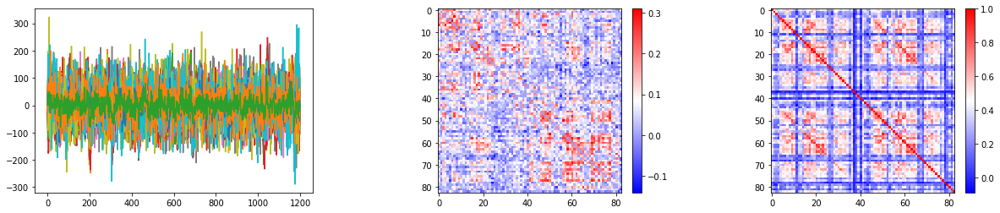

0.503386088981781


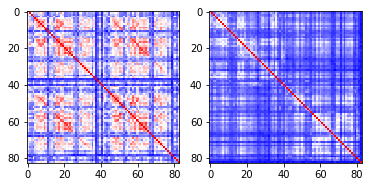

315 101309
316 561242


<Figure size 432x288 with 0 Axes>

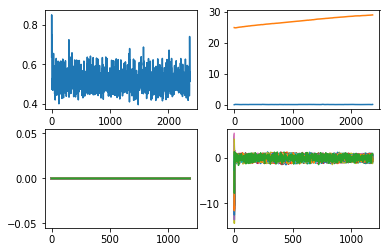

0.32914109862575364


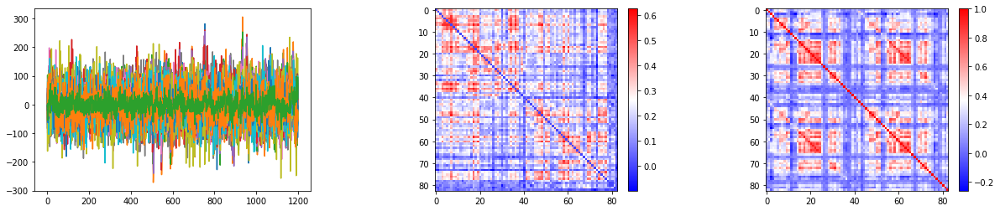

0.3896881208298794


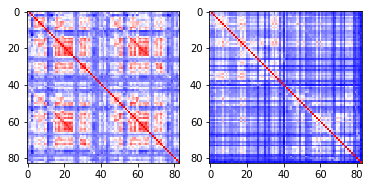

317 309636


<Figure size 432x288 with 0 Axes>

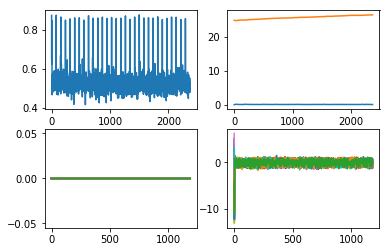

0.32492637607690067


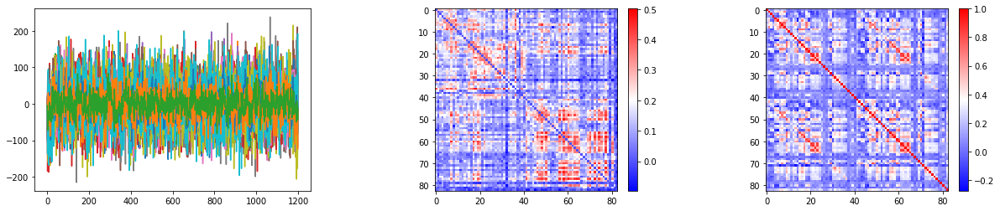

0.364978491696233


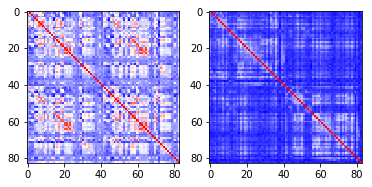

In [19]:
batch_size = 83
HCP_par_corr= {}
ROI_size = 83
#groups= ['CON_MCI']

subs=[sub for sub in os.listdir(SC_base_dir) if os.path.isdir(SC_base_dir+sub)]
#subs = ['1']
for i in range(len(subs)):
    sub =subs[i]
    print(i, sub)
    SC_file = SC_base_dir+ sub +'/dsi_sd4/sub-' +sub +'_roisc33dwispace/weights.txt'
    TS_file = TS_base_dir+sub+ '_rfMRI_REST1_LR_hpc200_clean__l2k8_sc33_ts.pkl'
#groups= ['CON_MCI']



    
    if os.path.isfile(SC_file) and os.path.isfile(TS_file):
        HCP_par_corr[sub] = []
        SC= np.loadtxt(SC_file)
        TS_df=pd.read_pickle(TS_file)
        TS=TS_df.values
        TS_dmean =(TS.T -TS.T.mean(axis= 0)).T
        SC = (SC+SC.T)*0.5
        """SC1=SC[:48,:48].copy()
        SC2=SC[48:96,48:96].copy()
        SC3=SC[:48,48:96].copy()
        mask1 = (SC1-SC1.mean(axis=1)< 2.*SC1.std(axis=1)) 
        SC1[mask1]=0
        SC2[(SC2-SC2.mean(axis=1) <  2*SC2.std(axis=1)) ]=0
        SC3[(SC3-SC3.mean(axis=1)<  2*SC3.std(axis=1)) ]=0
        SC[:48,:48] = SC1
        SC[48:96,48:96] = SC2
        SC[:48,48:96] = 1*SC3
        SC[48:96,:48] = 1*SC3.T"""
        Wo = np.log1p(SC)/np.linalg.norm(np.log1p(SC))
        #L_s = (-np.diag(np.sum(W0, axis= 1)) + W0).astype(np.float32)
            
            
        num_data = TS.shape[0]

        total_series_length = num_data -echo_step #50000


        num_batches = total_series_length//truncated_backprop_length
            
        model_run(sub,Wo, TS)
    
        X0 = np.ones((6*batch_size,))/10.
        params = np.loadtxt(out_dir+'HCP_'+sub+'paramsList_osc.txt')
        Theta = params[-10:,:].mean(axis = 0)

        tys=[]
        ROI_size= batch_size
        for j in range(4000):
            X = f_diffusion_tr_noise(X0,Wo, Theta)
        
            X0 = X
    
            tys.append(h_diffusion_noise(X0, Theta))
        
        tys=np.array(tys)
        #tys_dmean =(tys.T -tys.T.mean(axis= 0)).T
        FC_sim = np.corrcoef(tys[20:,:].T)
        FC=np.corrcoef(TS.T)
        np.savetxt(out_dir+'HCP_'+sub+'sim_bold_osc.txt', np.array(tys))
        print(np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1])
        HCP_par_corr[sub].append(np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1])
            
    
        HCP_par_corr[sub].append(.001+ smooth_normalize(Theta[0:1])[0])
        HCP_par_corr[sub].append(.001+ smooth_normalize(Theta[1:2])[0])
        """HCP_par_corr[sub].append(.001+ smooth_normalize(Theta[2:3])[0])
        HCP_par_corr[sub].append(.1+ smooth_normalize(Theta[3:4])[0])
        HCP_par_corr[sub].append(5000./0.459/0.641+1000.*np.tanh(Theta[4:5])[0])"""
        """W_n_a = np.reshape(Theta[5:], [batch_size,batch_size])
        W_n_a = 1+ np.tanh((W_n_a+W_n_a.T)/2.0)
        W_n_a = W_n_a * Wo
    
        Ws_a = W_n_a/np.linalg.norm(W_n_a)
        HCP_par_corr[sub].extend(list(Ws_a.ravel()))"""
        
            
        fig, ax = plt.subplots(1,2)
        ax[0].imshow(FC, cmap='bwr')
        ax[1].imshow(FC_sim, cmap='bwr')
        plt.show()


 

    


In [20]:
HCP_par_corr_new={}
for sub in HCP_par_corr:
    HCP_par_corr_new['sub'+sub] = HCP_par_corr[sub]

In [21]:
scipy.io.savemat(out_dir+'HCP_par_corr_osc.mat', HCP_par_corr_new)
np.save(out_dir+'HCP_par_corr_osc.npy', HCP_par_corr_new)

In [30]:
Theta

array([ 0.14527598, 19.78456268])

3 154532
0.31126096681503795


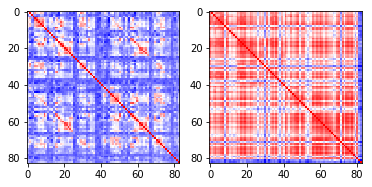

In [12]:
sub =subs[2]
print(i, sub)
SC_file = SC_base_dir+ sub +'/dsi_sd4/sub-' +sub +'_roisc33dwispace/weights.txt'
TS_file = TS_base_dir+sub+ '_rfMRI_REST1_LR_hpc200_clean__l2k8_sc33_ts.pkl'
#groups= ['CON_MCI']



    
SC= np.loadtxt(SC_file)
TS_df=pd.read_pickle(TS_file)
TS=TS_df.values
SC = (SC+SC.T)*0.5
X0 = np.ones((6*batch_size,))/10.
params = np.loadtxt(out_dir+'HCP_'+sub+'paramsList.txt')
Theta = params[-10:,:].mean(axis = 0)

tys=[]
ROI_size= batch_size
for j in range(4000):
    X = f_diffusion_tr_noise(X0,Wo, Theta)
        
    X0 = X
    
    tys.append(h_diffusion_noise(X0, Theta))
        
tys=np.array(tys)
        #tys_dmean =(tys.T -tys.T.mean(axis= 0)).T
FC_sim = np.corrcoef(tys[20:,:].T)
FC=np.corrcoef(TS.T)
np.savetxt(out_dir+'HCP_'+sub+'sim_bold.txt', np.array(tys))
print(np.corrcoef(FC[np.tril_indices(batch_size,-1)], FC_sim[np.tril_indices(batch_size,-1)])[0,1])
        
            
fig, ax = plt.subplots(1,2)
ax[0].imshow(FC, cmap='bwr')
ax[1].imshow(FC_sim, cmap='bwr')
plt.show()